# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: no se puede crear el directorio «data»: El archivo ya existe


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

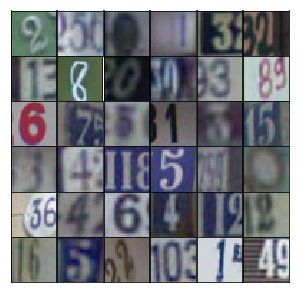

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Instructions for updating:
Use keras.layers.dense instead.
Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use keras.layers.batch_normalization instead.
Instructions for updating:
Use keras.layers.conv2d_transpose instead.
Instructions for updating:
Use keras.layers.conv2d instead.


Epoch 1/25... Discriminator Loss: 1.4701... Generator Loss: 0.5286
Epoch 1/25... Discriminator Loss: 0.6089... Generator Loss: 1.1503
Epoch 1/25... Discriminator Loss: 0.1259... Generator Loss: 2.6923
Epoch 1/25... Discriminator Loss: 0.1565... Generator Loss: 2.5105
Epoch 1/25... Discriminator Loss: 0.1350... Generator Loss: 2.8141
Epoch 1/25... Discriminator Loss: 0.0700... Generator Loss: 3.1403
Epoch 1/25... Discriminator Loss: 0.0993... Generator Loss: 2.9339
Epoch 1/25... Discriminator Loss: 0.1537... Generator Loss: 2.7641
Epoch 1/25... Discriminator Loss: 0.0654... Generator Loss: 3.5955
Epoch 1/25... Discriminator Loss: 0.0902... Generator Loss: 3.3397


/home/nitsuga/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


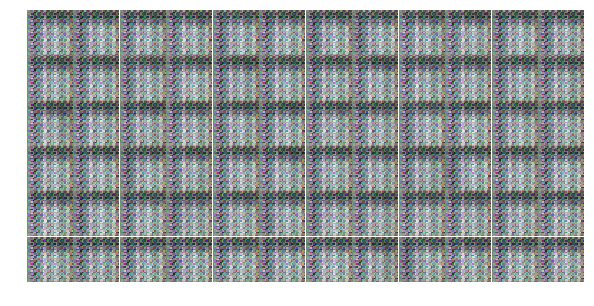

Epoch 1/25... Discriminator Loss: 0.0730... Generator Loss: 3.9490
Epoch 1/25... Discriminator Loss: 0.3226... Generator Loss: 2.6876
Epoch 1/25... Discriminator Loss: 2.9402... Generator Loss: 3.9300
Epoch 1/25... Discriminator Loss: 0.6874... Generator Loss: 1.6518
Epoch 1/25... Discriminator Loss: 0.5852... Generator Loss: 1.7121
Epoch 1/25... Discriminator Loss: 0.7528... Generator Loss: 4.0073
Epoch 1/25... Discriminator Loss: 0.2887... Generator Loss: 1.8333
Epoch 1/25... Discriminator Loss: 0.2939... Generator Loss: 2.3131
Epoch 1/25... Discriminator Loss: 1.3011... Generator Loss: 5.5496
Epoch 1/25... Discriminator Loss: 0.8784... Generator Loss: 1.0020


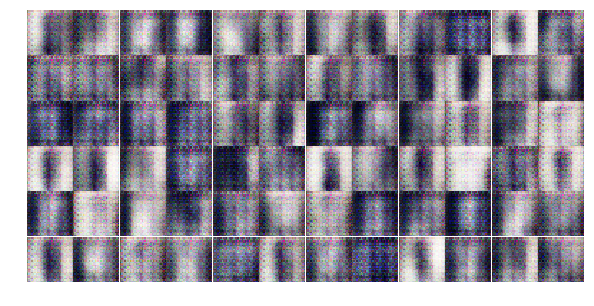

Epoch 1/25... Discriminator Loss: 0.1946... Generator Loss: 3.3479
Epoch 1/25... Discriminator Loss: 1.0111... Generator Loss: 0.6948
Epoch 1/25... Discriminator Loss: 0.4832... Generator Loss: 1.6636
Epoch 1/25... Discriminator Loss: 0.4695... Generator Loss: 1.4380
Epoch 1/25... Discriminator Loss: 0.2829... Generator Loss: 1.8947
Epoch 1/25... Discriminator Loss: 0.9352... Generator Loss: 7.0132
Epoch 1/25... Discriminator Loss: 1.1075... Generator Loss: 0.7701
Epoch 1/25... Discriminator Loss: 0.4744... Generator Loss: 1.5522
Epoch 1/25... Discriminator Loss: 1.1762... Generator Loss: 1.1026
Epoch 1/25... Discriminator Loss: 0.7117... Generator Loss: 2.2275


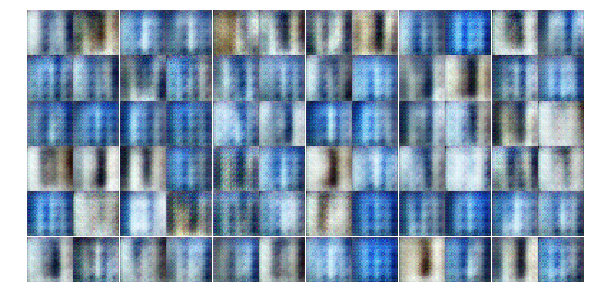

Epoch 1/25... Discriminator Loss: 1.2842... Generator Loss: 0.5635
Epoch 1/25... Discriminator Loss: 0.8056... Generator Loss: 1.0548
Epoch 1/25... Discriminator Loss: 1.6648... Generator Loss: 0.3555
Epoch 1/25... Discriminator Loss: 0.5771... Generator Loss: 1.6933
Epoch 1/25... Discriminator Loss: 0.5327... Generator Loss: 1.6936
Epoch 1/25... Discriminator Loss: 1.0739... Generator Loss: 1.2338
Epoch 1/25... Discriminator Loss: 0.8729... Generator Loss: 1.0347
Epoch 1/25... Discriminator Loss: 0.6252... Generator Loss: 1.6732
Epoch 1/25... Discriminator Loss: 0.5602... Generator Loss: 1.2856
Epoch 1/25... Discriminator Loss: 0.5187... Generator Loss: 1.5953


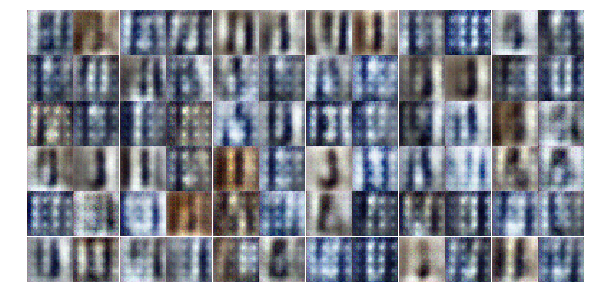

Epoch 1/25... Discriminator Loss: 0.5201... Generator Loss: 1.5361
Epoch 1/25... Discriminator Loss: 0.4162... Generator Loss: 1.9249
Epoch 1/25... Discriminator Loss: 0.6015... Generator Loss: 1.2315
Epoch 1/25... Discriminator Loss: 0.8827... Generator Loss: 5.6254
Epoch 1/25... Discriminator Loss: 0.4855... Generator Loss: 2.1535
Epoch 1/25... Discriminator Loss: 0.4912... Generator Loss: 1.4899
Epoch 1/25... Discriminator Loss: 0.7201... Generator Loss: 1.5889
Epoch 1/25... Discriminator Loss: 1.2350... Generator Loss: 0.7177
Epoch 1/25... Discriminator Loss: 0.7453... Generator Loss: 1.3864
Epoch 1/25... Discriminator Loss: 0.3510... Generator Loss: 1.9084


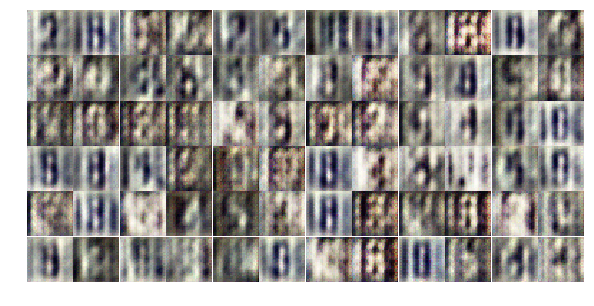

Epoch 1/25... Discriminator Loss: 0.6533... Generator Loss: 1.2147
Epoch 1/25... Discriminator Loss: 1.1597... Generator Loss: 0.8772
Epoch 1/25... Discriminator Loss: 0.6050... Generator Loss: 1.8597
Epoch 1/25... Discriminator Loss: 0.7439... Generator Loss: 1.2828
Epoch 1/25... Discriminator Loss: 0.5517... Generator Loss: 1.8303
Epoch 1/25... Discriminator Loss: 0.5474... Generator Loss: 1.4861
Epoch 1/25... Discriminator Loss: 0.5839... Generator Loss: 1.7512
Epoch 2/25... Discriminator Loss: 1.1172... Generator Loss: 2.2111
Epoch 2/25... Discriminator Loss: 0.6489... Generator Loss: 1.4048
Epoch 2/25... Discriminator Loss: 1.1511... Generator Loss: 0.9001


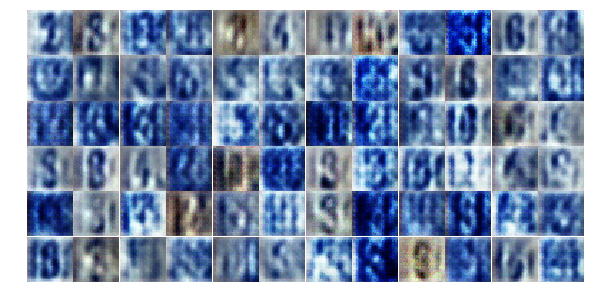

Epoch 2/25... Discriminator Loss: 0.7243... Generator Loss: 1.4107
Epoch 2/25... Discriminator Loss: 0.8387... Generator Loss: 1.0150
Epoch 2/25... Discriminator Loss: 1.0176... Generator Loss: 0.9902
Epoch 2/25... Discriminator Loss: 0.8860... Generator Loss: 1.3132
Epoch 2/25... Discriminator Loss: 0.8171... Generator Loss: 1.2055
Epoch 2/25... Discriminator Loss: 0.8194... Generator Loss: 1.1840
Epoch 2/25... Discriminator Loss: 1.0133... Generator Loss: 0.9167
Epoch 2/25... Discriminator Loss: 0.7695... Generator Loss: 1.0711
Epoch 2/25... Discriminator Loss: 0.8813... Generator Loss: 1.1292
Epoch 2/25... Discriminator Loss: 0.9455... Generator Loss: 1.3272


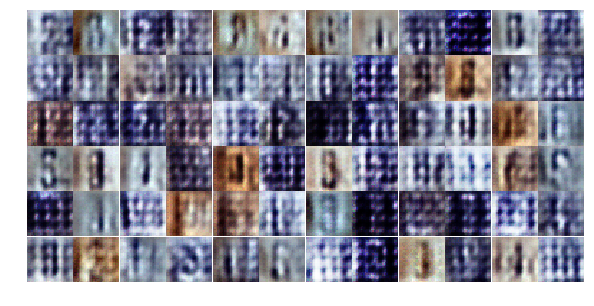

Epoch 2/25... Discriminator Loss: 0.7712... Generator Loss: 1.6417
Epoch 2/25... Discriminator Loss: 0.6192... Generator Loss: 1.4809
Epoch 2/25... Discriminator Loss: 0.7717... Generator Loss: 1.3354
Epoch 2/25... Discriminator Loss: 0.9214... Generator Loss: 1.2466
Epoch 2/25... Discriminator Loss: 0.8802... Generator Loss: 1.2349
Epoch 2/25... Discriminator Loss: 0.9716... Generator Loss: 1.3351
Epoch 2/25... Discriminator Loss: 0.7382... Generator Loss: 1.1957
Epoch 2/25... Discriminator Loss: 0.9230... Generator Loss: 1.0806
Epoch 2/25... Discriminator Loss: 0.6869... Generator Loss: 1.2925
Epoch 2/25... Discriminator Loss: 1.0960... Generator Loss: 0.6428


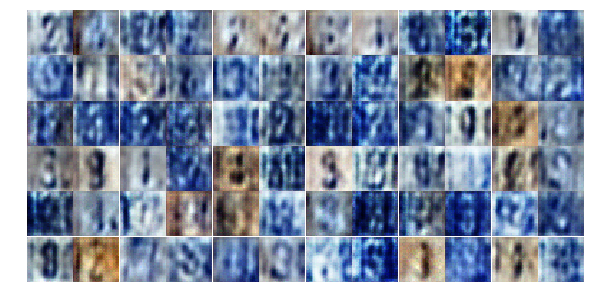

Epoch 2/25... Discriminator Loss: 0.9982... Generator Loss: 0.8931
Epoch 2/25... Discriminator Loss: 0.9165... Generator Loss: 1.3501
Epoch 2/25... Discriminator Loss: 0.8369... Generator Loss: 1.3701
Epoch 2/25... Discriminator Loss: 0.9904... Generator Loss: 1.1753
Epoch 2/25... Discriminator Loss: 1.0590... Generator Loss: 1.0700
Epoch 2/25... Discriminator Loss: 1.0355... Generator Loss: 1.1623
Epoch 2/25... Discriminator Loss: 0.9954... Generator Loss: 0.8949
Epoch 2/25... Discriminator Loss: 0.9640... Generator Loss: 0.8264
Epoch 2/25... Discriminator Loss: 1.3036... Generator Loss: 0.6587
Epoch 2/25... Discriminator Loss: 0.9319... Generator Loss: 1.3452


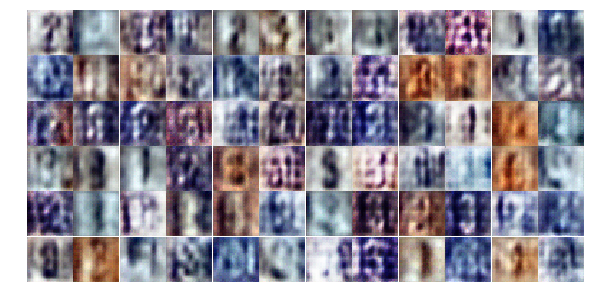

Epoch 2/25... Discriminator Loss: 1.2001... Generator Loss: 0.6965
Epoch 2/25... Discriminator Loss: 1.1355... Generator Loss: 1.1851
Epoch 2/25... Discriminator Loss: 1.4043... Generator Loss: 0.7091
Epoch 2/25... Discriminator Loss: 1.2818... Generator Loss: 0.7304
Epoch 2/25... Discriminator Loss: 1.1800... Generator Loss: 1.0466
Epoch 2/25... Discriminator Loss: 1.5580... Generator Loss: 1.2748
Epoch 2/25... Discriminator Loss: 1.4408... Generator Loss: 0.7111
Epoch 2/25... Discriminator Loss: 1.3006... Generator Loss: 0.9498
Epoch 2/25... Discriminator Loss: 1.0899... Generator Loss: 1.6764
Epoch 2/25... Discriminator Loss: 1.3172... Generator Loss: 0.9681


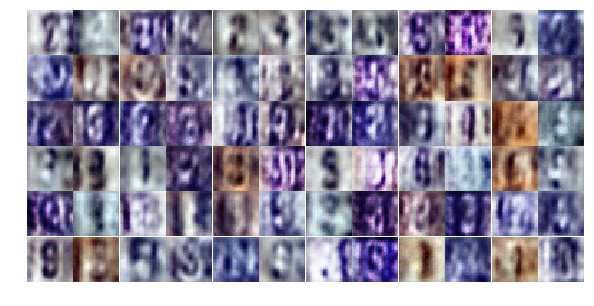

Epoch 2/25... Discriminator Loss: 1.1428... Generator Loss: 0.9617
Epoch 2/25... Discriminator Loss: 1.1552... Generator Loss: 1.2772
Epoch 2/25... Discriminator Loss: 1.0061... Generator Loss: 1.1652
Epoch 2/25... Discriminator Loss: 1.2385... Generator Loss: 0.7508
Epoch 2/25... Discriminator Loss: 1.0679... Generator Loss: 1.0465
Epoch 2/25... Discriminator Loss: 1.2493... Generator Loss: 0.7347
Epoch 2/25... Discriminator Loss: 1.0517... Generator Loss: 1.1630
Epoch 2/25... Discriminator Loss: 1.0045... Generator Loss: 1.1069
Epoch 2/25... Discriminator Loss: 0.7977... Generator Loss: 1.2202
Epoch 2/25... Discriminator Loss: 0.9250... Generator Loss: 1.0803


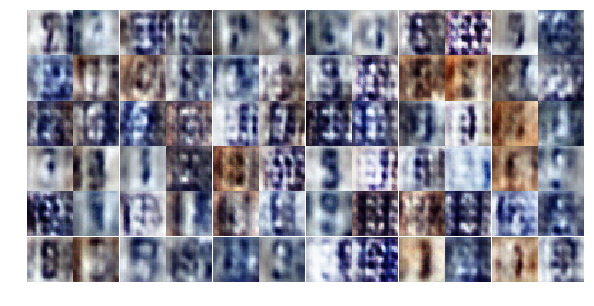

Epoch 2/25... Discriminator Loss: 1.1141... Generator Loss: 1.0560
Epoch 2/25... Discriminator Loss: 1.0080... Generator Loss: 1.1471
Epoch 2/25... Discriminator Loss: 1.2091... Generator Loss: 0.6832
Epoch 2/25... Discriminator Loss: 1.3200... Generator Loss: 0.6740
Epoch 3/25... Discriminator Loss: 0.8207... Generator Loss: 1.3418
Epoch 3/25... Discriminator Loss: 1.1681... Generator Loss: 0.7313
Epoch 3/25... Discriminator Loss: 0.8926... Generator Loss: 1.1163
Epoch 3/25... Discriminator Loss: 1.0098... Generator Loss: 1.1787
Epoch 3/25... Discriminator Loss: 0.9855... Generator Loss: 1.1811
Epoch 3/25... Discriminator Loss: 1.0580... Generator Loss: 1.3423


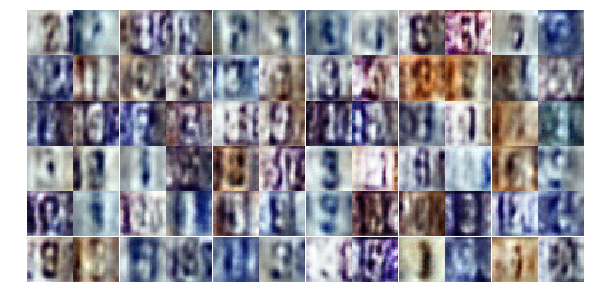

Epoch 3/25... Discriminator Loss: 0.9656... Generator Loss: 1.0851
Epoch 3/25... Discriminator Loss: 0.8225... Generator Loss: 1.1435
Epoch 3/25... Discriminator Loss: 1.4458... Generator Loss: 0.4834
Epoch 3/25... Discriminator Loss: 0.9779... Generator Loss: 0.9808
Epoch 3/25... Discriminator Loss: 1.1326... Generator Loss: 0.6903
Epoch 3/25... Discriminator Loss: 1.1340... Generator Loss: 0.6027
Epoch 3/25... Discriminator Loss: 1.0753... Generator Loss: 0.6426
Epoch 3/25... Discriminator Loss: 0.8671... Generator Loss: 1.6485
Epoch 3/25... Discriminator Loss: 0.8202... Generator Loss: 1.2538
Epoch 3/25... Discriminator Loss: 1.0636... Generator Loss: 0.6859


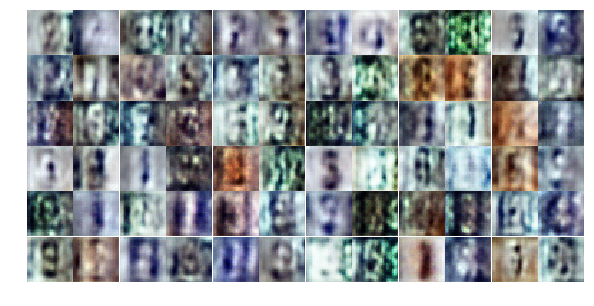

Epoch 3/25... Discriminator Loss: 0.9040... Generator Loss: 1.0302
Epoch 3/25... Discriminator Loss: 0.7311... Generator Loss: 0.9874
Epoch 3/25... Discriminator Loss: 0.8635... Generator Loss: 0.8471
Epoch 3/25... Discriminator Loss: 0.7325... Generator Loss: 1.3105
Epoch 3/25... Discriminator Loss: 1.2361... Generator Loss: 1.2296
Epoch 3/25... Discriminator Loss: 0.5571... Generator Loss: 1.7854
Epoch 3/25... Discriminator Loss: 0.7727... Generator Loss: 2.2032
Epoch 3/25... Discriminator Loss: 0.7836... Generator Loss: 1.0914
Epoch 3/25... Discriminator Loss: 0.4871... Generator Loss: 1.6098
Epoch 3/25... Discriminator Loss: 0.6206... Generator Loss: 1.6248


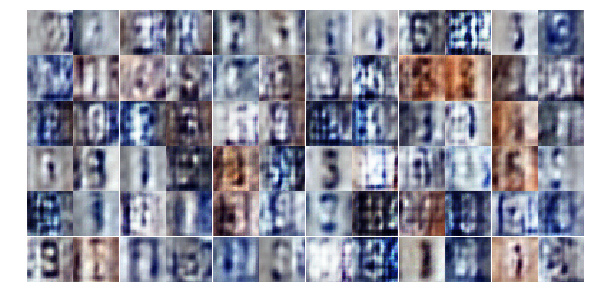

Epoch 3/25... Discriminator Loss: 0.7885... Generator Loss: 1.0094
Epoch 3/25... Discriminator Loss: 0.8440... Generator Loss: 0.9455
Epoch 3/25... Discriminator Loss: 0.4947... Generator Loss: 1.5882
Epoch 3/25... Discriminator Loss: 0.5588... Generator Loss: 1.1751
Epoch 3/25... Discriminator Loss: 0.5504... Generator Loss: 2.8427
Epoch 3/25... Discriminator Loss: 0.7592... Generator Loss: 2.2163
Epoch 3/25... Discriminator Loss: 1.4436... Generator Loss: 0.4118
Epoch 3/25... Discriminator Loss: 0.7214... Generator Loss: 1.1873
Epoch 3/25... Discriminator Loss: 0.3096... Generator Loss: 2.0813
Epoch 3/25... Discriminator Loss: 0.7248... Generator Loss: 2.6886


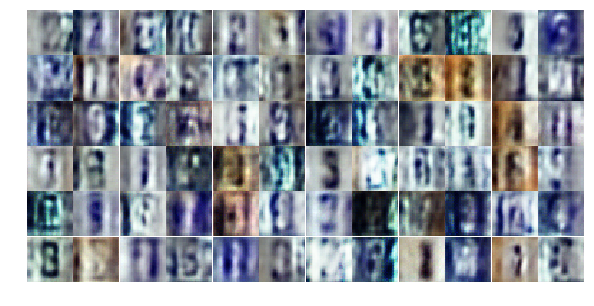

Epoch 3/25... Discriminator Loss: 0.8213... Generator Loss: 0.8288
Epoch 3/25... Discriminator Loss: 0.3666... Generator Loss: 1.8503
Epoch 3/25... Discriminator Loss: 0.5630... Generator Loss: 1.5983
Epoch 3/25... Discriminator Loss: 0.5235... Generator Loss: 1.5834
Epoch 3/25... Discriminator Loss: 0.3961... Generator Loss: 2.4869
Epoch 3/25... Discriminator Loss: 0.1630... Generator Loss: 2.9958
Epoch 3/25... Discriminator Loss: 1.2108... Generator Loss: 2.0637
Epoch 3/25... Discriminator Loss: 0.6195... Generator Loss: 1.2578
Epoch 3/25... Discriminator Loss: 0.4636... Generator Loss: 2.3804
Epoch 3/25... Discriminator Loss: 0.5995... Generator Loss: 2.2099


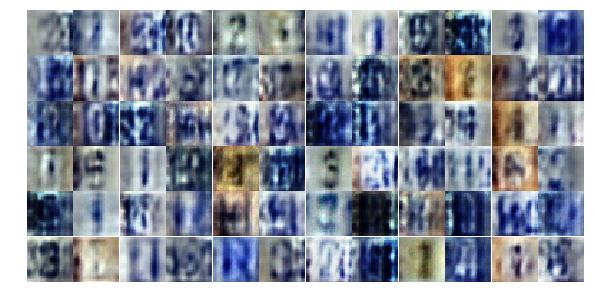

Epoch 3/25... Discriminator Loss: 0.7768... Generator Loss: 0.9732
Epoch 3/25... Discriminator Loss: 1.9273... Generator Loss: 0.2511
Epoch 3/25... Discriminator Loss: 0.3991... Generator Loss: 1.8095
Epoch 3/25... Discriminator Loss: 0.5021... Generator Loss: 1.4627
Epoch 3/25... Discriminator Loss: 0.7204... Generator Loss: 1.0954
Epoch 3/25... Discriminator Loss: 0.3516... Generator Loss: 2.7416
Epoch 3/25... Discriminator Loss: 0.4407... Generator Loss: 2.1755
Epoch 3/25... Discriminator Loss: 0.4131... Generator Loss: 2.2251
Epoch 3/25... Discriminator Loss: 1.0640... Generator Loss: 0.6269
Epoch 3/25... Discriminator Loss: 0.6672... Generator Loss: 1.9830


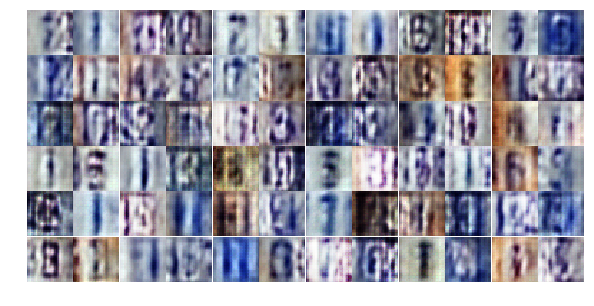

Epoch 3/25... Discriminator Loss: 0.7923... Generator Loss: 0.7912
Epoch 4/25... Discriminator Loss: 0.6404... Generator Loss: 1.4091
Epoch 4/25... Discriminator Loss: 0.4868... Generator Loss: 1.2901
Epoch 4/25... Discriminator Loss: 0.8846... Generator Loss: 0.7917
Epoch 4/25... Discriminator Loss: 0.6954... Generator Loss: 1.8814
Epoch 4/25... Discriminator Loss: 0.9918... Generator Loss: 0.7022
Epoch 4/25... Discriminator Loss: 0.6556... Generator Loss: 2.8340
Epoch 4/25... Discriminator Loss: 0.8030... Generator Loss: 1.2637
Epoch 4/25... Discriminator Loss: 0.4662... Generator Loss: 2.7823
Epoch 4/25... Discriminator Loss: 1.0631... Generator Loss: 0.6345


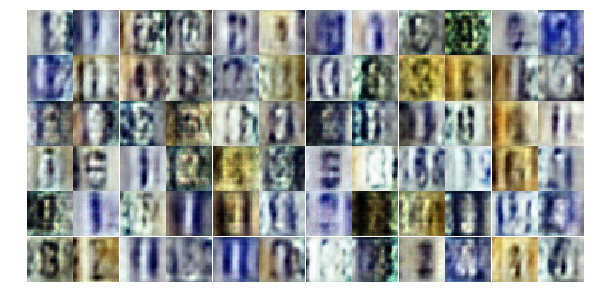

Epoch 4/25... Discriminator Loss: 0.4190... Generator Loss: 1.7000
Epoch 4/25... Discriminator Loss: 0.7191... Generator Loss: 2.3098
Epoch 4/25... Discriminator Loss: 0.2936... Generator Loss: 2.2367
Epoch 4/25... Discriminator Loss: 1.5138... Generator Loss: 1.5390
Epoch 4/25... Discriminator Loss: 0.9592... Generator Loss: 1.7630
Epoch 4/25... Discriminator Loss: 1.2390... Generator Loss: 1.0715
Epoch 4/25... Discriminator Loss: 0.9220... Generator Loss: 0.8560
Epoch 4/25... Discriminator Loss: 0.4016... Generator Loss: 2.0464
Epoch 4/25... Discriminator Loss: 0.8347... Generator Loss: 1.0948
Epoch 4/25... Discriminator Loss: 0.4462... Generator Loss: 2.3230


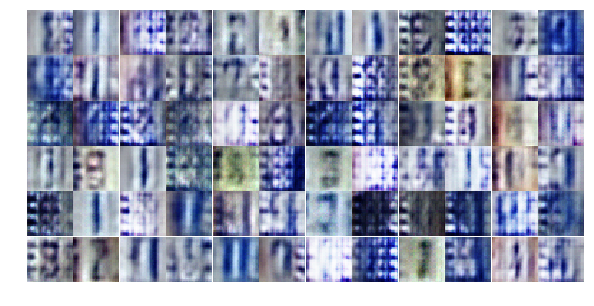

Epoch 4/25... Discriminator Loss: 1.0526... Generator Loss: 0.8909
Epoch 4/25... Discriminator Loss: 0.5841... Generator Loss: 2.0806
Epoch 4/25... Discriminator Loss: 0.5855... Generator Loss: 1.3761
Epoch 4/25... Discriminator Loss: 0.4216... Generator Loss: 1.8772
Epoch 4/25... Discriminator Loss: 0.5677... Generator Loss: 1.2356
Epoch 4/25... Discriminator Loss: 0.9690... Generator Loss: 1.5877
Epoch 4/25... Discriminator Loss: 0.3591... Generator Loss: 1.8424
Epoch 4/25... Discriminator Loss: 1.0907... Generator Loss: 0.6321
Epoch 4/25... Discriminator Loss: 0.7790... Generator Loss: 1.5547
Epoch 4/25... Discriminator Loss: 0.5251... Generator Loss: 1.6685


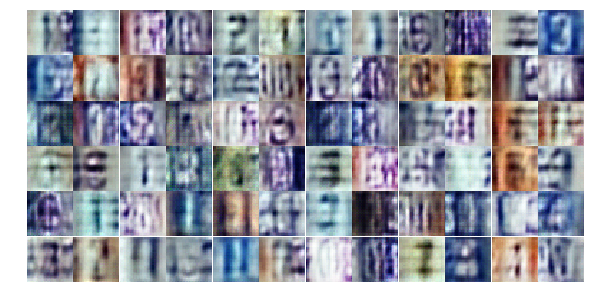

Epoch 4/25... Discriminator Loss: 0.5023... Generator Loss: 1.6516
Epoch 4/25... Discriminator Loss: 0.9889... Generator Loss: 0.8198
Epoch 4/25... Discriminator Loss: 0.5872... Generator Loss: 1.8009
Epoch 4/25... Discriminator Loss: 0.5519... Generator Loss: 1.4920
Epoch 4/25... Discriminator Loss: 0.5548... Generator Loss: 2.0224
Epoch 4/25... Discriminator Loss: 0.5364... Generator Loss: 2.5000
Epoch 4/25... Discriminator Loss: 0.8609... Generator Loss: 1.9561
Epoch 4/25... Discriminator Loss: 0.7442... Generator Loss: 0.9319
Epoch 4/25... Discriminator Loss: 0.9242... Generator Loss: 0.8956
Epoch 4/25... Discriminator Loss: 0.5882... Generator Loss: 1.5506


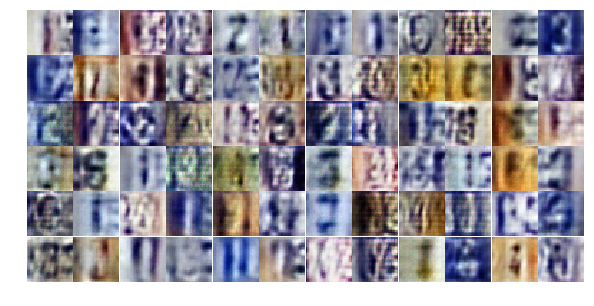

Epoch 4/25... Discriminator Loss: 0.9143... Generator Loss: 0.8281
Epoch 4/25... Discriminator Loss: 0.8454... Generator Loss: 0.8021
Epoch 4/25... Discriminator Loss: 0.6399... Generator Loss: 1.0686
Epoch 4/25... Discriminator Loss: 0.4994... Generator Loss: 1.4590
Epoch 4/25... Discriminator Loss: 0.4354... Generator Loss: 2.3350
Epoch 4/25... Discriminator Loss: 0.8923... Generator Loss: 0.8388
Epoch 4/25... Discriminator Loss: 0.8981... Generator Loss: 0.8008
Epoch 4/25... Discriminator Loss: 0.7154... Generator Loss: 1.2935
Epoch 4/25... Discriminator Loss: 1.0214... Generator Loss: 0.6616
Epoch 4/25... Discriminator Loss: 0.5836... Generator Loss: 1.4960


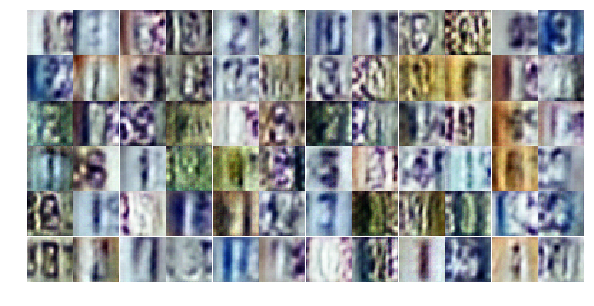

Epoch 4/25... Discriminator Loss: 0.4796... Generator Loss: 1.7440
Epoch 4/25... Discriminator Loss: 0.5962... Generator Loss: 1.4743
Epoch 4/25... Discriminator Loss: 0.3816... Generator Loss: 2.2479
Epoch 4/25... Discriminator Loss: 0.5502... Generator Loss: 1.5461
Epoch 4/25... Discriminator Loss: 0.9407... Generator Loss: 0.7573
Epoch 4/25... Discriminator Loss: 0.6519... Generator Loss: 1.1500
Epoch 4/25... Discriminator Loss: 0.5250... Generator Loss: 1.2610
Epoch 4/25... Discriminator Loss: 1.2040... Generator Loss: 2.1968
Epoch 4/25... Discriminator Loss: 0.6729... Generator Loss: 2.2748
Epoch 5/25... Discriminator Loss: 0.6453... Generator Loss: 1.0878


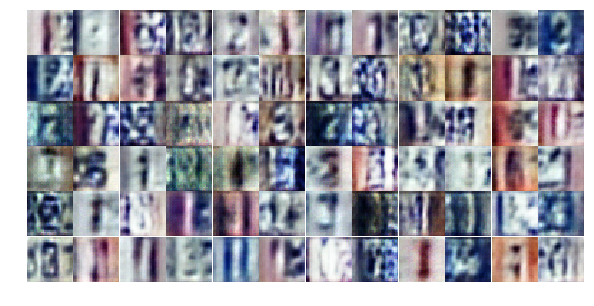

Epoch 5/25... Discriminator Loss: 0.4600... Generator Loss: 1.9186
Epoch 5/25... Discriminator Loss: 0.6869... Generator Loss: 1.3791
Epoch 5/25... Discriminator Loss: 0.5060... Generator Loss: 1.5533
Epoch 5/25... Discriminator Loss: 0.5333... Generator Loss: 1.2750
Epoch 5/25... Discriminator Loss: 0.4618... Generator Loss: 1.6962
Epoch 5/25... Discriminator Loss: 0.9541... Generator Loss: 0.7060
Epoch 5/25... Discriminator Loss: 0.3873... Generator Loss: 2.2008
Epoch 5/25... Discriminator Loss: 0.5385... Generator Loss: 2.0247
Epoch 5/25... Discriminator Loss: 0.9181... Generator Loss: 0.6673
Epoch 5/25... Discriminator Loss: 0.7948... Generator Loss: 1.3489


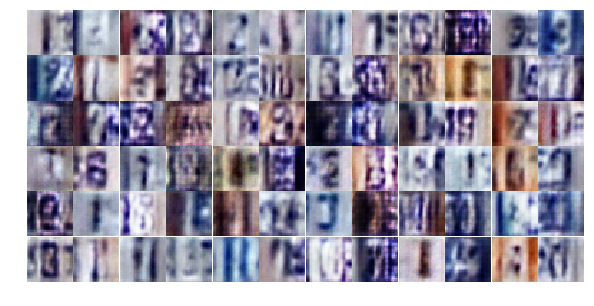

Epoch 5/25... Discriminator Loss: 0.4763... Generator Loss: 1.9455
Epoch 5/25... Discriminator Loss: 0.4897... Generator Loss: 1.9132
Epoch 5/25... Discriminator Loss: 0.8907... Generator Loss: 0.7013
Epoch 5/25... Discriminator Loss: 1.4944... Generator Loss: 0.3657
Epoch 5/25... Discriminator Loss: 0.7555... Generator Loss: 1.6605
Epoch 5/25... Discriminator Loss: 0.7409... Generator Loss: 0.9869
Epoch 5/25... Discriminator Loss: 0.6759... Generator Loss: 1.1001
Epoch 5/25... Discriminator Loss: 0.4087... Generator Loss: 1.7221
Epoch 5/25... Discriminator Loss: 0.3371... Generator Loss: 1.7274
Epoch 5/25... Discriminator Loss: 0.3443... Generator Loss: 1.9663


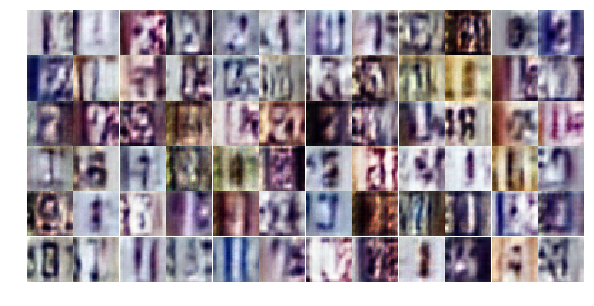

Epoch 5/25... Discriminator Loss: 0.6903... Generator Loss: 3.0747
Epoch 5/25... Discriminator Loss: 0.8301... Generator Loss: 0.9787
Epoch 5/25... Discriminator Loss: 0.7089... Generator Loss: 0.9500
Epoch 5/25... Discriminator Loss: 0.5874... Generator Loss: 1.3875
Epoch 5/25... Discriminator Loss: 0.9307... Generator Loss: 0.6984
Epoch 5/25... Discriminator Loss: 0.7207... Generator Loss: 1.9642
Epoch 5/25... Discriminator Loss: 0.5180... Generator Loss: 1.3462
Epoch 5/25... Discriminator Loss: 1.3789... Generator Loss: 0.5149
Epoch 5/25... Discriminator Loss: 0.9031... Generator Loss: 0.9277
Epoch 5/25... Discriminator Loss: 0.6330... Generator Loss: 1.7449


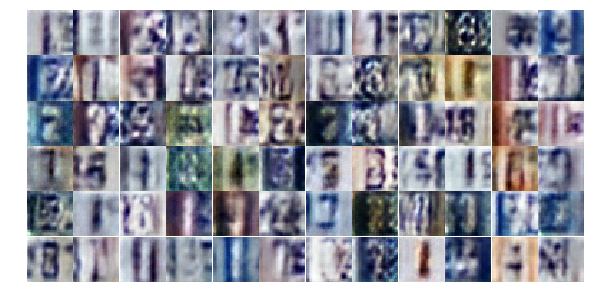

Epoch 5/25... Discriminator Loss: 0.6962... Generator Loss: 1.2196
Epoch 5/25... Discriminator Loss: 0.4780... Generator Loss: 1.4253
Epoch 5/25... Discriminator Loss: 0.5719... Generator Loss: 1.1300
Epoch 5/25... Discriminator Loss: 0.4432... Generator Loss: 1.6190
Epoch 5/25... Discriminator Loss: 0.6755... Generator Loss: 1.0145
Epoch 5/25... Discriminator Loss: 0.5045... Generator Loss: 2.4953
Epoch 5/25... Discriminator Loss: 1.1634... Generator Loss: 0.5458
Epoch 5/25... Discriminator Loss: 0.4096... Generator Loss: 1.5278
Epoch 5/25... Discriminator Loss: 1.3251... Generator Loss: 0.4523
Epoch 5/25... Discriminator Loss: 0.6853... Generator Loss: 1.0573


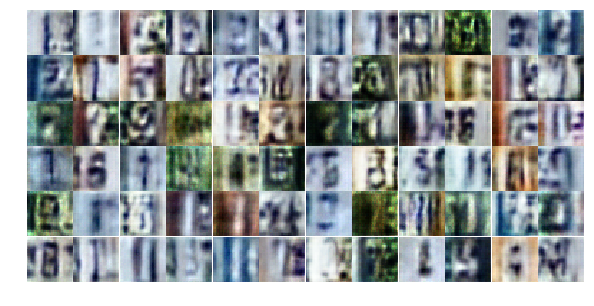

Epoch 5/25... Discriminator Loss: 0.3340... Generator Loss: 1.9679
Epoch 5/25... Discriminator Loss: 0.3002... Generator Loss: 2.1252
Epoch 5/25... Discriminator Loss: 0.5709... Generator Loss: 1.3868
Epoch 5/25... Discriminator Loss: 0.6306... Generator Loss: 1.2504
Epoch 5/25... Discriminator Loss: 0.9164... Generator Loss: 0.8038
Epoch 5/25... Discriminator Loss: 0.9741... Generator Loss: 0.6817
Epoch 5/25... Discriminator Loss: 0.7146... Generator Loss: 1.8993
Epoch 5/25... Discriminator Loss: 0.6165... Generator Loss: 1.6386
Epoch 5/25... Discriminator Loss: 0.7779... Generator Loss: 1.3212
Epoch 5/25... Discriminator Loss: 0.6670... Generator Loss: 1.0305


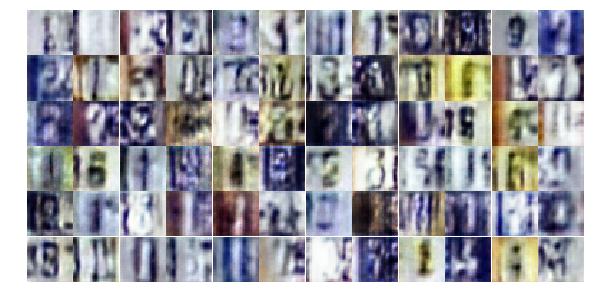

Epoch 5/25... Discriminator Loss: 0.9735... Generator Loss: 0.7442
Epoch 5/25... Discriminator Loss: 0.7272... Generator Loss: 0.9405
Epoch 5/25... Discriminator Loss: 0.7346... Generator Loss: 0.9714
Epoch 5/25... Discriminator Loss: 0.6465... Generator Loss: 1.0191
Epoch 5/25... Discriminator Loss: 0.7053... Generator Loss: 0.9863
Epoch 5/25... Discriminator Loss: 1.1520... Generator Loss: 0.4981
Epoch 6/25... Discriminator Loss: 0.6703... Generator Loss: 1.1332
Epoch 6/25... Discriminator Loss: 0.4789... Generator Loss: 1.4233
Epoch 6/25... Discriminator Loss: 1.3845... Generator Loss: 0.5161
Epoch 6/25... Discriminator Loss: 1.1229... Generator Loss: 0.5467


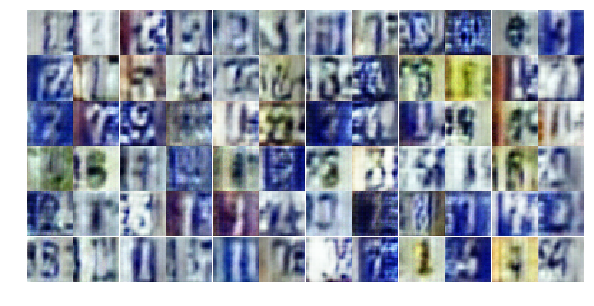

Epoch 6/25... Discriminator Loss: 0.3923... Generator Loss: 1.8774
Epoch 6/25... Discriminator Loss: 0.9366... Generator Loss: 0.6755
Epoch 6/25... Discriminator Loss: 0.4245... Generator Loss: 1.5387
Epoch 6/25... Discriminator Loss: 1.2503... Generator Loss: 0.4359
Epoch 6/25... Discriminator Loss: 0.9728... Generator Loss: 0.6480
Epoch 6/25... Discriminator Loss: 0.7060... Generator Loss: 0.8935
Epoch 6/25... Discriminator Loss: 0.6841... Generator Loss: 1.0110
Epoch 6/25... Discriminator Loss: 1.4548... Generator Loss: 0.3657
Epoch 6/25... Discriminator Loss: 0.6967... Generator Loss: 0.9788
Epoch 6/25... Discriminator Loss: 1.3085... Generator Loss: 0.5775


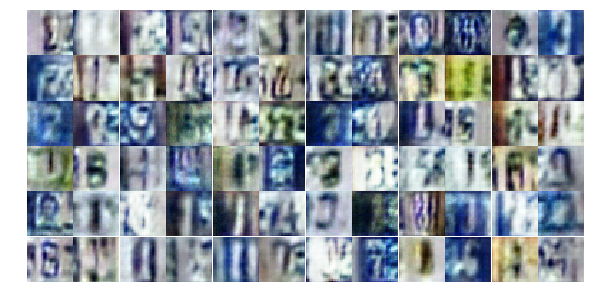

Epoch 6/25... Discriminator Loss: 0.6874... Generator Loss: 1.0569
Epoch 6/25... Discriminator Loss: 0.8092... Generator Loss: 1.4029
Epoch 6/25... Discriminator Loss: 1.3966... Generator Loss: 0.4129
Epoch 6/25... Discriminator Loss: 0.4040... Generator Loss: 1.7672
Epoch 6/25... Discriminator Loss: 0.4508... Generator Loss: 1.8171
Epoch 6/25... Discriminator Loss: 0.6091... Generator Loss: 1.0346
Epoch 6/25... Discriminator Loss: 0.6666... Generator Loss: 1.8572
Epoch 6/25... Discriminator Loss: 0.8920... Generator Loss: 0.7115
Epoch 6/25... Discriminator Loss: 0.9505... Generator Loss: 2.6327
Epoch 6/25... Discriminator Loss: 1.1131... Generator Loss: 0.5676


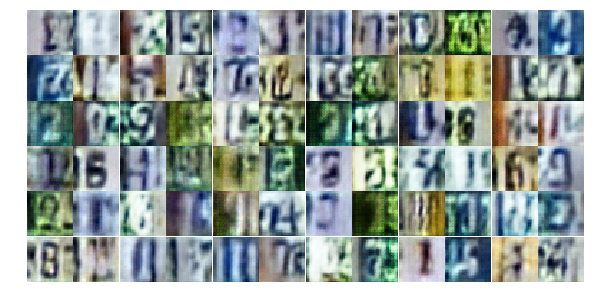

Epoch 6/25... Discriminator Loss: 1.0594... Generator Loss: 0.5666
Epoch 6/25... Discriminator Loss: 0.5679... Generator Loss: 1.3425
Epoch 6/25... Discriminator Loss: 1.4172... Generator Loss: 0.3715
Epoch 6/25... Discriminator Loss: 1.0001... Generator Loss: 0.6246
Epoch 6/25... Discriminator Loss: 0.5912... Generator Loss: 1.5556
Epoch 6/25... Discriminator Loss: 1.4392... Generator Loss: 0.3929
Epoch 6/25... Discriminator Loss: 0.6653... Generator Loss: 1.0722
Epoch 6/25... Discriminator Loss: 0.3700... Generator Loss: 1.7373
Epoch 6/25... Discriminator Loss: 0.5170... Generator Loss: 1.5771
Epoch 6/25... Discriminator Loss: 0.5350... Generator Loss: 1.3567


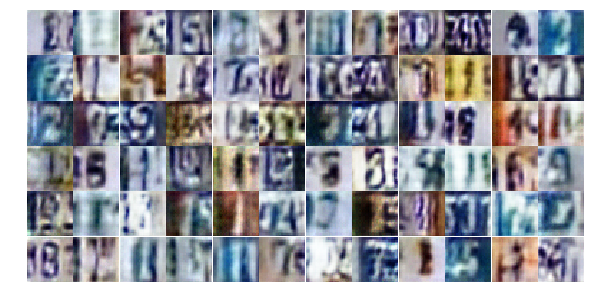

Epoch 6/25... Discriminator Loss: 0.9769... Generator Loss: 0.7432
Epoch 6/25... Discriminator Loss: 0.8522... Generator Loss: 2.1064
Epoch 6/25... Discriminator Loss: 1.2954... Generator Loss: 0.4667
Epoch 6/25... Discriminator Loss: 1.2708... Generator Loss: 0.5245
Epoch 6/25... Discriminator Loss: 0.8192... Generator Loss: 1.5152
Epoch 6/25... Discriminator Loss: 0.9041... Generator Loss: 0.7340
Epoch 6/25... Discriminator Loss: 0.4157... Generator Loss: 1.8078
Epoch 6/25... Discriminator Loss: 0.5879... Generator Loss: 1.2882
Epoch 6/25... Discriminator Loss: 0.8381... Generator Loss: 0.7974
Epoch 6/25... Discriminator Loss: 0.4694... Generator Loss: 1.3973


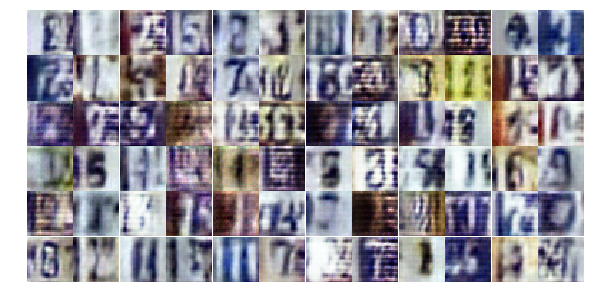

Epoch 6/25... Discriminator Loss: 0.6600... Generator Loss: 1.4214
Epoch 6/25... Discriminator Loss: 0.6101... Generator Loss: 1.2681
Epoch 6/25... Discriminator Loss: 1.4361... Generator Loss: 0.3636
Epoch 6/25... Discriminator Loss: 0.9085... Generator Loss: 2.2243
Epoch 6/25... Discriminator Loss: 0.7646... Generator Loss: 1.8943
Epoch 6/25... Discriminator Loss: 0.6377... Generator Loss: 1.2389
Epoch 6/25... Discriminator Loss: 0.8080... Generator Loss: 0.8928
Epoch 6/25... Discriminator Loss: 1.1532... Generator Loss: 0.5162
Epoch 6/25... Discriminator Loss: 0.6999... Generator Loss: 1.1095
Epoch 6/25... Discriminator Loss: 1.0582... Generator Loss: 0.5906


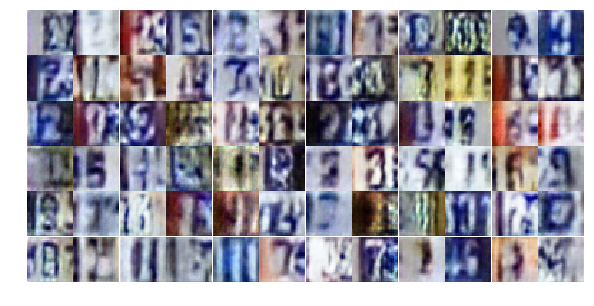

Epoch 6/25... Discriminator Loss: 0.5094... Generator Loss: 1.5041
Epoch 6/25... Discriminator Loss: 0.4554... Generator Loss: 1.7951
Epoch 6/25... Discriminator Loss: 0.5059... Generator Loss: 1.8014
Epoch 7/25... Discriminator Loss: 0.5186... Generator Loss: 1.2897
Epoch 7/25... Discriminator Loss: 0.5405... Generator Loss: 1.2795
Epoch 7/25... Discriminator Loss: 0.7567... Generator Loss: 0.9239
Epoch 7/25... Discriminator Loss: 0.5086... Generator Loss: 1.2598
Epoch 7/25... Discriminator Loss: 0.7899... Generator Loss: 0.9693
Epoch 7/25... Discriminator Loss: 0.5571... Generator Loss: 1.3314
Epoch 7/25... Discriminator Loss: 1.9984... Generator Loss: 0.2297


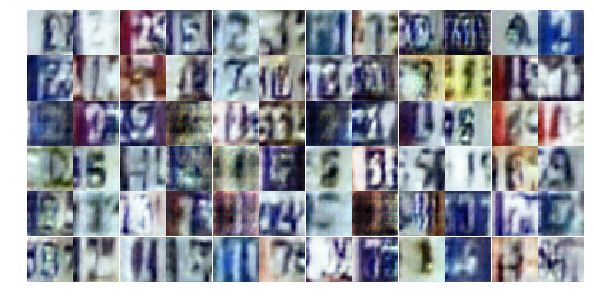

Epoch 7/25... Discriminator Loss: 0.8038... Generator Loss: 1.6428
Epoch 7/25... Discriminator Loss: 0.6631... Generator Loss: 1.1374
Epoch 7/25... Discriminator Loss: 0.6411... Generator Loss: 1.2068
Epoch 7/25... Discriminator Loss: 0.5398... Generator Loss: 1.5344
Epoch 7/25... Discriminator Loss: 0.5518... Generator Loss: 1.2819
Epoch 7/25... Discriminator Loss: 0.3594... Generator Loss: 2.0148
Epoch 7/25... Discriminator Loss: 0.8595... Generator Loss: 2.1012
Epoch 7/25... Discriminator Loss: 0.9337... Generator Loss: 1.9578
Epoch 7/25... Discriminator Loss: 0.6796... Generator Loss: 2.6079
Epoch 7/25... Discriminator Loss: 0.7002... Generator Loss: 0.9751


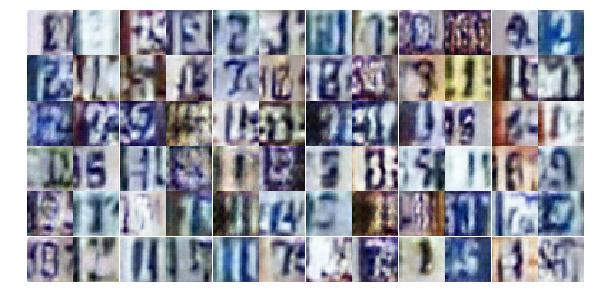

Epoch 7/25... Discriminator Loss: 0.5187... Generator Loss: 1.6386
Epoch 7/25... Discriminator Loss: 0.4944... Generator Loss: 1.4886
Epoch 7/25... Discriminator Loss: 1.1893... Generator Loss: 0.5735
Epoch 7/25... Discriminator Loss: 0.7007... Generator Loss: 1.1162
Epoch 7/25... Discriminator Loss: 0.6087... Generator Loss: 1.0995
Epoch 7/25... Discriminator Loss: 0.4674... Generator Loss: 1.9830
Epoch 7/25... Discriminator Loss: 0.5350... Generator Loss: 1.2216
Epoch 7/25... Discriminator Loss: 0.8922... Generator Loss: 0.7779
Epoch 7/25... Discriminator Loss: 0.5569... Generator Loss: 2.3028
Epoch 7/25... Discriminator Loss: 0.3851... Generator Loss: 1.8414


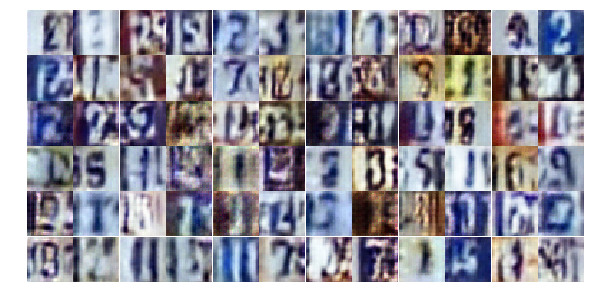

Epoch 7/25... Discriminator Loss: 1.3079... Generator Loss: 0.4355
Epoch 7/25... Discriminator Loss: 1.5138... Generator Loss: 0.4072
Epoch 7/25... Discriminator Loss: 0.6139... Generator Loss: 1.3912
Epoch 7/25... Discriminator Loss: 0.6570... Generator Loss: 1.1078
Epoch 7/25... Discriminator Loss: 0.8073... Generator Loss: 0.8100
Epoch 7/25... Discriminator Loss: 0.7222... Generator Loss: 1.4083
Epoch 7/25... Discriminator Loss: 0.4285... Generator Loss: 1.7068
Epoch 7/25... Discriminator Loss: 0.8372... Generator Loss: 0.7938
Epoch 7/25... Discriminator Loss: 0.9823... Generator Loss: 1.0464
Epoch 7/25... Discriminator Loss: 0.5941... Generator Loss: 1.2135


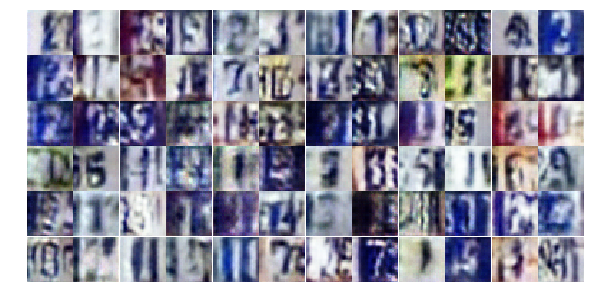

Epoch 7/25... Discriminator Loss: 0.9979... Generator Loss: 0.7433
Epoch 7/25... Discriminator Loss: 0.7503... Generator Loss: 0.8484
Epoch 7/25... Discriminator Loss: 0.4400... Generator Loss: 1.6583
Epoch 7/25... Discriminator Loss: 0.6212... Generator Loss: 1.8549
Epoch 7/25... Discriminator Loss: 0.5871... Generator Loss: 1.1710
Epoch 7/25... Discriminator Loss: 0.3872... Generator Loss: 1.6646
Epoch 7/25... Discriminator Loss: 0.5202... Generator Loss: 1.4142
Epoch 7/25... Discriminator Loss: 0.7140... Generator Loss: 1.1421
Epoch 7/25... Discriminator Loss: 0.4658... Generator Loss: 3.4883
Epoch 7/25... Discriminator Loss: 1.3032... Generator Loss: 0.5575


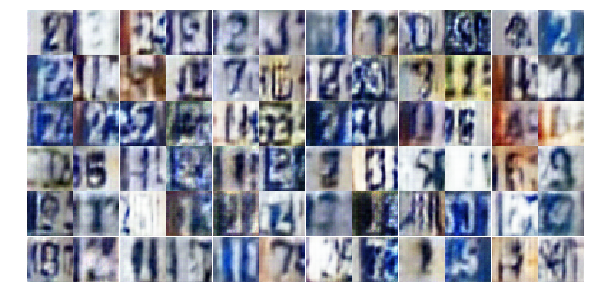

Epoch 7/25... Discriminator Loss: 0.6787... Generator Loss: 2.3613
Epoch 7/25... Discriminator Loss: 0.5591... Generator Loss: 1.3271
Epoch 7/25... Discriminator Loss: 0.9107... Generator Loss: 0.6823
Epoch 7/25... Discriminator Loss: 0.6172... Generator Loss: 1.6235
Epoch 7/25... Discriminator Loss: 0.6027... Generator Loss: 1.1675
Epoch 7/25... Discriminator Loss: 0.9532... Generator Loss: 0.7658
Epoch 7/25... Discriminator Loss: 0.9274... Generator Loss: 0.7214
Epoch 7/25... Discriminator Loss: 0.4559... Generator Loss: 1.7146
Epoch 7/25... Discriminator Loss: 0.8584... Generator Loss: 0.7820
Epoch 7/25... Discriminator Loss: 1.5749... Generator Loss: 0.3067


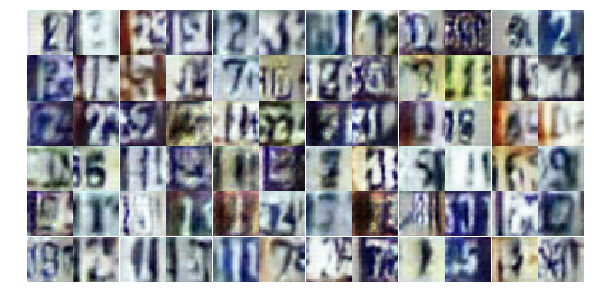

Epoch 7/25... Discriminator Loss: 0.5684... Generator Loss: 1.4555
Epoch 8/25... Discriminator Loss: 0.6043... Generator Loss: 1.1394
Epoch 8/25... Discriminator Loss: 0.7900... Generator Loss: 0.7916
Epoch 8/25... Discriminator Loss: 0.5972... Generator Loss: 1.1258
Epoch 8/25... Discriminator Loss: 0.4039... Generator Loss: 1.7031
Epoch 8/25... Discriminator Loss: 0.8224... Generator Loss: 0.8783
Epoch 8/25... Discriminator Loss: 0.8581... Generator Loss: 1.1008
Epoch 8/25... Discriminator Loss: 0.5069... Generator Loss: 2.1256
Epoch 8/25... Discriminator Loss: 0.9702... Generator Loss: 0.8467
Epoch 8/25... Discriminator Loss: 0.6411... Generator Loss: 1.2788


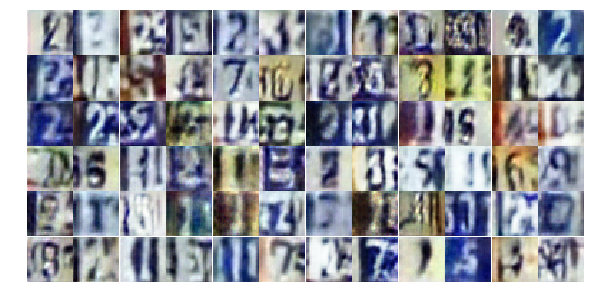

Epoch 8/25... Discriminator Loss: 0.4954... Generator Loss: 1.5871
Epoch 8/25... Discriminator Loss: 0.3506... Generator Loss: 1.7523
Epoch 8/25... Discriminator Loss: 0.8444... Generator Loss: 0.7913
Epoch 8/25... Discriminator Loss: 0.2592... Generator Loss: 2.1929
Epoch 8/25... Discriminator Loss: 0.6366... Generator Loss: 1.1447
Epoch 8/25... Discriminator Loss: 0.9145... Generator Loss: 2.1337
Epoch 8/25... Discriminator Loss: 0.7517... Generator Loss: 3.8460
Epoch 8/25... Discriminator Loss: 0.6035... Generator Loss: 1.3904
Epoch 8/25... Discriminator Loss: 0.8396... Generator Loss: 0.8529
Epoch 8/25... Discriminator Loss: 1.5163... Generator Loss: 0.3200


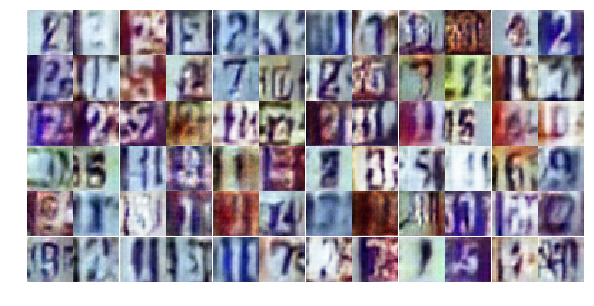

Epoch 8/25... Discriminator Loss: 0.4970... Generator Loss: 1.9027
Epoch 8/25... Discriminator Loss: 0.7261... Generator Loss: 0.9261
Epoch 8/25... Discriminator Loss: 0.6480... Generator Loss: 1.3454
Epoch 8/25... Discriminator Loss: 0.6732... Generator Loss: 1.3806
Epoch 8/25... Discriminator Loss: 0.2892... Generator Loss: 2.2580
Epoch 8/25... Discriminator Loss: 0.5867... Generator Loss: 1.1651
Epoch 8/25... Discriminator Loss: 0.6169... Generator Loss: 1.5495
Epoch 8/25... Discriminator Loss: 0.4990... Generator Loss: 1.2213
Epoch 8/25... Discriminator Loss: 0.4821... Generator Loss: 1.5712
Epoch 8/25... Discriminator Loss: 0.8978... Generator Loss: 0.7214


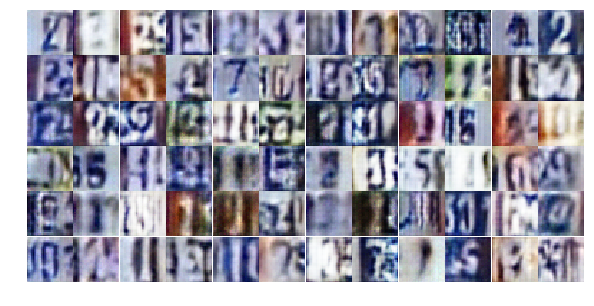

Epoch 8/25... Discriminator Loss: 0.5609... Generator Loss: 1.4334
Epoch 8/25... Discriminator Loss: 1.1085... Generator Loss: 0.5809
Epoch 8/25... Discriminator Loss: 0.6523... Generator Loss: 1.1787
Epoch 8/25... Discriminator Loss: 0.4328... Generator Loss: 1.5136
Epoch 8/25... Discriminator Loss: 0.5158... Generator Loss: 1.2584
Epoch 8/25... Discriminator Loss: 0.5947... Generator Loss: 1.0841
Epoch 8/25... Discriminator Loss: 2.2205... Generator Loss: 0.1739
Epoch 8/25... Discriminator Loss: 1.2436... Generator Loss: 0.5325
Epoch 8/25... Discriminator Loss: 0.3358... Generator Loss: 1.7440
Epoch 8/25... Discriminator Loss: 0.4763... Generator Loss: 1.6170


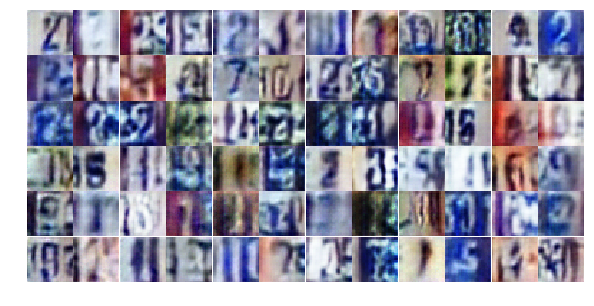

Epoch 8/25... Discriminator Loss: 0.6640... Generator Loss: 1.5842
Epoch 8/25... Discriminator Loss: 1.2355... Generator Loss: 0.5114
Epoch 8/25... Discriminator Loss: 0.5641... Generator Loss: 1.1689
Epoch 8/25... Discriminator Loss: 0.6286... Generator Loss: 1.1045
Epoch 8/25... Discriminator Loss: 1.1248... Generator Loss: 2.5511
Epoch 8/25... Discriminator Loss: 0.6489... Generator Loss: 1.1311
Epoch 8/25... Discriminator Loss: 0.4568... Generator Loss: 2.7924
Epoch 8/25... Discriminator Loss: 0.4908... Generator Loss: 1.4689
Epoch 8/25... Discriminator Loss: 0.5859... Generator Loss: 1.3061
Epoch 8/25... Discriminator Loss: 0.9956... Generator Loss: 0.7709


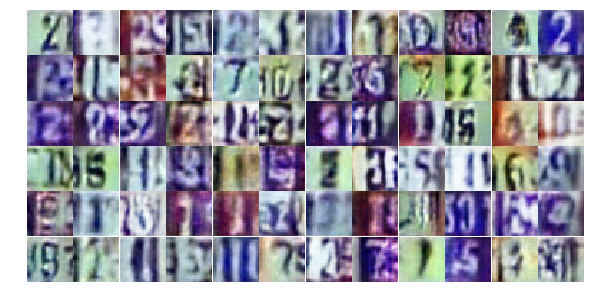

Epoch 8/25... Discriminator Loss: 0.4083... Generator Loss: 1.5918
Epoch 8/25... Discriminator Loss: 0.6449... Generator Loss: 1.0504
Epoch 8/25... Discriminator Loss: 1.4718... Generator Loss: 3.8439
Epoch 8/25... Discriminator Loss: 0.8324... Generator Loss: 0.8720
Epoch 8/25... Discriminator Loss: 0.3845... Generator Loss: 1.9421
Epoch 8/25... Discriminator Loss: 1.0017... Generator Loss: 0.6530
Epoch 8/25... Discriminator Loss: 0.5639... Generator Loss: 1.1223
Epoch 8/25... Discriminator Loss: 0.6870... Generator Loss: 2.9402
Epoch 9/25... Discriminator Loss: 0.8588... Generator Loss: 0.7620
Epoch 9/25... Discriminator Loss: 0.6492... Generator Loss: 1.3706


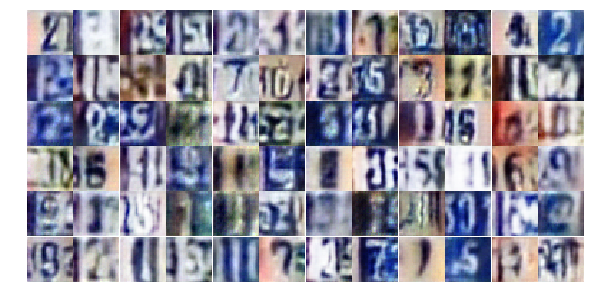

Epoch 9/25... Discriminator Loss: 0.8502... Generator Loss: 0.7810
Epoch 9/25... Discriminator Loss: 0.5863... Generator Loss: 1.2425
Epoch 9/25... Discriminator Loss: 0.8330... Generator Loss: 0.8281
Epoch 9/25... Discriminator Loss: 0.3591... Generator Loss: 1.9287
Epoch 9/25... Discriminator Loss: 1.3370... Generator Loss: 0.4090
Epoch 9/25... Discriminator Loss: 0.4090... Generator Loss: 1.6594
Epoch 9/25... Discriminator Loss: 0.5033... Generator Loss: 1.5039
Epoch 9/25... Discriminator Loss: 0.4986... Generator Loss: 1.4004
Epoch 9/25... Discriminator Loss: 0.7476... Generator Loss: 0.8864
Epoch 9/25... Discriminator Loss: 0.5682... Generator Loss: 1.1898


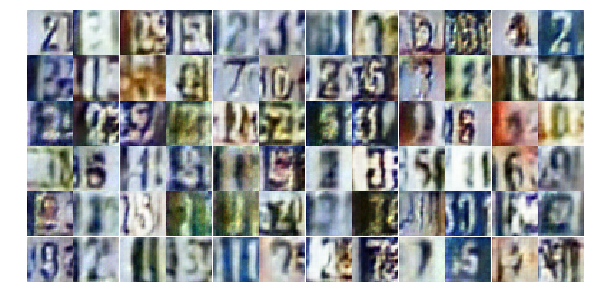

Epoch 9/25... Discriminator Loss: 0.6740... Generator Loss: 1.1793
Epoch 9/25... Discriminator Loss: 0.8865... Generator Loss: 0.7490
Epoch 9/25... Discriminator Loss: 0.8443... Generator Loss: 0.9029
Epoch 9/25... Discriminator Loss: 0.5689... Generator Loss: 1.2378
Epoch 9/25... Discriminator Loss: 0.5402... Generator Loss: 1.2942
Epoch 9/25... Discriminator Loss: 0.8222... Generator Loss: 0.9486
Epoch 9/25... Discriminator Loss: 1.1000... Generator Loss: 0.5365
Epoch 9/25... Discriminator Loss: 0.4780... Generator Loss: 1.3784
Epoch 9/25... Discriminator Loss: 1.2151... Generator Loss: 0.4624
Epoch 9/25... Discriminator Loss: 0.7596... Generator Loss: 1.8792


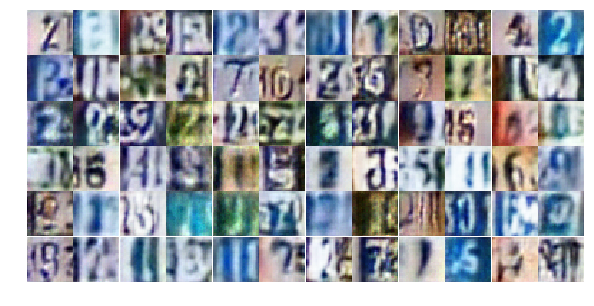

Epoch 9/25... Discriminator Loss: 0.8394... Generator Loss: 0.8678
Epoch 9/25... Discriminator Loss: 0.6636... Generator Loss: 1.0804
Epoch 9/25... Discriminator Loss: 0.6765... Generator Loss: 1.4608
Epoch 9/25... Discriminator Loss: 0.6080... Generator Loss: 1.2647
Epoch 9/25... Discriminator Loss: 0.5109... Generator Loss: 1.2033
Epoch 9/25... Discriminator Loss: 0.3354... Generator Loss: 1.9978
Epoch 9/25... Discriminator Loss: 1.2155... Generator Loss: 0.4811
Epoch 9/25... Discriminator Loss: 0.4285... Generator Loss: 2.2110
Epoch 9/25... Discriminator Loss: 0.6190... Generator Loss: 2.0506
Epoch 9/25... Discriminator Loss: 0.4367... Generator Loss: 1.7411


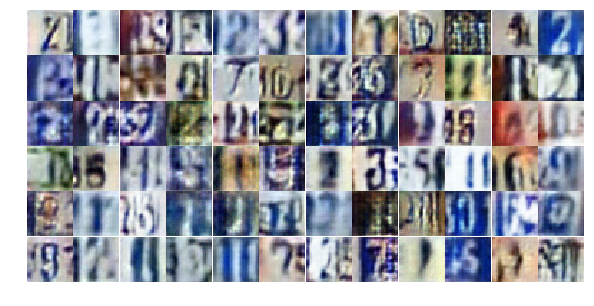

Epoch 9/25... Discriminator Loss: 0.4804... Generator Loss: 1.5020
Epoch 9/25... Discriminator Loss: 0.4341... Generator Loss: 1.4643
Epoch 9/25... Discriminator Loss: 0.6523... Generator Loss: 1.5907
Epoch 9/25... Discriminator Loss: 0.6365... Generator Loss: 1.1399
Epoch 9/25... Discriminator Loss: 0.7182... Generator Loss: 0.9430
Epoch 9/25... Discriminator Loss: 0.4925... Generator Loss: 1.4454
Epoch 9/25... Discriminator Loss: 0.4822... Generator Loss: 1.8553
Epoch 9/25... Discriminator Loss: 0.4220... Generator Loss: 1.5136
Epoch 9/25... Discriminator Loss: 0.4854... Generator Loss: 1.4153
Epoch 9/25... Discriminator Loss: 1.3622... Generator Loss: 2.9790


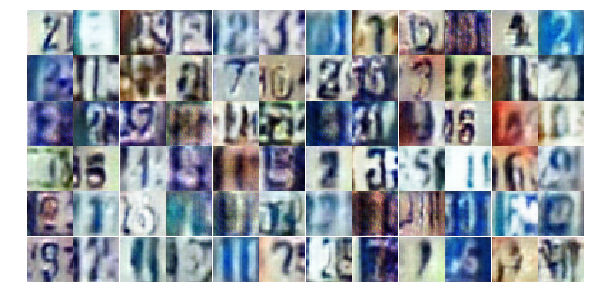

Epoch 9/25... Discriminator Loss: 0.5388... Generator Loss: 1.4186
Epoch 9/25... Discriminator Loss: 0.5947... Generator Loss: 1.4033
Epoch 9/25... Discriminator Loss: 0.5769... Generator Loss: 2.1668
Epoch 9/25... Discriminator Loss: 0.5875... Generator Loss: 1.2591
Epoch 9/25... Discriminator Loss: 0.3871... Generator Loss: 2.2185
Epoch 9/25... Discriminator Loss: 0.7230... Generator Loss: 0.9830
Epoch 9/25... Discriminator Loss: 1.0426... Generator Loss: 0.5867
Epoch 9/25... Discriminator Loss: 0.4698... Generator Loss: 1.4580
Epoch 9/25... Discriminator Loss: 0.6659... Generator Loss: 1.0553
Epoch 9/25... Discriminator Loss: 0.6862... Generator Loss: 1.6396


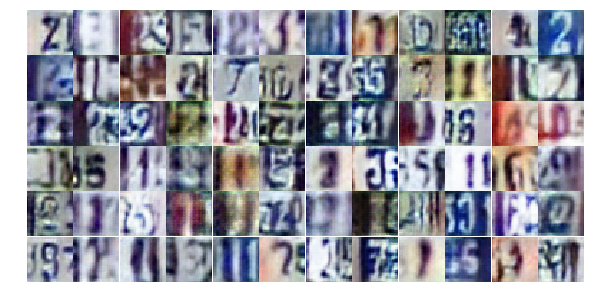

Epoch 9/25... Discriminator Loss: 1.2310... Generator Loss: 0.5151
Epoch 9/25... Discriminator Loss: 0.8300... Generator Loss: 1.3070
Epoch 9/25... Discriminator Loss: 0.5516... Generator Loss: 1.1951
Epoch 9/25... Discriminator Loss: 1.1538... Generator Loss: 0.4934
Epoch 9/25... Discriminator Loss: 0.4310... Generator Loss: 1.7131
Epoch 10/25... Discriminator Loss: 1.0030... Generator Loss: 0.6013
Epoch 10/25... Discriminator Loss: 0.6793... Generator Loss: 1.2808
Epoch 10/25... Discriminator Loss: 0.6739... Generator Loss: 1.0082
Epoch 10/25... Discriminator Loss: 0.8893... Generator Loss: 0.7599
Epoch 10/25... Discriminator Loss: 1.1059... Generator Loss: 0.5077


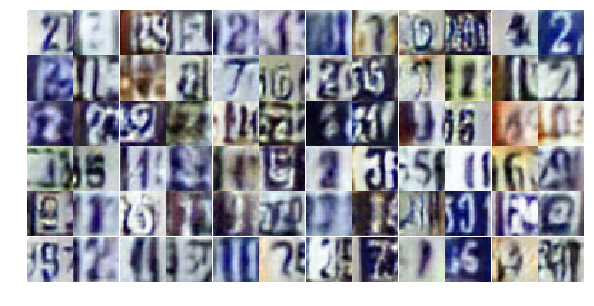

Epoch 10/25... Discriminator Loss: 0.7157... Generator Loss: 0.9819
Epoch 10/25... Discriminator Loss: 0.6433... Generator Loss: 1.0157
Epoch 10/25... Discriminator Loss: 0.6210... Generator Loss: 1.2413
Epoch 10/25... Discriminator Loss: 0.4299... Generator Loss: 1.9445
Epoch 10/25... Discriminator Loss: 0.6805... Generator Loss: 1.0686
Epoch 10/25... Discriminator Loss: 0.6082... Generator Loss: 1.6622
Epoch 10/25... Discriminator Loss: 0.6862... Generator Loss: 0.8935
Epoch 10/25... Discriminator Loss: 1.1737... Generator Loss: 0.5489
Epoch 10/25... Discriminator Loss: 2.7153... Generator Loss: 0.1160
Epoch 10/25... Discriminator Loss: 0.6895... Generator Loss: 1.2705


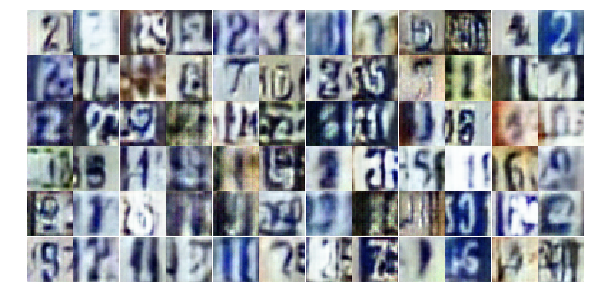

Epoch 10/25... Discriminator Loss: 0.5305... Generator Loss: 1.4676
Epoch 10/25... Discriminator Loss: 1.0183... Generator Loss: 0.6140
Epoch 10/25... Discriminator Loss: 0.4890... Generator Loss: 1.3449
Epoch 10/25... Discriminator Loss: 1.2669... Generator Loss: 0.4762
Epoch 10/25... Discriminator Loss: 0.6270... Generator Loss: 1.3959
Epoch 10/25... Discriminator Loss: 0.4385... Generator Loss: 1.4740
Epoch 10/25... Discriminator Loss: 0.6822... Generator Loss: 1.0885
Epoch 10/25... Discriminator Loss: 0.4494... Generator Loss: 1.9446
Epoch 10/25... Discriminator Loss: 0.7791... Generator Loss: 0.9068
Epoch 10/25... Discriminator Loss: 0.3619... Generator Loss: 2.6929


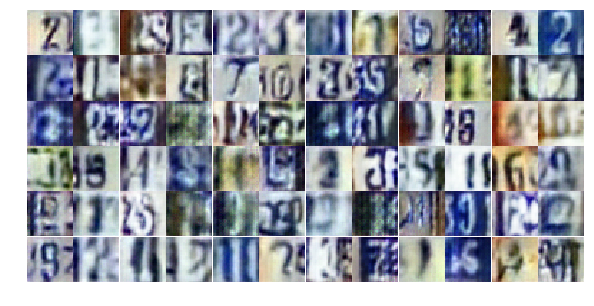

Epoch 10/25... Discriminator Loss: 0.5353... Generator Loss: 1.2055
Epoch 10/25... Discriminator Loss: 0.6963... Generator Loss: 1.3211
Epoch 10/25... Discriminator Loss: 0.4925... Generator Loss: 1.4113
Epoch 10/25... Discriminator Loss: 0.5147... Generator Loss: 1.6739
Epoch 10/25... Discriminator Loss: 1.3521... Generator Loss: 0.3866
Epoch 10/25... Discriminator Loss: 0.6311... Generator Loss: 1.0706
Epoch 10/25... Discriminator Loss: 0.4762... Generator Loss: 1.2974
Epoch 10/25... Discriminator Loss: 0.5681... Generator Loss: 1.3983
Epoch 10/25... Discriminator Loss: 0.5548... Generator Loss: 1.1814
Epoch 10/25... Discriminator Loss: 0.6285... Generator Loss: 1.0605


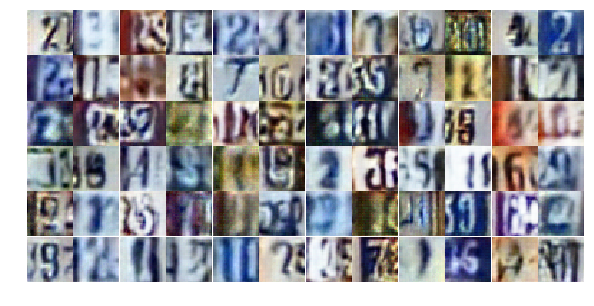

Epoch 10/25... Discriminator Loss: 0.8644... Generator Loss: 2.6950
Epoch 10/25... Discriminator Loss: 0.8008... Generator Loss: 0.8619
Epoch 10/25... Discriminator Loss: 0.5577... Generator Loss: 1.8434
Epoch 10/25... Discriminator Loss: 0.5829... Generator Loss: 1.6540
Epoch 10/25... Discriminator Loss: 0.9494... Generator Loss: 0.7199
Epoch 10/25... Discriminator Loss: 0.6121... Generator Loss: 1.1127
Epoch 10/25... Discriminator Loss: 0.8884... Generator Loss: 0.7276
Epoch 10/25... Discriminator Loss: 0.7740... Generator Loss: 0.8916
Epoch 10/25... Discriminator Loss: 0.5673... Generator Loss: 1.1842
Epoch 10/25... Discriminator Loss: 2.4070... Generator Loss: 5.2615


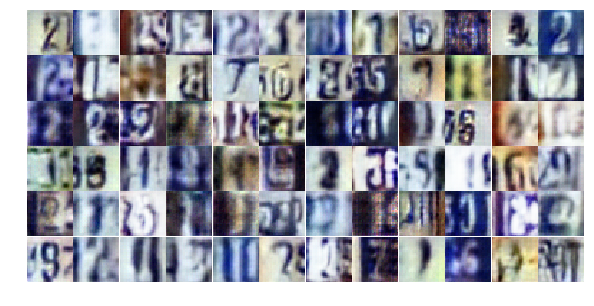

Epoch 10/25... Discriminator Loss: 1.8938... Generator Loss: 0.2719
Epoch 10/25... Discriminator Loss: 1.1520... Generator Loss: 0.5861
Epoch 10/25... Discriminator Loss: 0.8490... Generator Loss: 0.8562
Epoch 10/25... Discriminator Loss: 0.5300... Generator Loss: 1.4772
Epoch 10/25... Discriminator Loss: 0.5892... Generator Loss: 1.5903
Epoch 10/25... Discriminator Loss: 0.5539... Generator Loss: 1.4658
Epoch 10/25... Discriminator Loss: 0.5157... Generator Loss: 1.5016
Epoch 10/25... Discriminator Loss: 0.4858... Generator Loss: 1.4519
Epoch 10/25... Discriminator Loss: 0.5967... Generator Loss: 1.9306
Epoch 10/25... Discriminator Loss: 0.4893... Generator Loss: 1.5527


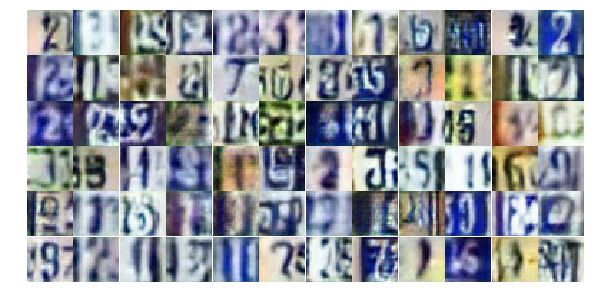

Epoch 10/25... Discriminator Loss: 0.7519... Generator Loss: 1.7519
Epoch 10/25... Discriminator Loss: 0.3935... Generator Loss: 1.5776
Epoch 10/25... Discriminator Loss: 0.4006... Generator Loss: 1.4413
Epoch 11/25... Discriminator Loss: 0.7121... Generator Loss: 1.3042
Epoch 11/25... Discriminator Loss: 0.5317... Generator Loss: 1.3248
Epoch 11/25... Discriminator Loss: 0.8953... Generator Loss: 1.1271
Epoch 11/25... Discriminator Loss: 0.8554... Generator Loss: 0.7412
Epoch 11/25... Discriminator Loss: 0.8294... Generator Loss: 0.8871
Epoch 11/25... Discriminator Loss: 1.2347... Generator Loss: 0.6070
Epoch 11/25... Discriminator Loss: 0.4500... Generator Loss: 1.6684


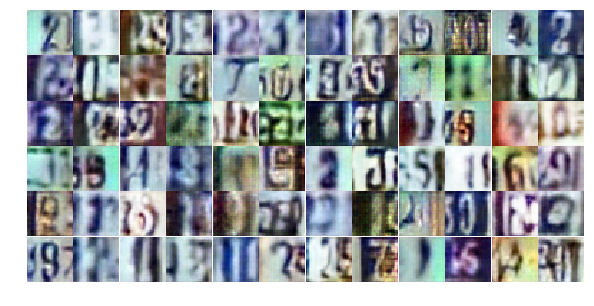

Epoch 11/25... Discriminator Loss: 0.4309... Generator Loss: 2.8719
Epoch 11/25... Discriminator Loss: 0.6183... Generator Loss: 1.3667
Epoch 11/25... Discriminator Loss: 0.3149... Generator Loss: 1.9444
Epoch 11/25... Discriminator Loss: 0.7214... Generator Loss: 0.9311
Epoch 11/25... Discriminator Loss: 1.4878... Generator Loss: 0.3577
Epoch 11/25... Discriminator Loss: 0.5184... Generator Loss: 1.6618
Epoch 11/25... Discriminator Loss: 0.6904... Generator Loss: 1.4613
Epoch 11/25... Discriminator Loss: 0.4054... Generator Loss: 1.6115
Epoch 11/25... Discriminator Loss: 0.4700... Generator Loss: 1.3808
Epoch 11/25... Discriminator Loss: 1.1315... Generator Loss: 0.5475


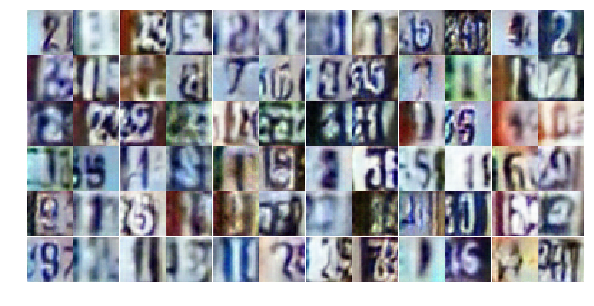

Epoch 11/25... Discriminator Loss: 0.7494... Generator Loss: 0.9069
Epoch 11/25... Discriminator Loss: 0.5358... Generator Loss: 1.7522
Epoch 11/25... Discriminator Loss: 0.8971... Generator Loss: 0.7245
Epoch 11/25... Discriminator Loss: 0.4955... Generator Loss: 1.3804
Epoch 11/25... Discriminator Loss: 0.3579... Generator Loss: 2.2834
Epoch 11/25... Discriminator Loss: 0.5124... Generator Loss: 1.2085
Epoch 11/25... Discriminator Loss: 0.6702... Generator Loss: 1.0307
Epoch 11/25... Discriminator Loss: 0.7385... Generator Loss: 1.1893
Epoch 11/25... Discriminator Loss: 0.4028... Generator Loss: 1.6067
Epoch 11/25... Discriminator Loss: 0.9973... Generator Loss: 0.6833


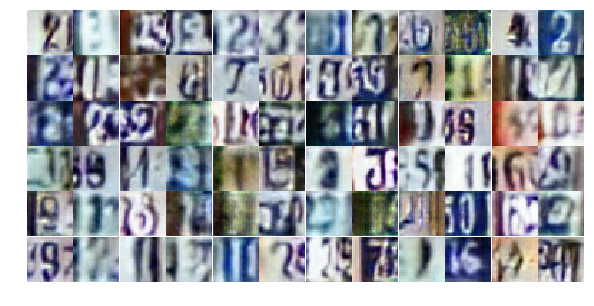

Epoch 11/25... Discriminator Loss: 0.7114... Generator Loss: 1.3273
Epoch 11/25... Discriminator Loss: 0.6086... Generator Loss: 1.6042
Epoch 11/25... Discriminator Loss: 0.7563... Generator Loss: 0.9618
Epoch 11/25... Discriminator Loss: 0.4477... Generator Loss: 1.5548
Epoch 11/25... Discriminator Loss: 0.7460... Generator Loss: 0.9303
Epoch 11/25... Discriminator Loss: 1.4061... Generator Loss: 0.3911
Epoch 11/25... Discriminator Loss: 0.8937... Generator Loss: 0.7271
Epoch 11/25... Discriminator Loss: 1.0005... Generator Loss: 0.7039
Epoch 11/25... Discriminator Loss: 0.5612... Generator Loss: 1.5190
Epoch 11/25... Discriminator Loss: 1.1579... Generator Loss: 0.5282


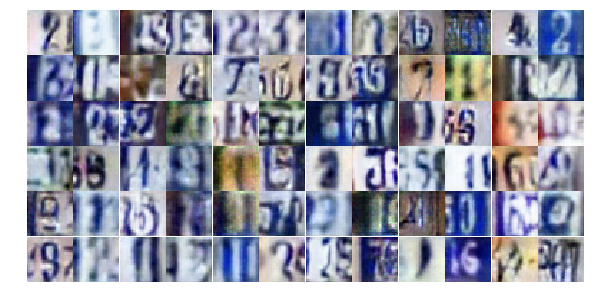

Epoch 11/25... Discriminator Loss: 0.5026... Generator Loss: 1.2635
Epoch 11/25... Discriminator Loss: 0.6729... Generator Loss: 0.9959
Epoch 11/25... Discriminator Loss: 0.6052... Generator Loss: 1.2964
Epoch 11/25... Discriminator Loss: 0.8519... Generator Loss: 0.7940
Epoch 11/25... Discriminator Loss: 1.2126... Generator Loss: 0.5604
Epoch 11/25... Discriminator Loss: 0.8484... Generator Loss: 0.7725
Epoch 11/25... Discriminator Loss: 0.5551... Generator Loss: 1.5932
Epoch 11/25... Discriminator Loss: 0.5266... Generator Loss: 1.5498
Epoch 11/25... Discriminator Loss: 1.1309... Generator Loss: 0.6060
Epoch 11/25... Discriminator Loss: 0.5987... Generator Loss: 1.1951


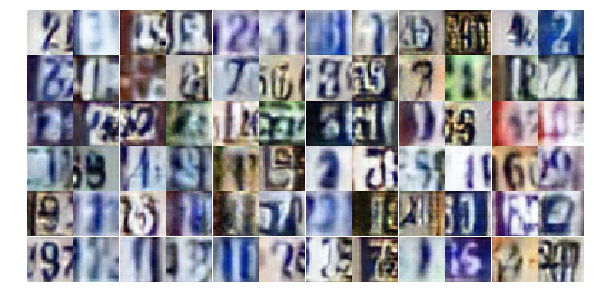

Epoch 11/25... Discriminator Loss: 1.1874... Generator Loss: 0.5289
Epoch 11/25... Discriminator Loss: 0.3669... Generator Loss: 2.0907
Epoch 11/25... Discriminator Loss: 0.6846... Generator Loss: 1.5166
Epoch 11/25... Discriminator Loss: 0.7365... Generator Loss: 0.9349
Epoch 11/25... Discriminator Loss: 0.6679... Generator Loss: 1.1483
Epoch 11/25... Discriminator Loss: 0.5994... Generator Loss: 1.1597
Epoch 11/25... Discriminator Loss: 1.0636... Generator Loss: 0.6398
Epoch 11/25... Discriminator Loss: 0.6103... Generator Loss: 1.2537
Epoch 11/25... Discriminator Loss: 0.8990... Generator Loss: 0.8212
Epoch 11/25... Discriminator Loss: 0.9314... Generator Loss: 0.7075


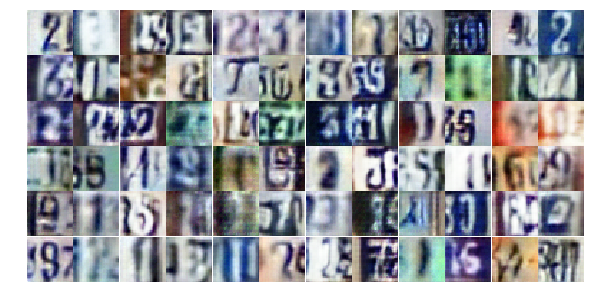

Epoch 12/25... Discriminator Loss: 0.7247... Generator Loss: 1.2184
Epoch 12/25... Discriminator Loss: 0.5910... Generator Loss: 1.3816
Epoch 12/25... Discriminator Loss: 0.7514... Generator Loss: 1.1057
Epoch 12/25... Discriminator Loss: 0.5583... Generator Loss: 1.2605
Epoch 12/25... Discriminator Loss: 0.4189... Generator Loss: 1.6251
Epoch 12/25... Discriminator Loss: 1.4850... Generator Loss: 0.3892
Epoch 12/25... Discriminator Loss: 0.5250... Generator Loss: 1.2907
Epoch 12/25... Discriminator Loss: 0.5622... Generator Loss: 1.6083
Epoch 12/25... Discriminator Loss: 0.6895... Generator Loss: 1.2644
Epoch 12/25... Discriminator Loss: 0.9083... Generator Loss: 0.7279


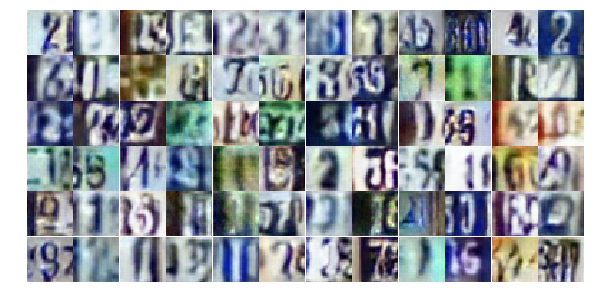

Epoch 12/25... Discriminator Loss: 0.5568... Generator Loss: 1.1753
Epoch 12/25... Discriminator Loss: 0.7200... Generator Loss: 1.2044
Epoch 12/25... Discriminator Loss: 0.4597... Generator Loss: 1.5895
Epoch 12/25... Discriminator Loss: 0.6245... Generator Loss: 1.6722
Epoch 12/25... Discriminator Loss: 0.5332... Generator Loss: 1.7756
Epoch 12/25... Discriminator Loss: 1.0962... Generator Loss: 0.6016
Epoch 12/25... Discriminator Loss: 1.4817... Generator Loss: 0.4309
Epoch 12/25... Discriminator Loss: 0.9140... Generator Loss: 2.7640
Epoch 12/25... Discriminator Loss: 0.5689... Generator Loss: 1.2391
Epoch 12/25... Discriminator Loss: 0.9971... Generator Loss: 0.6414


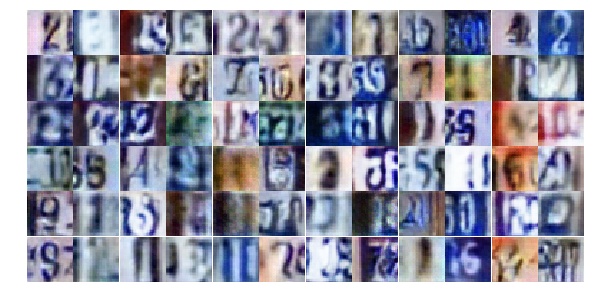

Epoch 12/25... Discriminator Loss: 0.3277... Generator Loss: 2.0741
Epoch 12/25... Discriminator Loss: 0.4370... Generator Loss: 1.7848
Epoch 12/25... Discriminator Loss: 0.6740... Generator Loss: 1.1260
Epoch 12/25... Discriminator Loss: 0.5744... Generator Loss: 1.1881
Epoch 12/25... Discriminator Loss: 0.3836... Generator Loss: 1.9007
Epoch 12/25... Discriminator Loss: 0.4567... Generator Loss: 1.5316
Epoch 12/25... Discriminator Loss: 0.5791... Generator Loss: 1.2807
Epoch 12/25... Discriminator Loss: 0.3443... Generator Loss: 1.7683
Epoch 12/25... Discriminator Loss: 0.6456... Generator Loss: 1.2214
Epoch 12/25... Discriminator Loss: 0.6392... Generator Loss: 1.2470


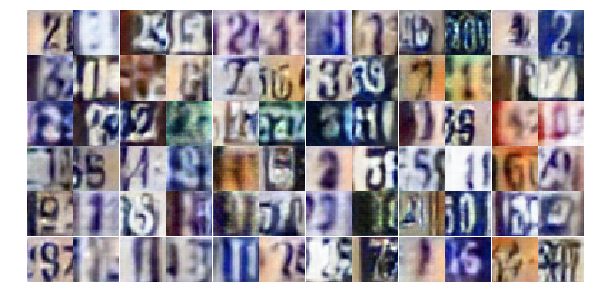

Epoch 12/25... Discriminator Loss: 0.5003... Generator Loss: 1.3035
Epoch 12/25... Discriminator Loss: 0.8198... Generator Loss: 0.9461
Epoch 12/25... Discriminator Loss: 0.8536... Generator Loss: 0.7220
Epoch 12/25... Discriminator Loss: 1.9855... Generator Loss: 0.2068
Epoch 12/25... Discriminator Loss: 0.5103... Generator Loss: 2.4117
Epoch 12/25... Discriminator Loss: 0.8030... Generator Loss: 0.8971
Epoch 12/25... Discriminator Loss: 0.9647... Generator Loss: 0.6526
Epoch 12/25... Discriminator Loss: 0.7746... Generator Loss: 0.9569
Epoch 12/25... Discriminator Loss: 0.5305... Generator Loss: 1.2699
Epoch 12/25... Discriminator Loss: 0.3072... Generator Loss: 1.8473


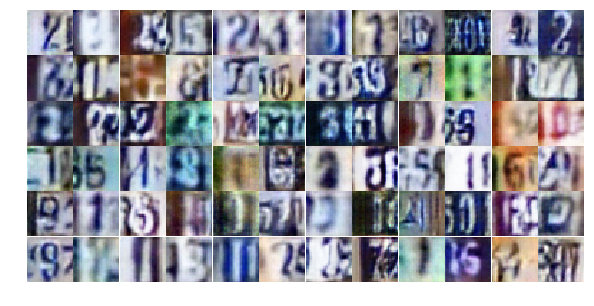

Epoch 12/25... Discriminator Loss: 0.6119... Generator Loss: 1.1050
Epoch 12/25... Discriminator Loss: 0.3361... Generator Loss: 1.7058
Epoch 12/25... Discriminator Loss: 0.3423... Generator Loss: 1.7680
Epoch 12/25... Discriminator Loss: 0.9276... Generator Loss: 0.8186
Epoch 12/25... Discriminator Loss: 1.2403... Generator Loss: 0.5777
Epoch 12/25... Discriminator Loss: 1.3589... Generator Loss: 0.4661
Epoch 12/25... Discriminator Loss: 0.8761... Generator Loss: 0.7614
Epoch 12/25... Discriminator Loss: 1.0114... Generator Loss: 0.6402
Epoch 12/25... Discriminator Loss: 0.6587... Generator Loss: 1.2987
Epoch 12/25... Discriminator Loss: 0.5948... Generator Loss: 1.0558


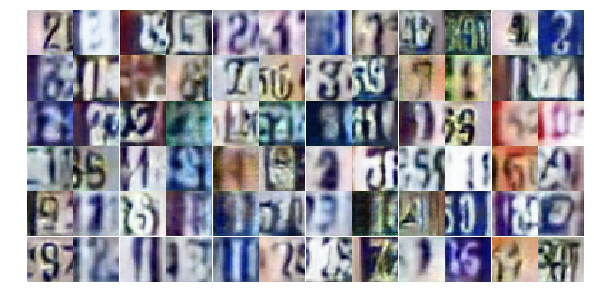

Epoch 12/25... Discriminator Loss: 0.9446... Generator Loss: 0.7912
Epoch 12/25... Discriminator Loss: 0.6598... Generator Loss: 1.1671
Epoch 12/25... Discriminator Loss: 0.6043... Generator Loss: 1.2440
Epoch 12/25... Discriminator Loss: 0.8547... Generator Loss: 0.8852
Epoch 12/25... Discriminator Loss: 0.5234... Generator Loss: 1.2150
Epoch 12/25... Discriminator Loss: 0.8885... Generator Loss: 2.3648
Epoch 12/25... Discriminator Loss: 0.7842... Generator Loss: 1.0573
Epoch 13/25... Discriminator Loss: 0.3836... Generator Loss: 2.0593
Epoch 13/25... Discriminator Loss: 0.4446... Generator Loss: 1.4150
Epoch 13/25... Discriminator Loss: 0.6345... Generator Loss: 1.1391


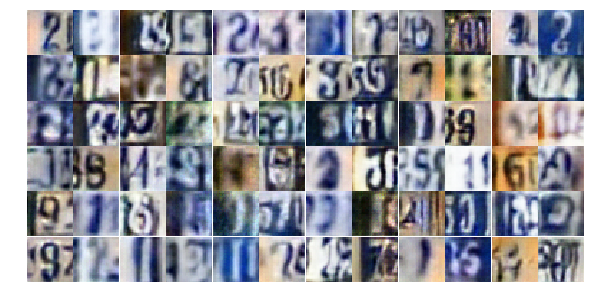

Epoch 13/25... Discriminator Loss: 0.5368... Generator Loss: 1.3979
Epoch 13/25... Discriminator Loss: 0.5341... Generator Loss: 2.1176
Epoch 13/25... Discriminator Loss: 1.4714... Generator Loss: 0.3893
Epoch 13/25... Discriminator Loss: 0.9847... Generator Loss: 0.7604
Epoch 13/25... Discriminator Loss: 0.6417... Generator Loss: 1.0890
Epoch 13/25... Discriminator Loss: 0.4358... Generator Loss: 1.7695
Epoch 13/25... Discriminator Loss: 0.3935... Generator Loss: 1.7317
Epoch 13/25... Discriminator Loss: 0.5542... Generator Loss: 1.1799
Epoch 13/25... Discriminator Loss: 0.5374... Generator Loss: 1.2275
Epoch 13/25... Discriminator Loss: 0.5105... Generator Loss: 1.6108


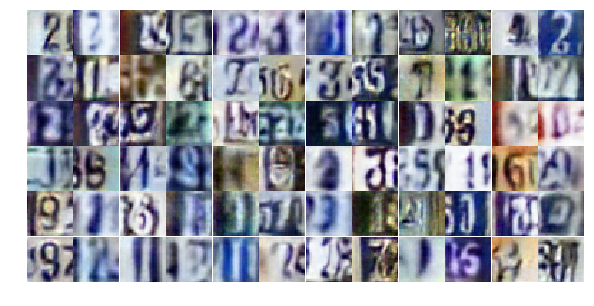

Epoch 13/25... Discriminator Loss: 0.6093... Generator Loss: 1.2173
Epoch 13/25... Discriminator Loss: 0.5020... Generator Loss: 1.5239
Epoch 13/25... Discriminator Loss: 1.0558... Generator Loss: 0.6438
Epoch 13/25... Discriminator Loss: 0.7785... Generator Loss: 0.8676
Epoch 13/25... Discriminator Loss: 0.5422... Generator Loss: 2.0662
Epoch 13/25... Discriminator Loss: 0.6844... Generator Loss: 1.1287
Epoch 13/25... Discriminator Loss: 0.7991... Generator Loss: 0.9662
Epoch 13/25... Discriminator Loss: 1.0273... Generator Loss: 0.6247
Epoch 13/25... Discriminator Loss: 0.5419... Generator Loss: 1.3749
Epoch 13/25... Discriminator Loss: 1.3046... Generator Loss: 0.4546


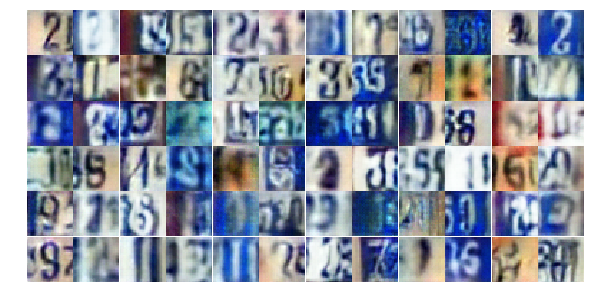

Epoch 13/25... Discriminator Loss: 0.8573... Generator Loss: 0.7594
Epoch 13/25... Discriminator Loss: 0.3633... Generator Loss: 1.8751
Epoch 13/25... Discriminator Loss: 0.7892... Generator Loss: 0.8827
Epoch 13/25... Discriminator Loss: 0.5887... Generator Loss: 2.2176
Epoch 13/25... Discriminator Loss: 0.5452... Generator Loss: 1.4853
Epoch 13/25... Discriminator Loss: 0.5178... Generator Loss: 1.4513
Epoch 13/25... Discriminator Loss: 1.3189... Generator Loss: 2.4643
Epoch 13/25... Discriminator Loss: 0.5824... Generator Loss: 1.2313
Epoch 13/25... Discriminator Loss: 0.5883... Generator Loss: 1.1278
Epoch 13/25... Discriminator Loss: 0.4608... Generator Loss: 1.6019


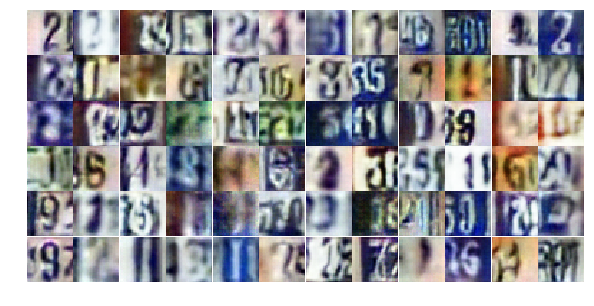

Epoch 13/25... Discriminator Loss: 1.1052... Generator Loss: 0.5203
Epoch 13/25... Discriminator Loss: 0.7206... Generator Loss: 1.9194
Epoch 13/25... Discriminator Loss: 1.2686... Generator Loss: 0.4816
Epoch 13/25... Discriminator Loss: 1.2545... Generator Loss: 0.4968
Epoch 13/25... Discriminator Loss: 0.5259... Generator Loss: 1.2992
Epoch 13/25... Discriminator Loss: 0.4841... Generator Loss: 1.4628
Epoch 13/25... Discriminator Loss: 0.4501... Generator Loss: 1.5543
Epoch 13/25... Discriminator Loss: 0.8519... Generator Loss: 0.8469
Epoch 13/25... Discriminator Loss: 0.7269... Generator Loss: 0.9633
Epoch 13/25... Discriminator Loss: 0.7302... Generator Loss: 0.9281


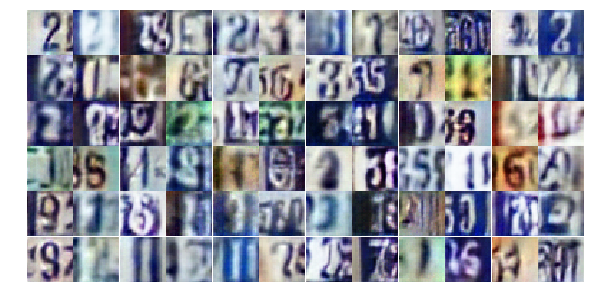

Epoch 13/25... Discriminator Loss: 0.4976... Generator Loss: 1.8067
Epoch 13/25... Discriminator Loss: 0.7032... Generator Loss: 2.3586
Epoch 13/25... Discriminator Loss: 0.9601... Generator Loss: 0.7681
Epoch 13/25... Discriminator Loss: 0.6626... Generator Loss: 1.7116
Epoch 13/25... Discriminator Loss: 0.9052... Generator Loss: 0.7476
Epoch 13/25... Discriminator Loss: 0.6328... Generator Loss: 1.1980
Epoch 13/25... Discriminator Loss: 0.8680... Generator Loss: 0.7816
Epoch 13/25... Discriminator Loss: 0.4710... Generator Loss: 1.3947
Epoch 13/25... Discriminator Loss: 0.7249... Generator Loss: 0.9480
Epoch 13/25... Discriminator Loss: 1.0781... Generator Loss: 0.6059


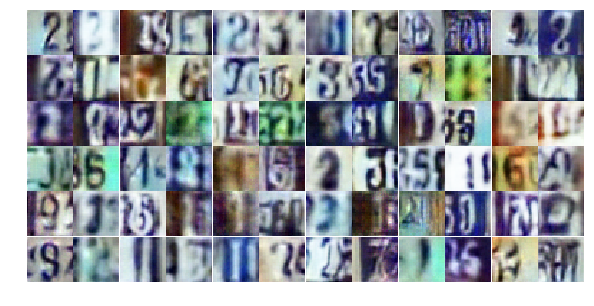

Epoch 13/25... Discriminator Loss: 0.3867... Generator Loss: 1.8956
Epoch 13/25... Discriminator Loss: 1.0305... Generator Loss: 0.5999
Epoch 13/25... Discriminator Loss: 0.7131... Generator Loss: 0.9292
Epoch 13/25... Discriminator Loss: 0.6271... Generator Loss: 1.0301
Epoch 14/25... Discriminator Loss: 0.5707... Generator Loss: 1.1232
Epoch 14/25... Discriminator Loss: 0.4811... Generator Loss: 1.3164
Epoch 14/25... Discriminator Loss: 0.6610... Generator Loss: 1.4904
Epoch 14/25... Discriminator Loss: 0.5340... Generator Loss: 2.0218
Epoch 14/25... Discriminator Loss: 0.5920... Generator Loss: 1.1603
Epoch 14/25... Discriminator Loss: 0.7112... Generator Loss: 0.9260


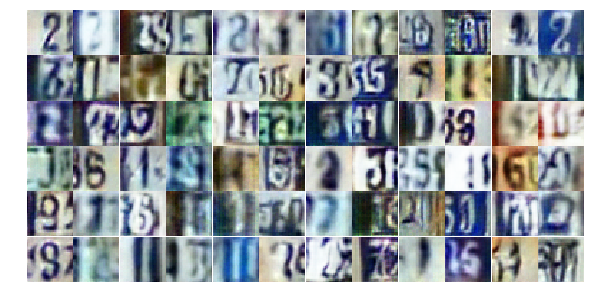

Epoch 14/25... Discriminator Loss: 0.8496... Generator Loss: 2.0650
Epoch 14/25... Discriminator Loss: 0.5785... Generator Loss: 1.1784
Epoch 14/25... Discriminator Loss: 0.7282... Generator Loss: 0.9171
Epoch 14/25... Discriminator Loss: 0.6463... Generator Loss: 1.1367
Epoch 14/25... Discriminator Loss: 1.1432... Generator Loss: 0.5700
Epoch 14/25... Discriminator Loss: 0.3794... Generator Loss: 1.4487
Epoch 14/25... Discriminator Loss: 0.2248... Generator Loss: 2.2548
Epoch 14/25... Discriminator Loss: 1.5848... Generator Loss: 0.3139
Epoch 14/25... Discriminator Loss: 1.6535... Generator Loss: 0.3082
Epoch 14/25... Discriminator Loss: 1.7392... Generator Loss: 0.3021


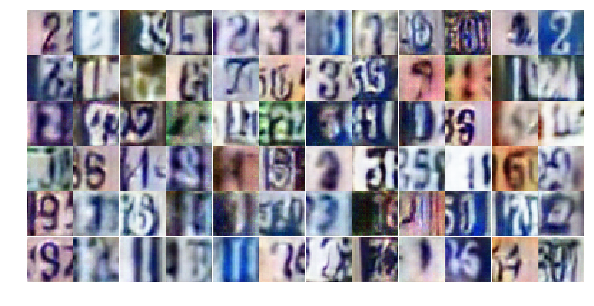

Epoch 14/25... Discriminator Loss: 0.5685... Generator Loss: 1.2275
Epoch 14/25... Discriminator Loss: 0.3162... Generator Loss: 2.0498
Epoch 14/25... Discriminator Loss: 0.8767... Generator Loss: 1.0761
Epoch 14/25... Discriminator Loss: 0.3706... Generator Loss: 1.7716
Epoch 14/25... Discriminator Loss: 0.9064... Generator Loss: 0.7000
Epoch 14/25... Discriminator Loss: 0.9921... Generator Loss: 0.6971
Epoch 14/25... Discriminator Loss: 0.7337... Generator Loss: 0.9382
Epoch 14/25... Discriminator Loss: 0.8120... Generator Loss: 0.8122
Epoch 14/25... Discriminator Loss: 0.6841... Generator Loss: 0.9789
Epoch 14/25... Discriminator Loss: 0.5711... Generator Loss: 1.8856


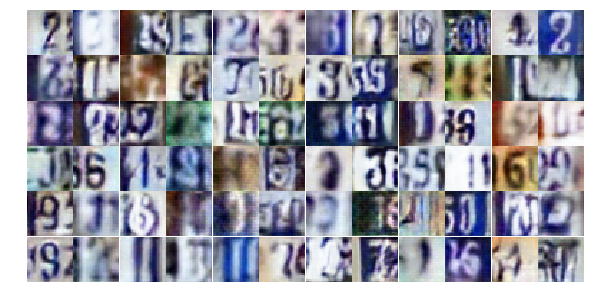

Epoch 14/25... Discriminator Loss: 1.1058... Generator Loss: 0.5784
Epoch 14/25... Discriminator Loss: 0.4011... Generator Loss: 1.6285
Epoch 14/25... Discriminator Loss: 0.4285... Generator Loss: 1.4045
Epoch 14/25... Discriminator Loss: 0.5862... Generator Loss: 1.1765
Epoch 14/25... Discriminator Loss: 0.6299... Generator Loss: 1.4337
Epoch 14/25... Discriminator Loss: 1.1063... Generator Loss: 0.5897
Epoch 14/25... Discriminator Loss: 0.8649... Generator Loss: 0.7853
Epoch 14/25... Discriminator Loss: 0.4291... Generator Loss: 1.4857
Epoch 14/25... Discriminator Loss: 0.5017... Generator Loss: 2.0640
Epoch 14/25... Discriminator Loss: 0.8485... Generator Loss: 0.8127


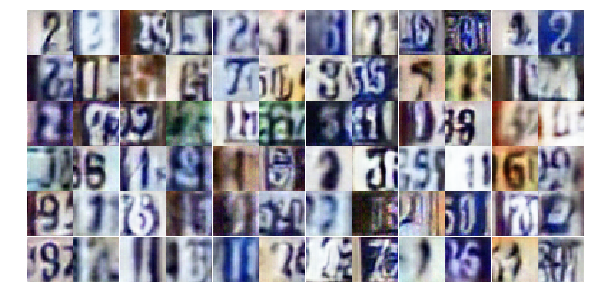

Epoch 14/25... Discriminator Loss: 1.0367... Generator Loss: 0.6626
Epoch 14/25... Discriminator Loss: 0.6790... Generator Loss: 1.7784
Epoch 14/25... Discriminator Loss: 1.4033... Generator Loss: 0.4385
Epoch 14/25... Discriminator Loss: 1.0003... Generator Loss: 0.6694
Epoch 14/25... Discriminator Loss: 0.6490... Generator Loss: 1.0830
Epoch 14/25... Discriminator Loss: 0.7859... Generator Loss: 0.9459
Epoch 14/25... Discriminator Loss: 0.6510... Generator Loss: 1.3011
Epoch 14/25... Discriminator Loss: 0.5087... Generator Loss: 1.3081
Epoch 14/25... Discriminator Loss: 1.5339... Generator Loss: 1.4681
Epoch 14/25... Discriminator Loss: 1.2204... Generator Loss: 0.5357


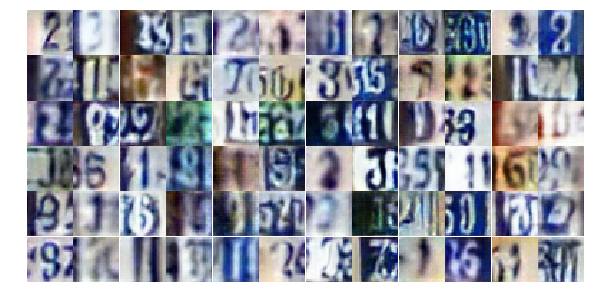

Epoch 14/25... Discriminator Loss: 0.8361... Generator Loss: 1.4086
Epoch 14/25... Discriminator Loss: 0.8140... Generator Loss: 0.9277
Epoch 14/25... Discriminator Loss: 0.5584... Generator Loss: 1.2040
Epoch 14/25... Discriminator Loss: 0.6580... Generator Loss: 1.1348
Epoch 14/25... Discriminator Loss: 0.8598... Generator Loss: 0.8116
Epoch 14/25... Discriminator Loss: 0.4995... Generator Loss: 1.6309
Epoch 14/25... Discriminator Loss: 0.5454... Generator Loss: 1.6697
Epoch 14/25... Discriminator Loss: 0.6684... Generator Loss: 1.1111
Epoch 14/25... Discriminator Loss: 0.7323... Generator Loss: 1.1233
Epoch 14/25... Discriminator Loss: 1.0975... Generator Loss: 0.5379


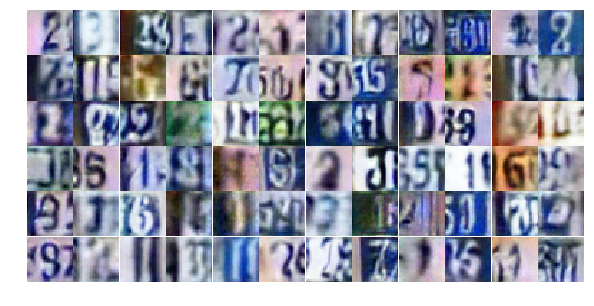

Epoch 14/25... Discriminator Loss: 1.1599... Generator Loss: 2.7164
Epoch 14/25... Discriminator Loss: 0.9529... Generator Loss: 0.6971
Epoch 15/25... Discriminator Loss: 0.6056... Generator Loss: 1.0984
Epoch 15/25... Discriminator Loss: 0.3756... Generator Loss: 2.3295
Epoch 15/25... Discriminator Loss: 0.5721... Generator Loss: 1.3456
Epoch 15/25... Discriminator Loss: 1.1343... Generator Loss: 0.5641
Epoch 15/25... Discriminator Loss: 0.8210... Generator Loss: 0.8003
Epoch 15/25... Discriminator Loss: 0.5457... Generator Loss: 1.3440
Epoch 15/25... Discriminator Loss: 8.9623... Generator Loss: 0.0016
Epoch 15/25... Discriminator Loss: 1.1297... Generator Loss: 1.0176


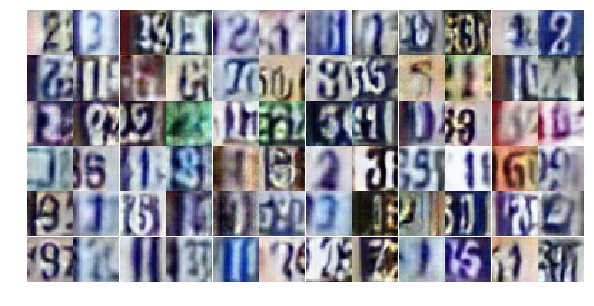

Epoch 15/25... Discriminator Loss: 1.1293... Generator Loss: 1.2550
Epoch 15/25... Discriminator Loss: 0.9588... Generator Loss: 1.5920
Epoch 15/25... Discriminator Loss: 0.7687... Generator Loss: 1.2028
Epoch 15/25... Discriminator Loss: 0.7748... Generator Loss: 0.9542
Epoch 15/25... Discriminator Loss: 1.0182... Generator Loss: 0.7070
Epoch 15/25... Discriminator Loss: 0.7144... Generator Loss: 1.0169
Epoch 15/25... Discriminator Loss: 0.8775... Generator Loss: 0.7662
Epoch 15/25... Discriminator Loss: 0.7765... Generator Loss: 0.9032
Epoch 15/25... Discriminator Loss: 0.8538... Generator Loss: 3.2022
Epoch 15/25... Discriminator Loss: 1.0807... Generator Loss: 0.6458


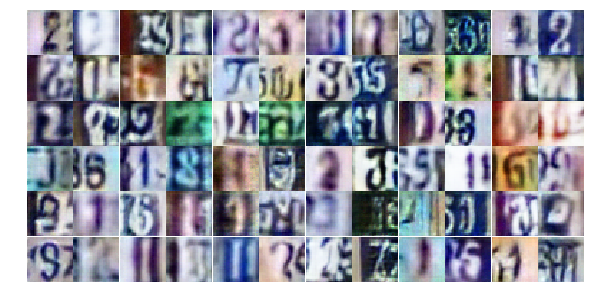

Epoch 15/25... Discriminator Loss: 0.8877... Generator Loss: 1.2228
Epoch 15/25... Discriminator Loss: 0.8210... Generator Loss: 0.7678
Epoch 15/25... Discriminator Loss: 0.5253... Generator Loss: 1.4403
Epoch 15/25... Discriminator Loss: 0.7008... Generator Loss: 1.1632
Epoch 15/25... Discriminator Loss: 1.0000... Generator Loss: 0.7727
Epoch 15/25... Discriminator Loss: 0.7063... Generator Loss: 0.9710
Epoch 15/25... Discriminator Loss: 0.6573... Generator Loss: 1.0931
Epoch 15/25... Discriminator Loss: 0.6301... Generator Loss: 1.1364
Epoch 15/25... Discriminator Loss: 0.5173... Generator Loss: 1.2700
Epoch 15/25... Discriminator Loss: 1.0583... Generator Loss: 0.6686


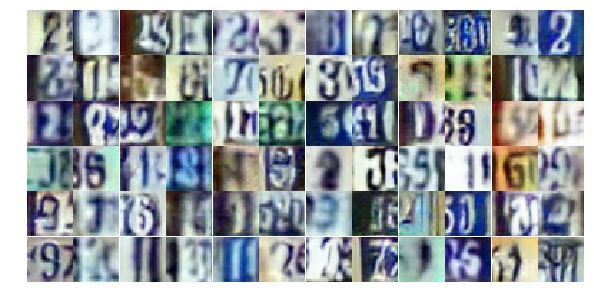

Epoch 15/25... Discriminator Loss: 0.6161... Generator Loss: 1.3027
Epoch 15/25... Discriminator Loss: 0.6551... Generator Loss: 1.2185
Epoch 15/25... Discriminator Loss: 0.5725... Generator Loss: 1.1541
Epoch 15/25... Discriminator Loss: 0.7328... Generator Loss: 0.9438
Epoch 15/25... Discriminator Loss: 0.7510... Generator Loss: 0.8395
Epoch 15/25... Discriminator Loss: 0.6941... Generator Loss: 1.9046
Epoch 15/25... Discriminator Loss: 0.5568... Generator Loss: 1.0729
Epoch 15/25... Discriminator Loss: 0.6014... Generator Loss: 1.1098
Epoch 15/25... Discriminator Loss: 0.4842... Generator Loss: 1.5416
Epoch 15/25... Discriminator Loss: 0.7944... Generator Loss: 0.8973


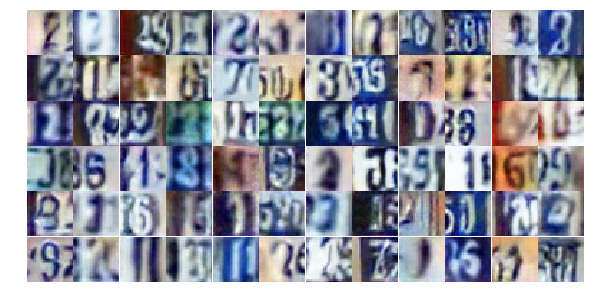

Epoch 15/25... Discriminator Loss: 0.5503... Generator Loss: 1.3972
Epoch 15/25... Discriminator Loss: 1.5374... Generator Loss: 0.3484
Epoch 15/25... Discriminator Loss: 0.7125... Generator Loss: 0.9571
Epoch 15/25... Discriminator Loss: 0.4864... Generator Loss: 1.3377
Epoch 15/25... Discriminator Loss: 0.7125... Generator Loss: 0.8553
Epoch 15/25... Discriminator Loss: 1.5175... Generator Loss: 0.3505
Epoch 15/25... Discriminator Loss: 0.6497... Generator Loss: 1.0605
Epoch 15/25... Discriminator Loss: 0.8253... Generator Loss: 1.1695
Epoch 15/25... Discriminator Loss: 0.6175... Generator Loss: 1.0757
Epoch 15/25... Discriminator Loss: 0.9086... Generator Loss: 0.7912


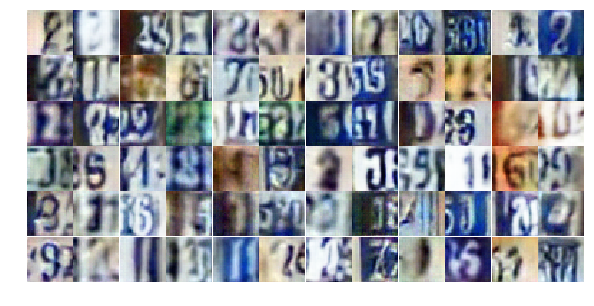

Epoch 15/25... Discriminator Loss: 1.1356... Generator Loss: 0.5452
Epoch 15/25... Discriminator Loss: 0.6921... Generator Loss: 1.2032
Epoch 15/25... Discriminator Loss: 0.4459... Generator Loss: 1.5515
Epoch 15/25... Discriminator Loss: 1.5350... Generator Loss: 0.4013
Epoch 15/25... Discriminator Loss: 1.0617... Generator Loss: 1.1332
Epoch 15/25... Discriminator Loss: 1.0381... Generator Loss: 0.5972
Epoch 15/25... Discriminator Loss: 1.2777... Generator Loss: 0.4743
Epoch 15/25... Discriminator Loss: 0.7011... Generator Loss: 1.0639
Epoch 15/25... Discriminator Loss: 1.2223... Generator Loss: 0.5426
Epoch 16/25... Discriminator Loss: 0.8410... Generator Loss: 0.8651


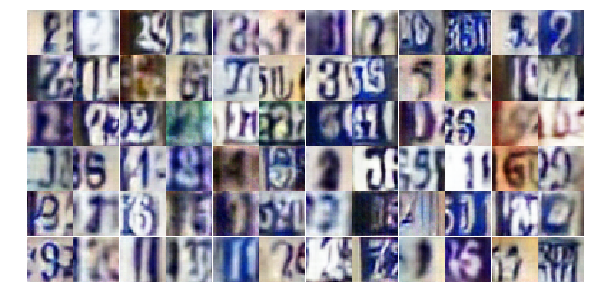

Epoch 16/25... Discriminator Loss: 0.5115... Generator Loss: 1.4190
Epoch 16/25... Discriminator Loss: 0.7630... Generator Loss: 0.9642
Epoch 16/25... Discriminator Loss: 1.0373... Generator Loss: 0.6537
Epoch 16/25... Discriminator Loss: 0.6047... Generator Loss: 1.4959
Epoch 16/25... Discriminator Loss: 0.4137... Generator Loss: 2.1475
Epoch 16/25... Discriminator Loss: 0.6161... Generator Loss: 1.7769
Epoch 16/25... Discriminator Loss: 1.8058... Generator Loss: 0.3185
Epoch 16/25... Discriminator Loss: 1.0370... Generator Loss: 0.5788
Epoch 16/25... Discriminator Loss: 0.8208... Generator Loss: 0.8142
Epoch 16/25... Discriminator Loss: 0.6414... Generator Loss: 0.9991


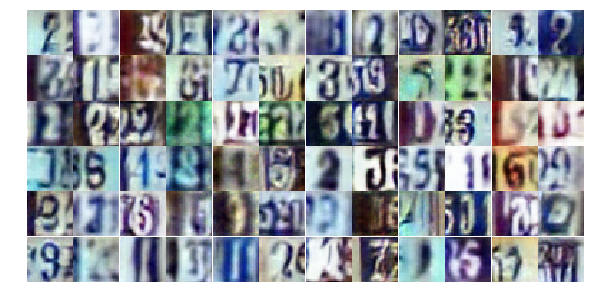

Epoch 16/25... Discriminator Loss: 1.1912... Generator Loss: 0.5181
Epoch 16/25... Discriminator Loss: 0.7337... Generator Loss: 0.9497
Epoch 16/25... Discriminator Loss: 0.6430... Generator Loss: 1.3121
Epoch 16/25... Discriminator Loss: 1.2427... Generator Loss: 0.4979
Epoch 16/25... Discriminator Loss: 1.6916... Generator Loss: 1.9807
Epoch 16/25... Discriminator Loss: 1.4705... Generator Loss: 0.3795
Epoch 16/25... Discriminator Loss: 1.2097... Generator Loss: 0.4901
Epoch 16/25... Discriminator Loss: 0.4196... Generator Loss: 1.7514
Epoch 16/25... Discriminator Loss: 0.5544... Generator Loss: 1.3232
Epoch 16/25... Discriminator Loss: 0.7988... Generator Loss: 0.9256


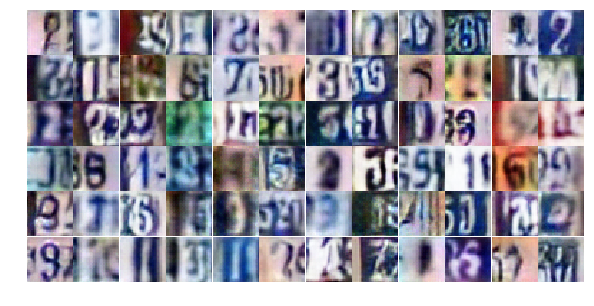

Epoch 16/25... Discriminator Loss: 0.7007... Generator Loss: 1.0974
Epoch 16/25... Discriminator Loss: 0.7477... Generator Loss: 0.9512
Epoch 16/25... Discriminator Loss: 0.8437... Generator Loss: 0.7585
Epoch 16/25... Discriminator Loss: 1.1021... Generator Loss: 0.5704
Epoch 16/25... Discriminator Loss: 0.7077... Generator Loss: 0.9511
Epoch 16/25... Discriminator Loss: 0.7507... Generator Loss: 0.9354
Epoch 16/25... Discriminator Loss: 0.8601... Generator Loss: 0.7957
Epoch 16/25... Discriminator Loss: 0.4681... Generator Loss: 1.3378
Epoch 16/25... Discriminator Loss: 1.3207... Generator Loss: 0.4698
Epoch 16/25... Discriminator Loss: 0.6663... Generator Loss: 1.0167


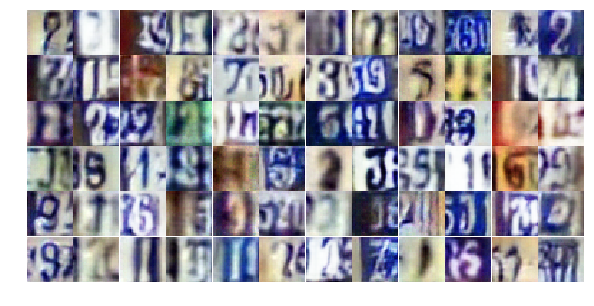

Epoch 16/25... Discriminator Loss: 0.4648... Generator Loss: 1.3835
Epoch 16/25... Discriminator Loss: 0.7749... Generator Loss: 0.8774
Epoch 16/25... Discriminator Loss: 0.5292... Generator Loss: 1.3038
Epoch 16/25... Discriminator Loss: 0.8153... Generator Loss: 0.8696
Epoch 16/25... Discriminator Loss: 0.8509... Generator Loss: 2.3756
Epoch 16/25... Discriminator Loss: 0.6314... Generator Loss: 1.3504
Epoch 16/25... Discriminator Loss: 0.9386... Generator Loss: 0.6616
Epoch 16/25... Discriminator Loss: 1.1445... Generator Loss: 0.5423
Epoch 16/25... Discriminator Loss: 0.6145... Generator Loss: 1.1959
Epoch 16/25... Discriminator Loss: 0.5178... Generator Loss: 1.3346


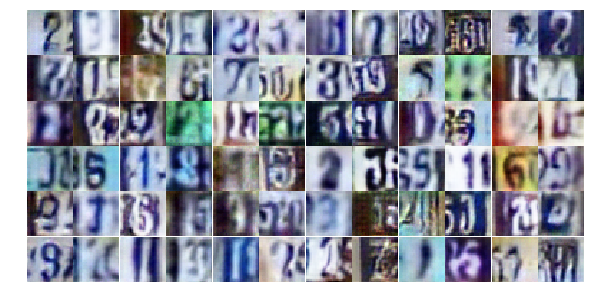

Epoch 16/25... Discriminator Loss: 0.5736... Generator Loss: 1.2432
Epoch 16/25... Discriminator Loss: 0.5971... Generator Loss: 1.3819
Epoch 16/25... Discriminator Loss: 1.1531... Generator Loss: 0.5571
Epoch 16/25... Discriminator Loss: 0.8198... Generator Loss: 1.0329
Epoch 16/25... Discriminator Loss: 1.0808... Generator Loss: 0.6063
Epoch 16/25... Discriminator Loss: 1.5274... Generator Loss: 0.3825
Epoch 16/25... Discriminator Loss: 0.4220... Generator Loss: 1.5966
Epoch 16/25... Discriminator Loss: 0.6295... Generator Loss: 1.2393
Epoch 16/25... Discriminator Loss: 0.5468... Generator Loss: 1.1094
Epoch 16/25... Discriminator Loss: 0.8527... Generator Loss: 0.7411


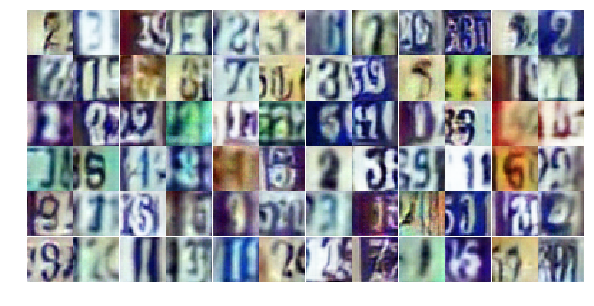

Epoch 16/25... Discriminator Loss: 0.9329... Generator Loss: 0.8394
Epoch 16/25... Discriminator Loss: 0.6144... Generator Loss: 1.7011
Epoch 16/25... Discriminator Loss: 2.0942... Generator Loss: 0.3003
Epoch 16/25... Discriminator Loss: 0.4145... Generator Loss: 2.2599
Epoch 16/25... Discriminator Loss: 0.4481... Generator Loss: 1.9961
Epoch 16/25... Discriminator Loss: 0.6768... Generator Loss: 1.0526
Epoch 17/25... Discriminator Loss: 0.5586... Generator Loss: 1.3184
Epoch 17/25... Discriminator Loss: 0.8698... Generator Loss: 0.7476
Epoch 17/25... Discriminator Loss: 0.6479... Generator Loss: 1.2051
Epoch 17/25... Discriminator Loss: 0.7733... Generator Loss: 0.8577


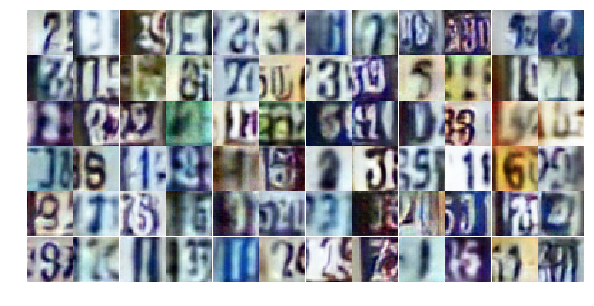

Epoch 17/25... Discriminator Loss: 0.4264... Generator Loss: 1.6428
Epoch 17/25... Discriminator Loss: 0.7131... Generator Loss: 0.8527
Epoch 17/25... Discriminator Loss: 0.8518... Generator Loss: 0.8523
Epoch 17/25... Discriminator Loss: 0.6458... Generator Loss: 1.0064
Epoch 17/25... Discriminator Loss: 1.1597... Generator Loss: 0.5389
Epoch 17/25... Discriminator Loss: 1.0444... Generator Loss: 0.5961
Epoch 17/25... Discriminator Loss: 0.8893... Generator Loss: 0.9495
Epoch 17/25... Discriminator Loss: 0.6949... Generator Loss: 0.9978
Epoch 17/25... Discriminator Loss: 0.4790... Generator Loss: 1.4463
Epoch 17/25... Discriminator Loss: 0.6537... Generator Loss: 1.1732


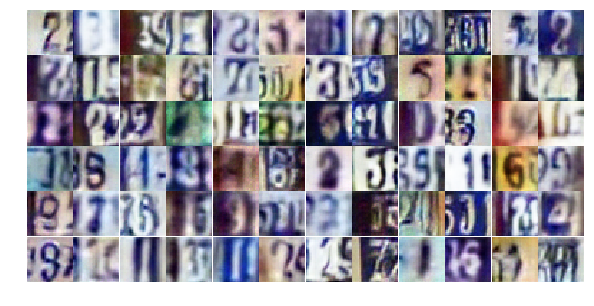

Epoch 17/25... Discriminator Loss: 0.7526... Generator Loss: 1.3051
Epoch 17/25... Discriminator Loss: 0.6422... Generator Loss: 1.2457
Epoch 17/25... Discriminator Loss: 0.7918... Generator Loss: 0.9280
Epoch 17/25... Discriminator Loss: 1.0121... Generator Loss: 1.3871
Epoch 17/25... Discriminator Loss: 0.7029... Generator Loss: 1.0834
Epoch 17/25... Discriminator Loss: 1.1874... Generator Loss: 0.5079
Epoch 17/25... Discriminator Loss: 0.5777... Generator Loss: 1.2541
Epoch 17/25... Discriminator Loss: 0.5147... Generator Loss: 1.4620
Epoch 17/25... Discriminator Loss: 0.4983... Generator Loss: 1.3549
Epoch 17/25... Discriminator Loss: 0.6624... Generator Loss: 1.0523


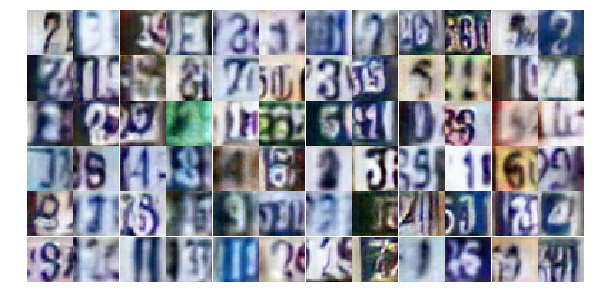

Epoch 17/25... Discriminator Loss: 1.7475... Generator Loss: 0.2625
Epoch 17/25... Discriminator Loss: 0.5374... Generator Loss: 1.7100
Epoch 17/25... Discriminator Loss: 0.4691... Generator Loss: 1.5494
Epoch 17/25... Discriminator Loss: 0.9807... Generator Loss: 0.6900
Epoch 17/25... Discriminator Loss: 1.4387... Generator Loss: 0.3674
Epoch 17/25... Discriminator Loss: 0.5496... Generator Loss: 1.1807
Epoch 17/25... Discriminator Loss: 0.8997... Generator Loss: 0.7266
Epoch 17/25... Discriminator Loss: 1.0472... Generator Loss: 0.6286
Epoch 17/25... Discriminator Loss: 1.4569... Generator Loss: 0.3682
Epoch 17/25... Discriminator Loss: 0.3892... Generator Loss: 1.6892


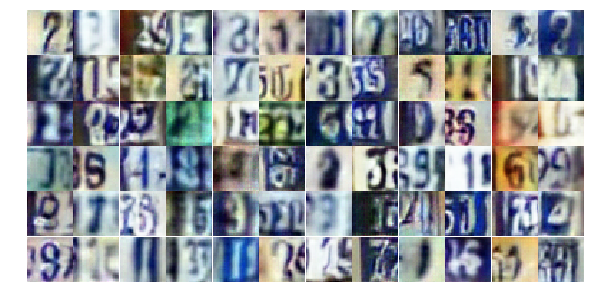

Epoch 17/25... Discriminator Loss: 1.0788... Generator Loss: 0.5969
Epoch 17/25... Discriminator Loss: 1.0245... Generator Loss: 0.6405
Epoch 17/25... Discriminator Loss: 0.5726... Generator Loss: 1.2746
Epoch 17/25... Discriminator Loss: 0.6253... Generator Loss: 1.6745
Epoch 17/25... Discriminator Loss: 0.6477... Generator Loss: 1.1312
Epoch 17/25... Discriminator Loss: 0.6865... Generator Loss: 1.3546
Epoch 17/25... Discriminator Loss: 0.6974... Generator Loss: 1.1721
Epoch 17/25... Discriminator Loss: 0.7229... Generator Loss: 0.9822
Epoch 17/25... Discriminator Loss: 0.3845... Generator Loss: 1.9308
Epoch 17/25... Discriminator Loss: 0.9152... Generator Loss: 0.7373


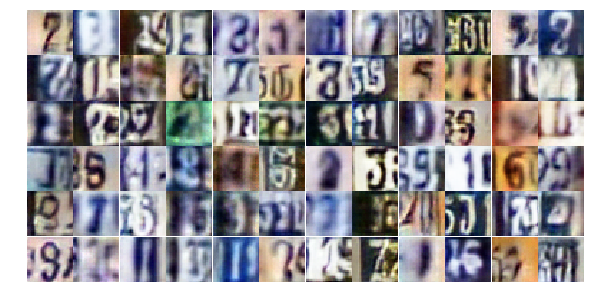

Epoch 17/25... Discriminator Loss: 2.0071... Generator Loss: 0.5787
Epoch 17/25... Discriminator Loss: 0.4892... Generator Loss: 1.4248
Epoch 17/25... Discriminator Loss: 0.8552... Generator Loss: 0.7675
Epoch 17/25... Discriminator Loss: 0.4676... Generator Loss: 1.4577
Epoch 17/25... Discriminator Loss: 0.9717... Generator Loss: 0.6647
Epoch 17/25... Discriminator Loss: 1.0822... Generator Loss: 0.5576
Epoch 17/25... Discriminator Loss: 1.1913... Generator Loss: 0.5424
Epoch 17/25... Discriminator Loss: 0.6961... Generator Loss: 0.9466
Epoch 17/25... Discriminator Loss: 0.5417... Generator Loss: 1.5227
Epoch 17/25... Discriminator Loss: 1.1517... Generator Loss: 0.5892


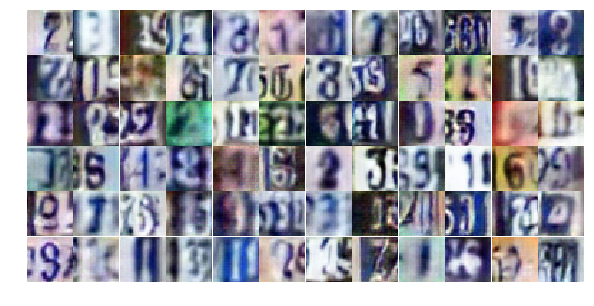

Epoch 17/25... Discriminator Loss: 0.7119... Generator Loss: 1.1296
Epoch 17/25... Discriminator Loss: 0.9515... Generator Loss: 2.4143
Epoch 17/25... Discriminator Loss: 0.5253... Generator Loss: 1.3362
Epoch 17/25... Discriminator Loss: 0.5460... Generator Loss: 1.3686
Epoch 18/25... Discriminator Loss: 1.0113... Generator Loss: 0.6084
Epoch 18/25... Discriminator Loss: 0.7632... Generator Loss: 0.9561
Epoch 18/25... Discriminator Loss: 0.9404... Generator Loss: 0.7191
Epoch 18/25... Discriminator Loss: 0.7691... Generator Loss: 1.5748
Epoch 18/25... Discriminator Loss: 1.1760... Generator Loss: 0.5812
Epoch 18/25... Discriminator Loss: 0.9131... Generator Loss: 0.7993


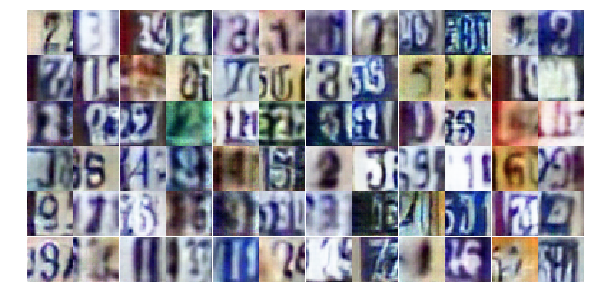

Epoch 18/25... Discriminator Loss: 0.5007... Generator Loss: 1.8470
Epoch 18/25... Discriminator Loss: 1.2589... Generator Loss: 0.4619
Epoch 18/25... Discriminator Loss: 1.0684... Generator Loss: 0.6035
Epoch 18/25... Discriminator Loss: 0.5208... Generator Loss: 1.5123
Epoch 18/25... Discriminator Loss: 0.8010... Generator Loss: 0.7885
Epoch 18/25... Discriminator Loss: 1.1462... Generator Loss: 0.5120
Epoch 18/25... Discriminator Loss: 0.5852... Generator Loss: 1.2303
Epoch 18/25... Discriminator Loss: 0.7343... Generator Loss: 0.9148
Epoch 18/25... Discriminator Loss: 0.6644... Generator Loss: 2.2133
Epoch 18/25... Discriminator Loss: 0.5041... Generator Loss: 1.2931


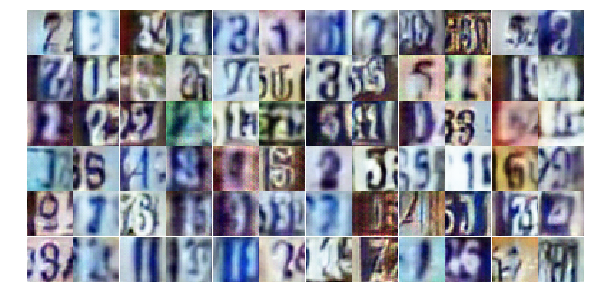

Epoch 18/25... Discriminator Loss: 0.6098... Generator Loss: 1.3423
Epoch 18/25... Discriminator Loss: 0.7175... Generator Loss: 1.0005
Epoch 18/25... Discriminator Loss: 0.7691... Generator Loss: 1.0583
Epoch 18/25... Discriminator Loss: 0.4669... Generator Loss: 1.4113
Epoch 18/25... Discriminator Loss: 0.7766... Generator Loss: 0.8456
Epoch 18/25... Discriminator Loss: 0.8825... Generator Loss: 0.8500
Epoch 18/25... Discriminator Loss: 0.7851... Generator Loss: 1.0401
Epoch 18/25... Discriminator Loss: 0.9450... Generator Loss: 0.7926
Epoch 18/25... Discriminator Loss: 0.7556... Generator Loss: 0.8422
Epoch 18/25... Discriminator Loss: 0.6309... Generator Loss: 1.1013


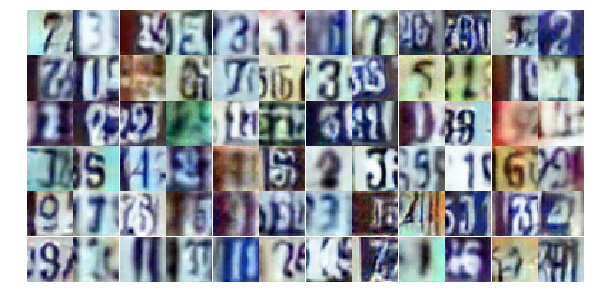

Epoch 18/25... Discriminator Loss: 0.4904... Generator Loss: 1.3668
Epoch 18/25... Discriminator Loss: 0.6733... Generator Loss: 1.5844
Epoch 18/25... Discriminator Loss: 0.8526... Generator Loss: 0.8480
Epoch 18/25... Discriminator Loss: 0.7869... Generator Loss: 0.8594
Epoch 18/25... Discriminator Loss: 1.1802... Generator Loss: 0.5378
Epoch 18/25... Discriminator Loss: 0.5784... Generator Loss: 1.2123
Epoch 18/25... Discriminator Loss: 0.7262... Generator Loss: 0.9266
Epoch 18/25... Discriminator Loss: 0.4231... Generator Loss: 1.7475
Epoch 18/25... Discriminator Loss: 0.6824... Generator Loss: 0.9451
Epoch 18/25... Discriminator Loss: 0.6549... Generator Loss: 1.1919


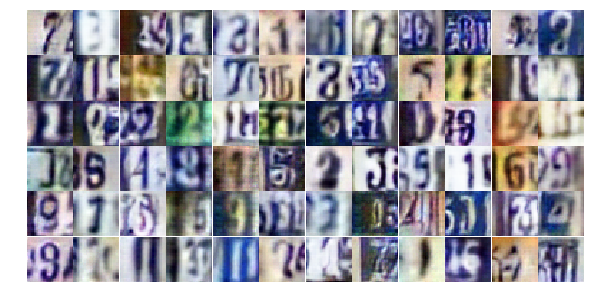

Epoch 18/25... Discriminator Loss: 0.6565... Generator Loss: 1.0840
Epoch 18/25... Discriminator Loss: 0.6580... Generator Loss: 1.0918
Epoch 18/25... Discriminator Loss: 0.6205... Generator Loss: 1.1509
Epoch 18/25... Discriminator Loss: 0.6898... Generator Loss: 1.0100
Epoch 18/25... Discriminator Loss: 1.0976... Generator Loss: 0.6416
Epoch 18/25... Discriminator Loss: 0.3446... Generator Loss: 1.7223
Epoch 18/25... Discriminator Loss: 0.8903... Generator Loss: 0.7606
Epoch 18/25... Discriminator Loss: 1.4188... Generator Loss: 2.9409
Epoch 18/25... Discriminator Loss: 1.0956... Generator Loss: 0.6106
Epoch 18/25... Discriminator Loss: 0.3200... Generator Loss: 1.8879


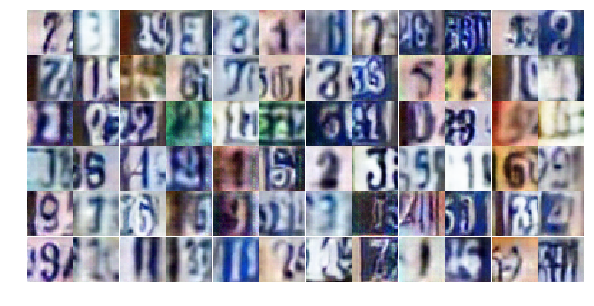

Epoch 18/25... Discriminator Loss: 0.7876... Generator Loss: 0.8339
Epoch 18/25... Discriminator Loss: 0.7175... Generator Loss: 0.9457
Epoch 18/25... Discriminator Loss: 0.9641... Generator Loss: 0.6969
Epoch 18/25... Discriminator Loss: 0.8429... Generator Loss: 0.8238
Epoch 18/25... Discriminator Loss: 0.5356... Generator Loss: 1.5900
Epoch 18/25... Discriminator Loss: 0.5913... Generator Loss: 1.1677
Epoch 18/25... Discriminator Loss: 0.5603... Generator Loss: 1.1202
Epoch 18/25... Discriminator Loss: 0.5692... Generator Loss: 1.3428
Epoch 18/25... Discriminator Loss: 0.9591... Generator Loss: 0.7358
Epoch 18/25... Discriminator Loss: 0.9131... Generator Loss: 0.6839


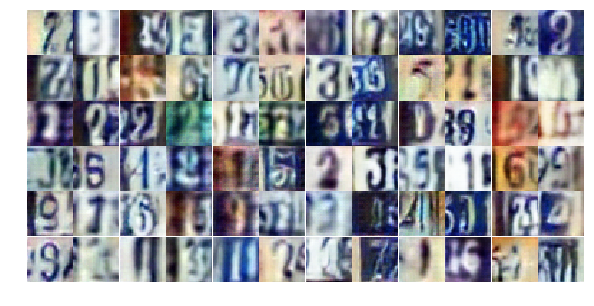

Epoch 18/25... Discriminator Loss: 0.6828... Generator Loss: 1.2683
Epoch 19/25... Discriminator Loss: 1.4354... Generator Loss: 0.3829
Epoch 19/25... Discriminator Loss: 0.7925... Generator Loss: 0.8535
Epoch 19/25... Discriminator Loss: 0.6798... Generator Loss: 1.0765
Epoch 19/25... Discriminator Loss: 0.6375... Generator Loss: 1.1212
Epoch 19/25... Discriminator Loss: 1.2316... Generator Loss: 0.4949
Epoch 19/25... Discriminator Loss: 0.9581... Generator Loss: 0.7906
Epoch 19/25... Discriminator Loss: 0.8945... Generator Loss: 0.7588
Epoch 19/25... Discriminator Loss: 0.5115... Generator Loss: 1.7462
Epoch 19/25... Discriminator Loss: 0.9928... Generator Loss: 0.6526


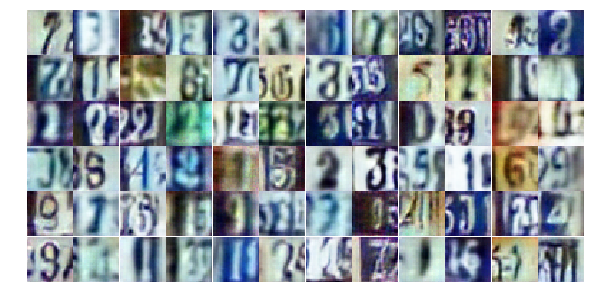

Epoch 19/25... Discriminator Loss: 0.8958... Generator Loss: 0.7277
Epoch 19/25... Discriminator Loss: 0.8730... Generator Loss: 0.7588
Epoch 19/25... Discriminator Loss: 0.5590... Generator Loss: 1.6225
Epoch 19/25... Discriminator Loss: 1.1079... Generator Loss: 0.5749
Epoch 19/25... Discriminator Loss: 0.7169... Generator Loss: 0.9377
Epoch 19/25... Discriminator Loss: 0.7959... Generator Loss: 0.8737
Epoch 19/25... Discriminator Loss: 1.2787... Generator Loss: 0.4348
Epoch 19/25... Discriminator Loss: 0.5625... Generator Loss: 1.2283
Epoch 19/25... Discriminator Loss: 0.6268... Generator Loss: 2.1498
Epoch 19/25... Discriminator Loss: 0.9545... Generator Loss: 0.7788


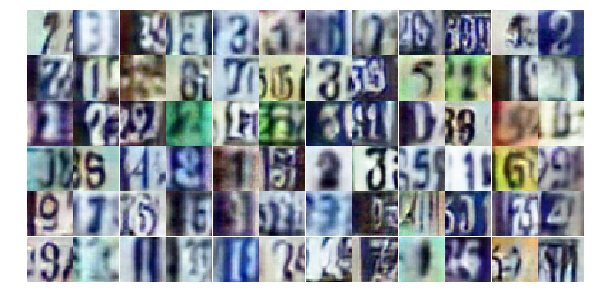

Epoch 19/25... Discriminator Loss: 0.7613... Generator Loss: 0.8904
Epoch 19/25... Discriminator Loss: 1.5720... Generator Loss: 0.3476
Epoch 19/25... Discriminator Loss: 1.2940... Generator Loss: 0.4600
Epoch 19/25... Discriminator Loss: 1.0162... Generator Loss: 0.7840
Epoch 19/25... Discriminator Loss: 0.8760... Generator Loss: 0.8090
Epoch 19/25... Discriminator Loss: 0.8682... Generator Loss: 1.5522
Epoch 19/25... Discriminator Loss: 0.8026... Generator Loss: 0.9061
Epoch 19/25... Discriminator Loss: 0.5809... Generator Loss: 1.1232
Epoch 19/25... Discriminator Loss: 0.5417... Generator Loss: 1.3889
Epoch 19/25... Discriminator Loss: 1.3377... Generator Loss: 0.4320


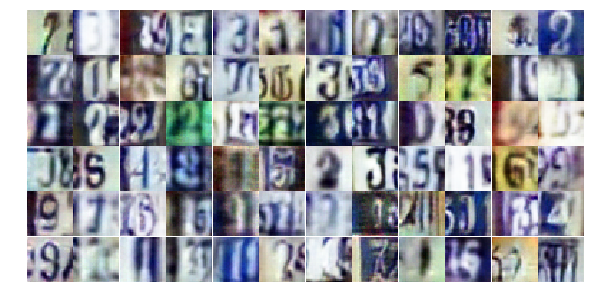

Epoch 19/25... Discriminator Loss: 1.0248... Generator Loss: 0.6640
Epoch 19/25... Discriminator Loss: 0.7486... Generator Loss: 0.9423
Epoch 19/25... Discriminator Loss: 0.7731... Generator Loss: 0.8277
Epoch 19/25... Discriminator Loss: 0.7824... Generator Loss: 0.8669
Epoch 19/25... Discriminator Loss: 0.6708... Generator Loss: 1.0736
Epoch 19/25... Discriminator Loss: 1.2799... Generator Loss: 0.4303
Epoch 19/25... Discriminator Loss: 0.6748... Generator Loss: 1.0560
Epoch 19/25... Discriminator Loss: 0.7081... Generator Loss: 0.9832
Epoch 19/25... Discriminator Loss: 0.7920... Generator Loss: 1.0079
Epoch 19/25... Discriminator Loss: 0.5322... Generator Loss: 1.2106


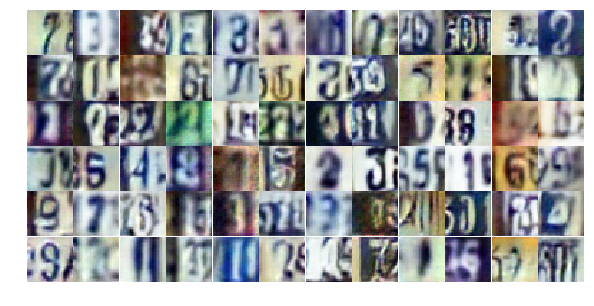

Epoch 19/25... Discriminator Loss: 0.5762... Generator Loss: 1.0687
Epoch 19/25... Discriminator Loss: 1.1462... Generator Loss: 0.5635
Epoch 19/25... Discriminator Loss: 1.3675... Generator Loss: 0.4393
Epoch 19/25... Discriminator Loss: 0.6724... Generator Loss: 0.9626
Epoch 19/25... Discriminator Loss: 0.6558... Generator Loss: 1.4139
Epoch 19/25... Discriminator Loss: 0.6745... Generator Loss: 1.2579
Epoch 19/25... Discriminator Loss: 0.6346... Generator Loss: 2.5484
Epoch 19/25... Discriminator Loss: 0.4081... Generator Loss: 1.6159
Epoch 19/25... Discriminator Loss: 0.8526... Generator Loss: 0.9165
Epoch 19/25... Discriminator Loss: 0.8955... Generator Loss: 0.8930


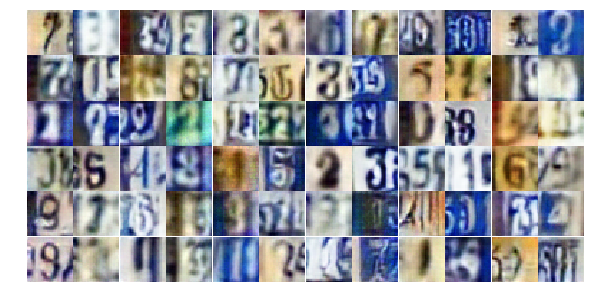

Epoch 19/25... Discriminator Loss: 0.8238... Generator Loss: 0.7894
Epoch 19/25... Discriminator Loss: 0.8986... Generator Loss: 0.7300
Epoch 19/25... Discriminator Loss: 0.7094... Generator Loss: 1.4416
Epoch 19/25... Discriminator Loss: 1.0863... Generator Loss: 0.5902
Epoch 19/25... Discriminator Loss: 0.8825... Generator Loss: 0.7732
Epoch 19/25... Discriminator Loss: 0.5737... Generator Loss: 1.4586
Epoch 19/25... Discriminator Loss: 1.5391... Generator Loss: 0.3421
Epoch 19/25... Discriminator Loss: 0.4444... Generator Loss: 1.6424
Epoch 20/25... Discriminator Loss: 0.9791... Generator Loss: 0.7046
Epoch 20/25... Discriminator Loss: 0.6973... Generator Loss: 1.0045


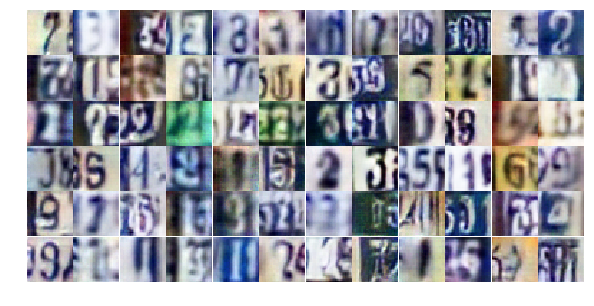

Epoch 20/25... Discriminator Loss: 0.4315... Generator Loss: 1.6096
Epoch 20/25... Discriminator Loss: 1.0761... Generator Loss: 0.5880
Epoch 20/25... Discriminator Loss: 1.2286... Generator Loss: 0.4963
Epoch 20/25... Discriminator Loss: 1.4050... Generator Loss: 0.3916
Epoch 20/25... Discriminator Loss: 0.5270... Generator Loss: 1.2375
Epoch 20/25... Discriminator Loss: 0.7714... Generator Loss: 0.8280
Epoch 20/25... Discriminator Loss: 0.7615... Generator Loss: 1.0107
Epoch 20/25... Discriminator Loss: 1.0625... Generator Loss: 0.6601
Epoch 20/25... Discriminator Loss: 1.1851... Generator Loss: 0.5588
Epoch 20/25... Discriminator Loss: 0.8254... Generator Loss: 0.7677


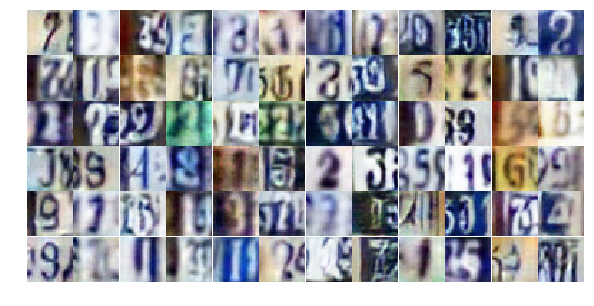

Epoch 20/25... Discriminator Loss: 1.3105... Generator Loss: 0.4979
Epoch 20/25... Discriminator Loss: 0.9272... Generator Loss: 0.7441
Epoch 20/25... Discriminator Loss: 0.7534... Generator Loss: 1.0617
Epoch 20/25... Discriminator Loss: 0.5852... Generator Loss: 1.2515
Epoch 20/25... Discriminator Loss: 0.8297... Generator Loss: 0.8539
Epoch 20/25... Discriminator Loss: 1.2047... Generator Loss: 0.5062
Epoch 20/25... Discriminator Loss: 1.8009... Generator Loss: 0.3364
Epoch 20/25... Discriminator Loss: 0.6973... Generator Loss: 1.3245
Epoch 20/25... Discriminator Loss: 0.7882... Generator Loss: 0.8668
Epoch 20/25... Discriminator Loss: 1.1698... Generator Loss: 0.5598


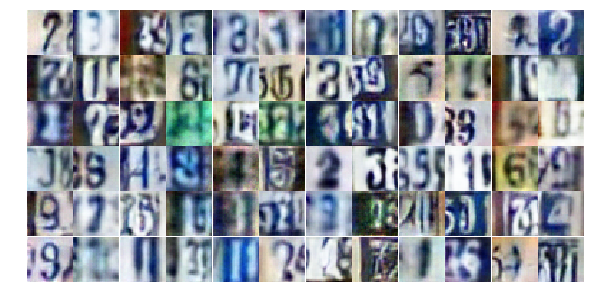

Epoch 20/25... Discriminator Loss: 0.7070... Generator Loss: 1.0057
Epoch 20/25... Discriminator Loss: 0.7437... Generator Loss: 1.0184
Epoch 20/25... Discriminator Loss: 0.3212... Generator Loss: 1.5934
Epoch 20/25... Discriminator Loss: 1.6140... Generator Loss: 0.3251
Epoch 20/25... Discriminator Loss: 1.2720... Generator Loss: 0.5175
Epoch 20/25... Discriminator Loss: 0.5257... Generator Loss: 2.3038
Epoch 20/25... Discriminator Loss: 0.5529... Generator Loss: 1.9670
Epoch 20/25... Discriminator Loss: 2.0314... Generator Loss: 0.2186
Epoch 20/25... Discriminator Loss: 0.8182... Generator Loss: 0.8367
Epoch 20/25... Discriminator Loss: 0.5687... Generator Loss: 1.1696


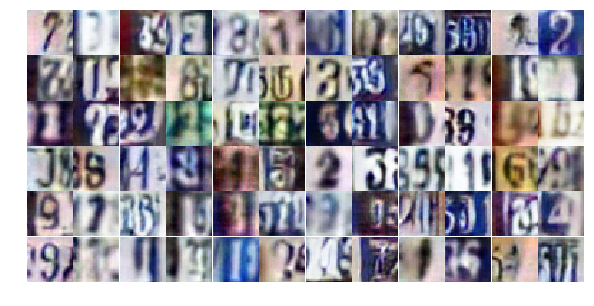

Epoch 20/25... Discriminator Loss: 0.7299... Generator Loss: 1.0428
Epoch 20/25... Discriminator Loss: 0.4542... Generator Loss: 1.3924
Epoch 20/25... Discriminator Loss: 0.7484... Generator Loss: 1.0952
Epoch 20/25... Discriminator Loss: 0.6597... Generator Loss: 1.6503
Epoch 20/25... Discriminator Loss: 1.2941... Generator Loss: 0.4801
Epoch 20/25... Discriminator Loss: 0.5003... Generator Loss: 1.6456
Epoch 20/25... Discriminator Loss: 0.7533... Generator Loss: 1.0700
Epoch 20/25... Discriminator Loss: 0.9388... Generator Loss: 0.8189
Epoch 20/25... Discriminator Loss: 0.6845... Generator Loss: 1.1011
Epoch 20/25... Discriminator Loss: 1.0281... Generator Loss: 0.6528


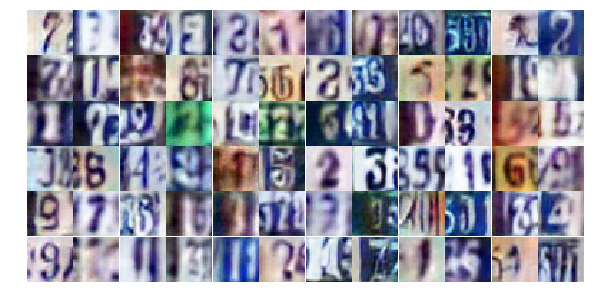

Epoch 20/25... Discriminator Loss: 0.9977... Generator Loss: 0.6805
Epoch 20/25... Discriminator Loss: 1.0386... Generator Loss: 0.6555
Epoch 20/25... Discriminator Loss: 0.5409... Generator Loss: 1.5981
Epoch 20/25... Discriminator Loss: 0.7884... Generator Loss: 0.8584
Epoch 20/25... Discriminator Loss: 0.6466... Generator Loss: 1.1102
Epoch 20/25... Discriminator Loss: 1.1029... Generator Loss: 0.5926
Epoch 20/25... Discriminator Loss: 1.0108... Generator Loss: 0.7001
Epoch 20/25... Discriminator Loss: 0.4362... Generator Loss: 1.4591
Epoch 20/25... Discriminator Loss: 0.7303... Generator Loss: 0.9291
Epoch 20/25... Discriminator Loss: 0.5794... Generator Loss: 1.1538


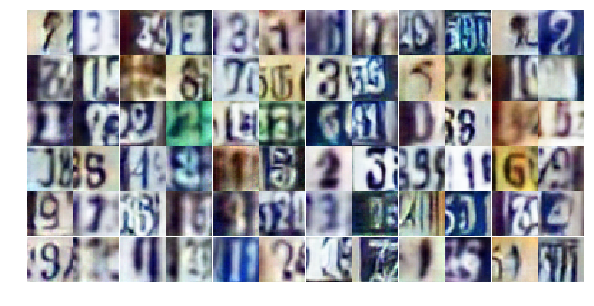

Epoch 20/25... Discriminator Loss: 0.5500... Generator Loss: 1.3328
Epoch 20/25... Discriminator Loss: 0.7670... Generator Loss: 2.9540
Epoch 20/25... Discriminator Loss: 0.4263... Generator Loss: 1.9195
Epoch 20/25... Discriminator Loss: 1.0906... Generator Loss: 0.7061
Epoch 20/25... Discriminator Loss: 0.7957... Generator Loss: 0.8683
Epoch 20/25... Discriminator Loss: 0.4649... Generator Loss: 1.5244
Epoch 21/25... Discriminator Loss: 0.9700... Generator Loss: 0.7037
Epoch 21/25... Discriminator Loss: 1.2147... Generator Loss: 0.5396
Epoch 21/25... Discriminator Loss: 1.0810... Generator Loss: 0.6473
Epoch 21/25... Discriminator Loss: 0.7854... Generator Loss: 0.9318


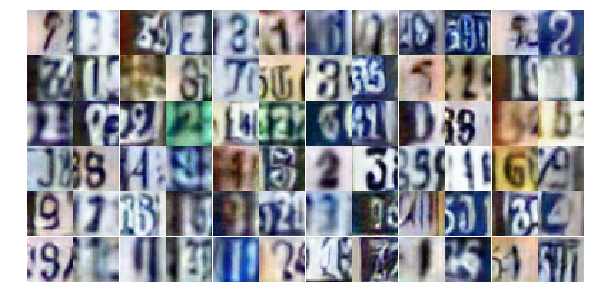

Epoch 21/25... Discriminator Loss: 0.5624... Generator Loss: 1.4466
Epoch 21/25... Discriminator Loss: 1.7234... Generator Loss: 0.4025
Epoch 21/25... Discriminator Loss: 0.5166... Generator Loss: 1.3813
Epoch 21/25... Discriminator Loss: 0.2986... Generator Loss: 2.1227
Epoch 21/25... Discriminator Loss: 0.9883... Generator Loss: 0.6908
Epoch 21/25... Discriminator Loss: 0.6461... Generator Loss: 1.0982
Epoch 21/25... Discriminator Loss: 0.6558... Generator Loss: 1.0135
Epoch 21/25... Discriminator Loss: 0.7528... Generator Loss: 1.3658
Epoch 21/25... Discriminator Loss: 0.8712... Generator Loss: 0.8092
Epoch 21/25... Discriminator Loss: 1.0632... Generator Loss: 0.5936


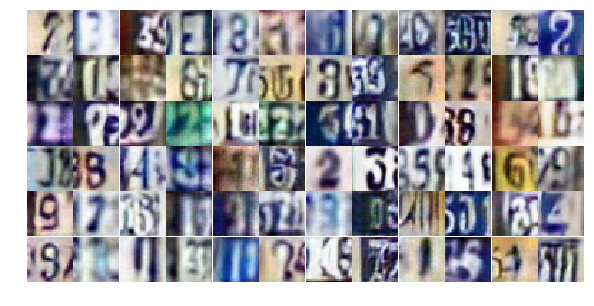

Epoch 21/25... Discriminator Loss: 0.3815... Generator Loss: 1.8909
Epoch 21/25... Discriminator Loss: 1.0224... Generator Loss: 0.6803
Epoch 21/25... Discriminator Loss: 1.9027... Generator Loss: 0.2825
Epoch 21/25... Discriminator Loss: 0.5374... Generator Loss: 1.4545
Epoch 21/25... Discriminator Loss: 0.7310... Generator Loss: 1.1354
Epoch 21/25... Discriminator Loss: 0.8893... Generator Loss: 0.8041
Epoch 21/25... Discriminator Loss: 1.1400... Generator Loss: 0.5899
Epoch 21/25... Discriminator Loss: 0.8452... Generator Loss: 0.8552
Epoch 21/25... Discriminator Loss: 0.4931... Generator Loss: 1.3937
Epoch 21/25... Discriminator Loss: 0.7541... Generator Loss: 0.9255


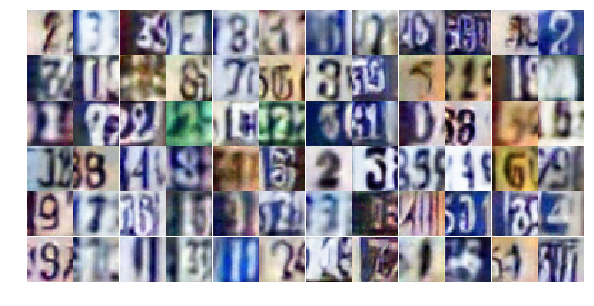

Epoch 21/25... Discriminator Loss: 1.2366... Generator Loss: 0.5424
Epoch 21/25... Discriminator Loss: 0.3344... Generator Loss: 1.8659
Epoch 21/25... Discriminator Loss: 0.9828... Generator Loss: 0.7254
Epoch 21/25... Discriminator Loss: 0.6359... Generator Loss: 1.2991
Epoch 21/25... Discriminator Loss: 1.0135... Generator Loss: 0.6711
Epoch 21/25... Discriminator Loss: 0.9384... Generator Loss: 0.9285
Epoch 21/25... Discriminator Loss: 0.5612... Generator Loss: 1.3057
Epoch 21/25... Discriminator Loss: 1.2239... Generator Loss: 0.5187
Epoch 21/25... Discriminator Loss: 0.9243... Generator Loss: 0.7332
Epoch 21/25... Discriminator Loss: 1.6298... Generator Loss: 0.3134


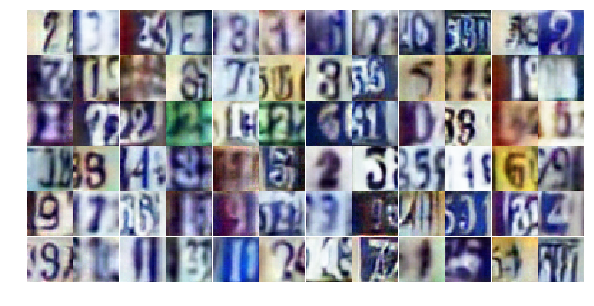

Epoch 21/25... Discriminator Loss: 1.3507... Generator Loss: 0.4301
Epoch 21/25... Discriminator Loss: 0.6718... Generator Loss: 0.9846
Epoch 21/25... Discriminator Loss: 1.0432... Generator Loss: 0.5928
Epoch 21/25... Discriminator Loss: 0.6416... Generator Loss: 1.0300
Epoch 21/25... Discriminator Loss: 0.7027... Generator Loss: 0.9760
Epoch 21/25... Discriminator Loss: 0.6919... Generator Loss: 1.3344
Epoch 21/25... Discriminator Loss: 0.9192... Generator Loss: 0.7299
Epoch 21/25... Discriminator Loss: 1.3902... Generator Loss: 0.5179
Epoch 21/25... Discriminator Loss: 0.7070... Generator Loss: 0.9811
Epoch 21/25... Discriminator Loss: 0.7671... Generator Loss: 1.0562


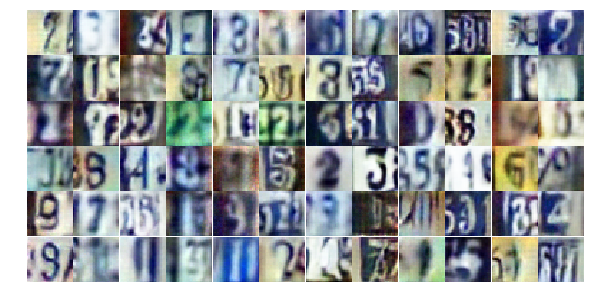

Epoch 21/25... Discriminator Loss: 1.0249... Generator Loss: 0.6794
Epoch 21/25... Discriminator Loss: 1.3221... Generator Loss: 0.4645
Epoch 21/25... Discriminator Loss: 0.6598... Generator Loss: 1.0265
Epoch 21/25... Discriminator Loss: 0.8016... Generator Loss: 0.9424
Epoch 21/25... Discriminator Loss: 0.3442... Generator Loss: 1.9154
Epoch 21/25... Discriminator Loss: 0.9353... Generator Loss: 0.6916
Epoch 21/25... Discriminator Loss: 1.2776... Generator Loss: 0.4997
Epoch 21/25... Discriminator Loss: 0.8555... Generator Loss: 0.8493
Epoch 21/25... Discriminator Loss: 1.0727... Generator Loss: 0.6428
Epoch 21/25... Discriminator Loss: 0.4661... Generator Loss: 1.4338


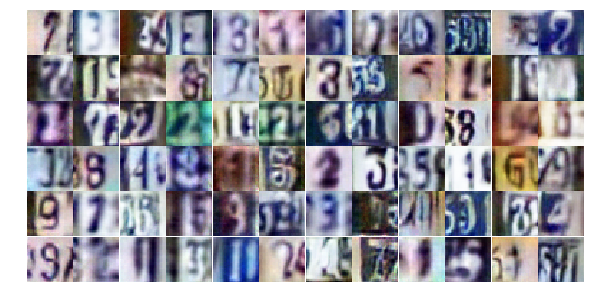

Epoch 21/25... Discriminator Loss: 0.4430... Generator Loss: 1.4741
Epoch 21/25... Discriminator Loss: 0.7718... Generator Loss: 1.4942
Epoch 21/25... Discriminator Loss: 1.4572... Generator Loss: 0.4078
Epoch 22/25... Discriminator Loss: 1.1248... Generator Loss: 0.7772
Epoch 22/25... Discriminator Loss: 0.9013... Generator Loss: 0.7487
Epoch 22/25... Discriminator Loss: 1.2617... Generator Loss: 0.5418
Epoch 22/25... Discriminator Loss: 0.4048... Generator Loss: 1.6986
Epoch 22/25... Discriminator Loss: 0.5183... Generator Loss: 1.2655
Epoch 22/25... Discriminator Loss: 1.3704... Generator Loss: 0.4209
Epoch 22/25... Discriminator Loss: 1.7116... Generator Loss: 4.5676


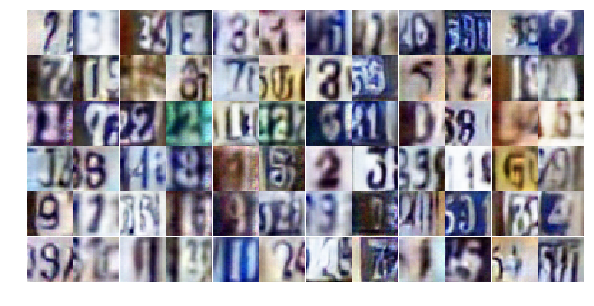

Epoch 22/25... Discriminator Loss: 2.8416... Generator Loss: 3.5778
Epoch 22/25... Discriminator Loss: 0.8912... Generator Loss: 1.0231
Epoch 22/25... Discriminator Loss: 1.1330... Generator Loss: 0.6990
Epoch 22/25... Discriminator Loss: 0.8712... Generator Loss: 0.8381
Epoch 22/25... Discriminator Loss: 1.0140... Generator Loss: 0.7266
Epoch 22/25... Discriminator Loss: 0.7054... Generator Loss: 1.0947
Epoch 22/25... Discriminator Loss: 0.8354... Generator Loss: 0.8639
Epoch 22/25... Discriminator Loss: 0.5247... Generator Loss: 1.3503
Epoch 22/25... Discriminator Loss: 0.8842... Generator Loss: 0.8379
Epoch 22/25... Discriminator Loss: 1.8049... Generator Loss: 0.3033


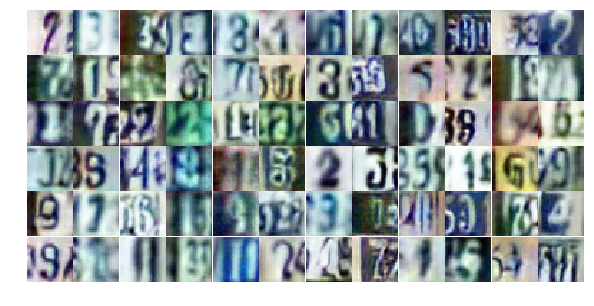

Epoch 22/25... Discriminator Loss: 0.4232... Generator Loss: 1.6856
Epoch 22/25... Discriminator Loss: 0.5942... Generator Loss: 1.1511
Epoch 22/25... Discriminator Loss: 1.2000... Generator Loss: 0.4990
Epoch 22/25... Discriminator Loss: 0.4158... Generator Loss: 1.6302
Epoch 22/25... Discriminator Loss: 0.5506... Generator Loss: 1.2393
Epoch 22/25... Discriminator Loss: 0.8948... Generator Loss: 0.8805
Epoch 22/25... Discriminator Loss: 0.3832... Generator Loss: 1.6631
Epoch 22/25... Discriminator Loss: 0.4777... Generator Loss: 1.3890
Epoch 22/25... Discriminator Loss: 0.5599... Generator Loss: 1.1612
Epoch 22/25... Discriminator Loss: 0.8042... Generator Loss: 1.1714


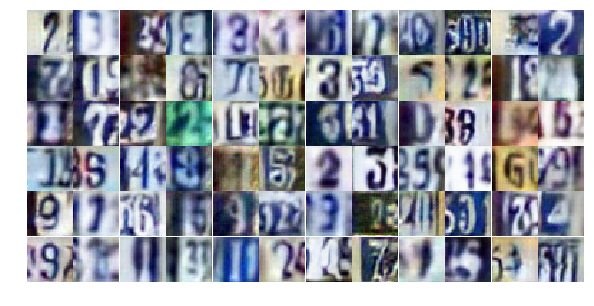

Epoch 22/25... Discriminator Loss: 0.4400... Generator Loss: 1.4644
Epoch 22/25... Discriminator Loss: 0.5619... Generator Loss: 1.2015
Epoch 22/25... Discriminator Loss: 0.7064... Generator Loss: 0.9488
Epoch 22/25... Discriminator Loss: 1.4508... Generator Loss: 0.4423
Epoch 22/25... Discriminator Loss: 0.8497... Generator Loss: 0.7964
Epoch 22/25... Discriminator Loss: 0.7799... Generator Loss: 0.8929
Epoch 22/25... Discriminator Loss: 1.4437... Generator Loss: 0.3971
Epoch 22/25... Discriminator Loss: 0.5562... Generator Loss: 1.4374
Epoch 22/25... Discriminator Loss: 0.8171... Generator Loss: 0.8687
Epoch 22/25... Discriminator Loss: 1.4294... Generator Loss: 0.4161


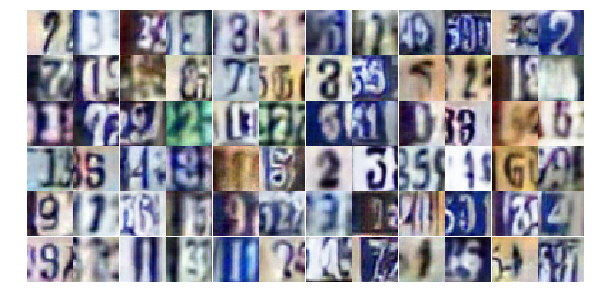

Epoch 22/25... Discriminator Loss: 0.9536... Generator Loss: 0.7173
Epoch 22/25... Discriminator Loss: 0.5126... Generator Loss: 1.3003
Epoch 22/25... Discriminator Loss: 0.3470... Generator Loss: 1.8009
Epoch 22/25... Discriminator Loss: 0.6831... Generator Loss: 0.9664
Epoch 22/25... Discriminator Loss: 0.7359... Generator Loss: 0.9793
Epoch 22/25... Discriminator Loss: 0.3499... Generator Loss: 1.7416
Epoch 22/25... Discriminator Loss: 0.6614... Generator Loss: 1.0076
Epoch 22/25... Discriminator Loss: 1.0708... Generator Loss: 0.5975
Epoch 22/25... Discriminator Loss: 0.9895... Generator Loss: 0.7478
Epoch 22/25... Discriminator Loss: 1.1697... Generator Loss: 0.6287


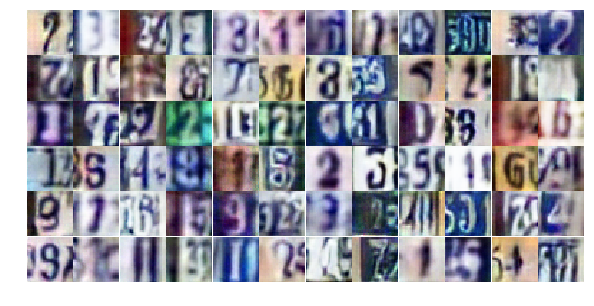

Epoch 22/25... Discriminator Loss: 1.3003... Generator Loss: 0.5193
Epoch 22/25... Discriminator Loss: 0.5151... Generator Loss: 1.4685
Epoch 22/25... Discriminator Loss: 0.9731... Generator Loss: 0.6912
Epoch 22/25... Discriminator Loss: 0.9317... Generator Loss: 0.8610
Epoch 22/25... Discriminator Loss: 0.6584... Generator Loss: 1.0298
Epoch 22/25... Discriminator Loss: 0.7473... Generator Loss: 0.9568
Epoch 22/25... Discriminator Loss: 1.3480... Generator Loss: 0.4510
Epoch 22/25... Discriminator Loss: 0.4323... Generator Loss: 1.4946
Epoch 22/25... Discriminator Loss: 1.6028... Generator Loss: 3.6432
Epoch 22/25... Discriminator Loss: 1.1882... Generator Loss: 0.5614


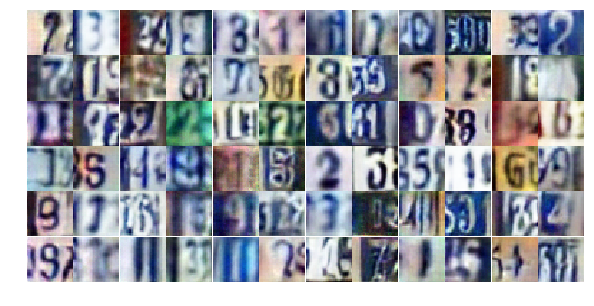

Epoch 23/25... Discriminator Loss: 0.4925... Generator Loss: 1.5941
Epoch 23/25... Discriminator Loss: 0.6118... Generator Loss: 1.0134
Epoch 23/25... Discriminator Loss: 0.8010... Generator Loss: 0.8119
Epoch 23/25... Discriminator Loss: 0.4823... Generator Loss: 1.3962
Epoch 23/25... Discriminator Loss: 0.7478... Generator Loss: 0.9620
Epoch 23/25... Discriminator Loss: 1.2586... Generator Loss: 0.5414
Epoch 23/25... Discriminator Loss: 0.8698... Generator Loss: 0.8785
Epoch 23/25... Discriminator Loss: 0.6850... Generator Loss: 1.0429
Epoch 23/25... Discriminator Loss: 0.6338... Generator Loss: 1.1145
Epoch 23/25... Discriminator Loss: 0.3751... Generator Loss: 1.6503


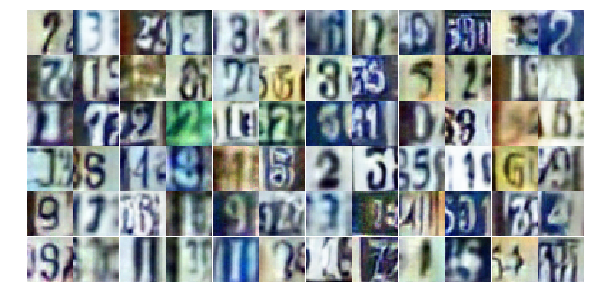

Epoch 23/25... Discriminator Loss: 0.6487... Generator Loss: 1.0213
Epoch 23/25... Discriminator Loss: 0.6511... Generator Loss: 1.0075
Epoch 23/25... Discriminator Loss: 1.0147... Generator Loss: 1.9357
Epoch 23/25... Discriminator Loss: 0.7354... Generator Loss: 1.2762
Epoch 23/25... Discriminator Loss: 0.3644... Generator Loss: 2.0934
Epoch 23/25... Discriminator Loss: 1.0115... Generator Loss: 0.6759
Epoch 23/25... Discriminator Loss: 1.0129... Generator Loss: 0.6609
Epoch 23/25... Discriminator Loss: 0.9669... Generator Loss: 0.6994
Epoch 23/25... Discriminator Loss: 0.8768... Generator Loss: 0.8054
Epoch 23/25... Discriminator Loss: 1.1346... Generator Loss: 0.6096


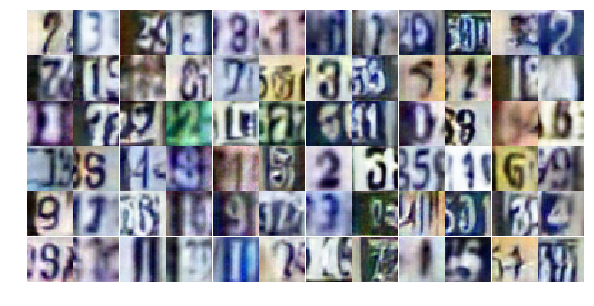

Epoch 23/25... Discriminator Loss: 1.1686... Generator Loss: 0.5390
Epoch 23/25... Discriminator Loss: 0.4720... Generator Loss: 1.5071
Epoch 23/25... Discriminator Loss: 1.0496... Generator Loss: 0.6229
Epoch 23/25... Discriminator Loss: 0.6630... Generator Loss: 1.0927
Epoch 23/25... Discriminator Loss: 0.4029... Generator Loss: 1.6314
Epoch 23/25... Discriminator Loss: 0.8530... Generator Loss: 0.8613
Epoch 23/25... Discriminator Loss: 0.8068... Generator Loss: 0.8526
Epoch 23/25... Discriminator Loss: 0.8225... Generator Loss: 0.8490
Epoch 23/25... Discriminator Loss: 0.8062... Generator Loss: 0.9264
Epoch 23/25... Discriminator Loss: 0.8068... Generator Loss: 0.8071


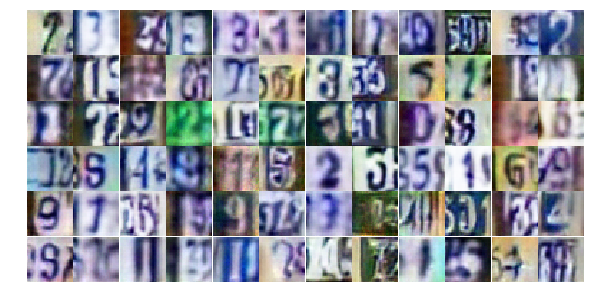

Epoch 23/25... Discriminator Loss: 0.6456... Generator Loss: 0.9465
Epoch 23/25... Discriminator Loss: 0.6370... Generator Loss: 1.0437
Epoch 23/25... Discriminator Loss: 0.7606... Generator Loss: 0.9310
Epoch 23/25... Discriminator Loss: 0.9386... Generator Loss: 0.6948
Epoch 23/25... Discriminator Loss: 0.9197... Generator Loss: 0.8000
Epoch 23/25... Discriminator Loss: 1.3011... Generator Loss: 0.4971
Epoch 23/25... Discriminator Loss: 1.3966... Generator Loss: 0.4469
Epoch 23/25... Discriminator Loss: 0.6227... Generator Loss: 1.1955
Epoch 23/25... Discriminator Loss: 0.4972... Generator Loss: 1.4642
Epoch 23/25... Discriminator Loss: 0.6436... Generator Loss: 1.0122


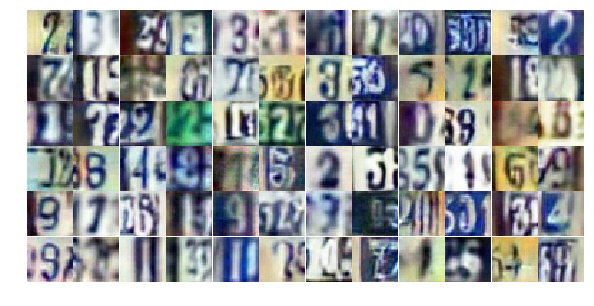

Epoch 23/25... Discriminator Loss: 0.8437... Generator Loss: 0.8461
Epoch 23/25... Discriminator Loss: 0.7197... Generator Loss: 0.9213
Epoch 23/25... Discriminator Loss: 1.1373... Generator Loss: 0.5699
Epoch 23/25... Discriminator Loss: 1.1177... Generator Loss: 3.0073
Epoch 23/25... Discriminator Loss: 0.9585... Generator Loss: 0.7621
Epoch 23/25... Discriminator Loss: 1.0599... Generator Loss: 0.7096
Epoch 23/25... Discriminator Loss: 0.8203... Generator Loss: 0.7921
Epoch 23/25... Discriminator Loss: 1.1941... Generator Loss: 0.6380
Epoch 23/25... Discriminator Loss: 0.7809... Generator Loss: 0.9130
Epoch 23/25... Discriminator Loss: 0.9197... Generator Loss: 0.7909


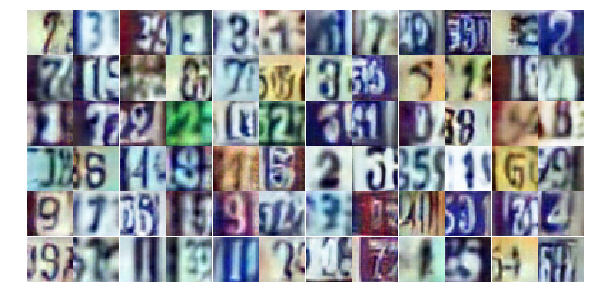

Epoch 23/25... Discriminator Loss: 0.5692... Generator Loss: 1.2402
Epoch 23/25... Discriminator Loss: 1.2717... Generator Loss: 0.5113
Epoch 23/25... Discriminator Loss: 1.0316... Generator Loss: 0.6231
Epoch 23/25... Discriminator Loss: 0.3818... Generator Loss: 1.6507
Epoch 23/25... Discriminator Loss: 1.5727... Generator Loss: 0.4247
Epoch 23/25... Discriminator Loss: 1.0823... Generator Loss: 0.5975
Epoch 23/25... Discriminator Loss: 0.9123... Generator Loss: 0.7485
Epoch 24/25... Discriminator Loss: 0.7797... Generator Loss: 0.9031
Epoch 24/25... Discriminator Loss: 0.7454... Generator Loss: 0.9670
Epoch 24/25... Discriminator Loss: 0.9514... Generator Loss: 0.8132


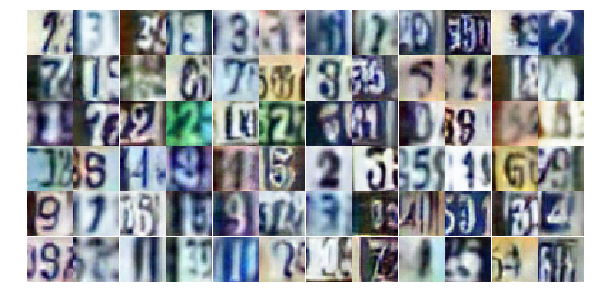

Epoch 24/25... Discriminator Loss: 0.5188... Generator Loss: 2.9547
Epoch 24/25... Discriminator Loss: 0.3879... Generator Loss: 2.2155
Epoch 24/25... Discriminator Loss: 0.7033... Generator Loss: 0.9496
Epoch 24/25... Discriminator Loss: 0.9089... Generator Loss: 1.1881
Epoch 24/25... Discriminator Loss: 0.9119... Generator Loss: 0.7300
Epoch 24/25... Discriminator Loss: 0.7082... Generator Loss: 1.0274
Epoch 24/25... Discriminator Loss: 0.7996... Generator Loss: 0.8585
Epoch 24/25... Discriminator Loss: 1.0311... Generator Loss: 0.6215
Epoch 24/25... Discriminator Loss: 0.3881... Generator Loss: 1.7281
Epoch 24/25... Discriminator Loss: 0.3798... Generator Loss: 1.6705


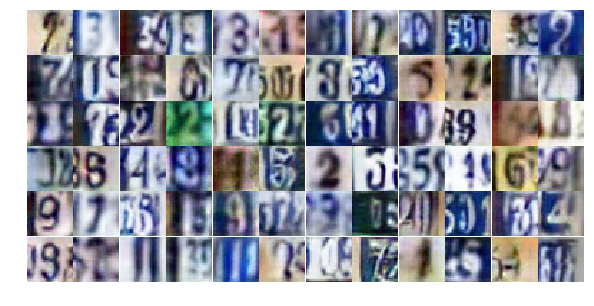

Epoch 24/25... Discriminator Loss: 1.6413... Generator Loss: 0.3334
Epoch 24/25... Discriminator Loss: 1.2235... Generator Loss: 0.5369
Epoch 24/25... Discriminator Loss: 0.9196... Generator Loss: 0.7681
Epoch 24/25... Discriminator Loss: 0.5063... Generator Loss: 1.1897
Epoch 24/25... Discriminator Loss: 1.3647... Generator Loss: 2.8259
Epoch 24/25... Discriminator Loss: 1.0033... Generator Loss: 1.9914
Epoch 24/25... Discriminator Loss: 1.1972... Generator Loss: 0.5964
Epoch 24/25... Discriminator Loss: 0.9530... Generator Loss: 0.7250
Epoch 24/25... Discriminator Loss: 0.7691... Generator Loss: 1.9121
Epoch 24/25... Discriminator Loss: 0.7530... Generator Loss: 0.9525


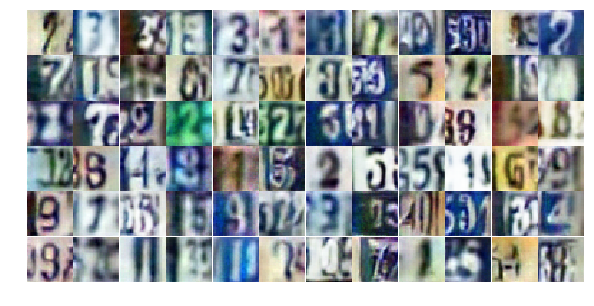

Epoch 24/25... Discriminator Loss: 0.7980... Generator Loss: 0.9217
Epoch 24/25... Discriminator Loss: 0.6838... Generator Loss: 1.2460
Epoch 24/25... Discriminator Loss: 0.8714... Generator Loss: 0.8921
Epoch 24/25... Discriminator Loss: 1.6374... Generator Loss: 0.3357
Epoch 24/25... Discriminator Loss: 0.5596... Generator Loss: 1.2506
Epoch 24/25... Discriminator Loss: 0.4287... Generator Loss: 1.5781
Epoch 24/25... Discriminator Loss: 0.5801... Generator Loss: 1.1213
Epoch 24/25... Discriminator Loss: 0.6539... Generator Loss: 1.0958
Epoch 24/25... Discriminator Loss: 0.5992... Generator Loss: 1.1493
Epoch 24/25... Discriminator Loss: 0.8185... Generator Loss: 0.9221


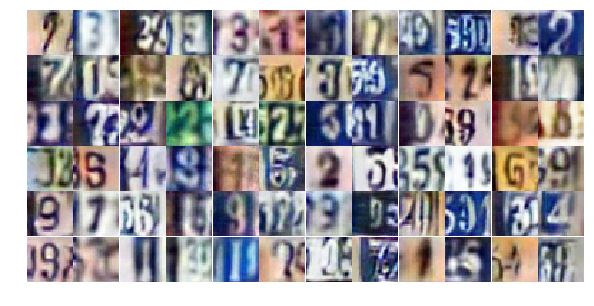

Epoch 24/25... Discriminator Loss: 0.5387... Generator Loss: 1.2845
Epoch 24/25... Discriminator Loss: 0.5816... Generator Loss: 1.1300
Epoch 24/25... Discriminator Loss: 1.0386... Generator Loss: 0.6690
Epoch 24/25... Discriminator Loss: 1.8785... Generator Loss: 0.3420
Epoch 24/25... Discriminator Loss: 1.1574... Generator Loss: 2.1478
Epoch 24/25... Discriminator Loss: 1.2696... Generator Loss: 0.4502
Epoch 24/25... Discriminator Loss: 0.8530... Generator Loss: 0.8206
Epoch 24/25... Discriminator Loss: 0.6109... Generator Loss: 1.1846
Epoch 24/25... Discriminator Loss: 0.9279... Generator Loss: 0.7959
Epoch 24/25... Discriminator Loss: 0.5302... Generator Loss: 1.6341


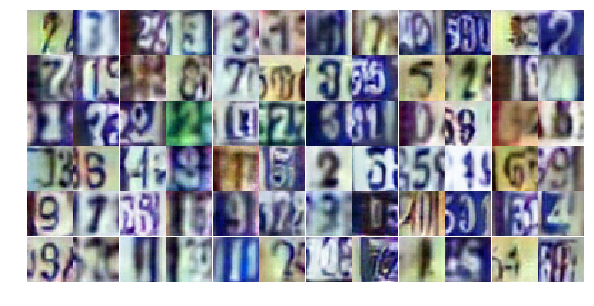

Epoch 24/25... Discriminator Loss: 0.8161... Generator Loss: 0.8108
Epoch 24/25... Discriminator Loss: 1.2876... Generator Loss: 0.4758
Epoch 24/25... Discriminator Loss: 1.6200... Generator Loss: 0.3734
Epoch 24/25... Discriminator Loss: 0.9102... Generator Loss: 0.9139
Epoch 24/25... Discriminator Loss: 1.6035... Generator Loss: 0.3177
Epoch 24/25... Discriminator Loss: 0.5232... Generator Loss: 1.3526
Epoch 24/25... Discriminator Loss: 0.9732... Generator Loss: 0.6819
Epoch 24/25... Discriminator Loss: 0.7332... Generator Loss: 0.9641
Epoch 24/25... Discriminator Loss: 0.6308... Generator Loss: 1.1155
Epoch 24/25... Discriminator Loss: 1.0213... Generator Loss: 0.6449


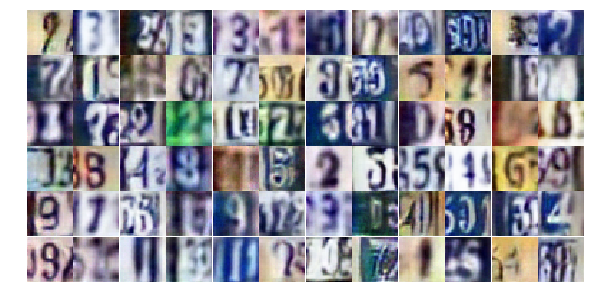

Epoch 24/25... Discriminator Loss: 1.3188... Generator Loss: 0.4884
Epoch 24/25... Discriminator Loss: 1.5162... Generator Loss: 0.3660
Epoch 24/25... Discriminator Loss: 1.9552... Generator Loss: 0.2457
Epoch 24/25... Discriminator Loss: 0.9486... Generator Loss: 2.3538
Epoch 24/25... Discriminator Loss: 1.0835... Generator Loss: 0.6525
Epoch 25/25... Discriminator Loss: 0.9684... Generator Loss: 0.6483
Epoch 25/25... Discriminator Loss: 0.4104... Generator Loss: 1.6601
Epoch 25/25... Discriminator Loss: 0.7645... Generator Loss: 0.9216
Epoch 25/25... Discriminator Loss: 0.8425... Generator Loss: 0.9445
Epoch 25/25... Discriminator Loss: 1.3979... Generator Loss: 0.4122


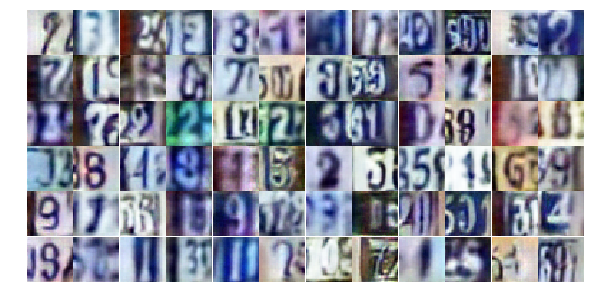

Epoch 25/25... Discriminator Loss: 1.3168... Generator Loss: 0.4427
Epoch 25/25... Discriminator Loss: 1.4556... Generator Loss: 0.4190
Epoch 25/25... Discriminator Loss: 0.5917... Generator Loss: 1.1786
Epoch 25/25... Discriminator Loss: 0.7085... Generator Loss: 1.0642
Epoch 25/25... Discriminator Loss: 0.8957... Generator Loss: 2.3266
Epoch 25/25... Discriminator Loss: 0.5792... Generator Loss: 1.8344
Epoch 25/25... Discriminator Loss: 0.7064... Generator Loss: 1.6457
Epoch 25/25... Discriminator Loss: 0.7965... Generator Loss: 1.1564
Epoch 25/25... Discriminator Loss: 0.6093... Generator Loss: 1.0729
Epoch 25/25... Discriminator Loss: 0.7623... Generator Loss: 0.9228


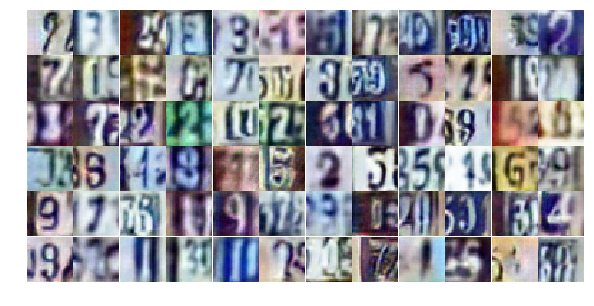

Epoch 25/25... Discriminator Loss: 0.9643... Generator Loss: 0.7202
Epoch 25/25... Discriminator Loss: 0.5453... Generator Loss: 2.4331
Epoch 25/25... Discriminator Loss: 1.0490... Generator Loss: 0.7497
Epoch 25/25... Discriminator Loss: 0.9108... Generator Loss: 0.7335
Epoch 25/25... Discriminator Loss: 0.5648... Generator Loss: 1.2703
Epoch 25/25... Discriminator Loss: 0.4464... Generator Loss: 1.6786
Epoch 25/25... Discriminator Loss: 1.6345... Generator Loss: 0.3474
Epoch 25/25... Discriminator Loss: 1.2977... Generator Loss: 0.6170
Epoch 25/25... Discriminator Loss: 0.5670... Generator Loss: 1.4089
Epoch 25/25... Discriminator Loss: 0.6369... Generator Loss: 1.2063


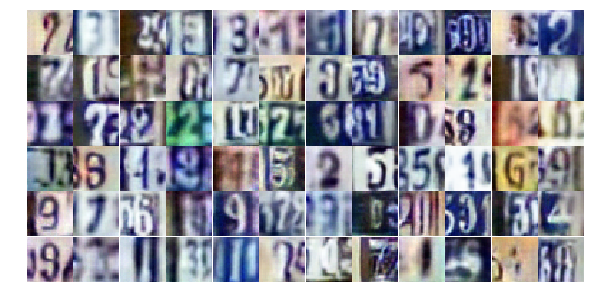

Epoch 25/25... Discriminator Loss: 0.4359... Generator Loss: 1.5037
Epoch 25/25... Discriminator Loss: 0.8866... Generator Loss: 0.7455
Epoch 25/25... Discriminator Loss: 1.5471... Generator Loss: 0.4626
Epoch 25/25... Discriminator Loss: 0.6486... Generator Loss: 1.1123
Epoch 25/25... Discriminator Loss: 0.8784... Generator Loss: 0.8885
Epoch 25/25... Discriminator Loss: 0.4616... Generator Loss: 1.4515
Epoch 25/25... Discriminator Loss: 0.6204... Generator Loss: 1.1635
Epoch 25/25... Discriminator Loss: 1.0238... Generator Loss: 0.7138
Epoch 25/25... Discriminator Loss: 0.6974... Generator Loss: 1.3279
Epoch 25/25... Discriminator Loss: 0.4089... Generator Loss: 2.0748


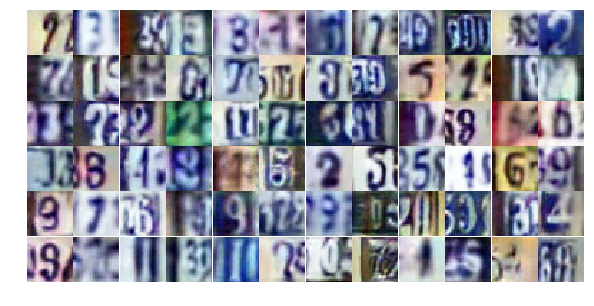

Epoch 25/25... Discriminator Loss: 0.7629... Generator Loss: 0.9464
Epoch 25/25... Discriminator Loss: 0.5584... Generator Loss: 1.2300
Epoch 25/25... Discriminator Loss: 0.8130... Generator Loss: 0.8929
Epoch 25/25... Discriminator Loss: 0.5967... Generator Loss: 1.1059
Epoch 25/25... Discriminator Loss: 0.8308... Generator Loss: 0.8752
Epoch 25/25... Discriminator Loss: 0.7239... Generator Loss: 0.9596
Epoch 25/25... Discriminator Loss: 0.4260... Generator Loss: 1.6396
Epoch 25/25... Discriminator Loss: 0.5678... Generator Loss: 1.1468
Epoch 25/25... Discriminator Loss: 1.8606... Generator Loss: 0.3458
Epoch 25/25... Discriminator Loss: 0.5368... Generator Loss: 1.2162


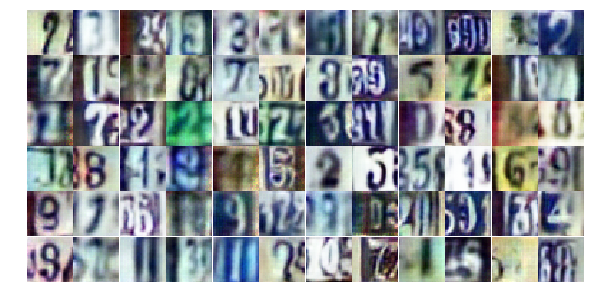

Epoch 25/25... Discriminator Loss: 0.6346... Generator Loss: 1.2512
Epoch 25/25... Discriminator Loss: 1.1146... Generator Loss: 0.5569
Epoch 25/25... Discriminator Loss: 0.7905... Generator Loss: 1.1177
Epoch 25/25... Discriminator Loss: 0.9798... Generator Loss: 0.6943
Epoch 25/25... Discriminator Loss: 0.7695... Generator Loss: 1.0231
Epoch 25/25... Discriminator Loss: 0.5343... Generator Loss: 1.3051
Epoch 25/25... Discriminator Loss: 1.5351... Generator Loss: 0.3909
Epoch 25/25... Discriminator Loss: 0.6936... Generator Loss: 1.0387
Epoch 25/25... Discriminator Loss: 0.7391... Generator Loss: 0.9919
Epoch 25/25... Discriminator Loss: 0.9983... Generator Loss: 0.7022


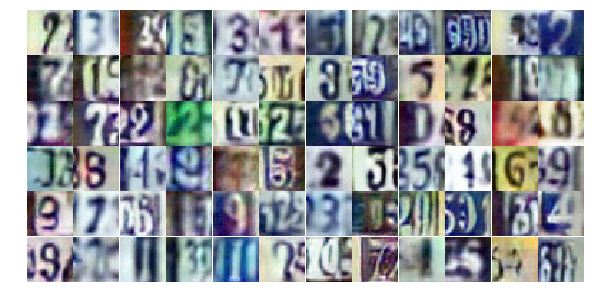

Epoch 25/25... Discriminator Loss: 0.5403... Generator Loss: 1.2668
Epoch 25/25... Discriminator Loss: 0.8946... Generator Loss: 1.3541


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

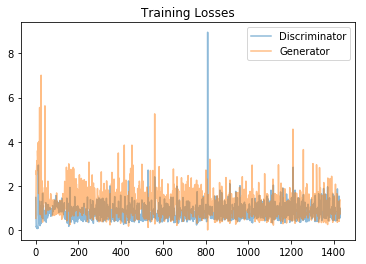

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

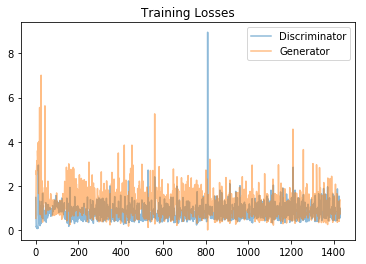

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/home/nitsuga/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


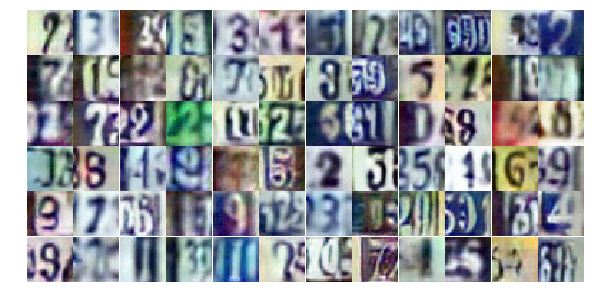

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

/home/nitsuga/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


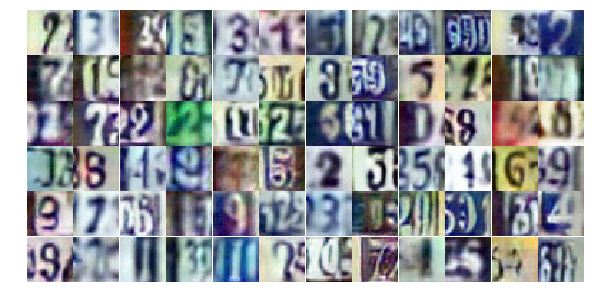

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))